<a href="https://colab.research.google.com/github/jatin3308/ja/blob/master/Music_Generation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<table align="center">
  <td align="center"><a target="_blank" href="http://introtodeeplearning.com">
        <img src="https://i.ibb.co/Jr88sn2/mit.png" style="padding-bottom:5px;" />
      Visit MIT Deep Learning</a></td>
  <td align="center"><a target="_blank" href="https://colab.research.google.com/github/aamini/introtodeeplearning/blob/2023/lab1/Part2_Music_Generation.ipynb">
        <img src="https://i.ibb.co/2P3SLwK/colab.png"  style="padding-bottom:5px;" />Run in Google Colab</a></td>
  <td align="center"><a target="_blank" href="https://github.com/aamini/introtodeeplearning/blob/2023/lab1/Part2_Music_Generation.ipynb">
        <img src="https://i.ibb.co/xfJbPmL/github.png"  height="70px" style="padding-bottom:5px;"  />View Source on GitHub</a></td>
</table>

# Copyright Information

In [ ]:
# Copyright 2023 MIT Introduction to Deep Learning. All Rights Reserved.
#
# Licensed under the MIT License. You may not use this file except in compliance
# with the License. Use and/or modification of this code outside of MIT Introduction
# to Deep Learning must reference:
#
# © MIT Introduction to Deep Learning
# http://introtodeeplearning.com
#

# Lab 1: Intro to TensorFlow and Music Generation with RNNs

# Part 2: Music Generation with RNNs

In this portion of the lab, we will explore building a Recurrent Neural Network (RNN) for music generation. We will train a model to learn the patterns in raw sheet music in [ABC notation](https://en.wikipedia.org/wiki/ABC_notation) and then use this model to generate new music.

## 2.1 Dependencies
First, let's download the course repository, install dependencies, and import the relevant packages we'll need for this lab.

In [1]:
# Import Tensorflow 2.0
%tensorflow_version 2.x
import tensorflow as tf

# Download and import the MIT Introduction to Deep Learning package
!pip install mitdeeplearning
import mitdeeplearning as mdl

# Import all remaining packages
import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
!apt-get install abcmidi timidity > /dev/null 2>&1

# Check that we are using a GPU, if not switch runtimes
#   using Runtime > Change Runtime Type > GPU
assert len(tf.config.list_physical_devices('GPU')) > 0

Colab only includes TensorFlow 2.x; %tensorflow_version has no effect.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 45.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for mitdeeplearning: filename=mitdeeplearning-0.3.0-py3-none-any.whl size=2117305 sha256=c106e7542d371553cced19c5cae6628302342a4aba2de73227e82855f8c35d6d
  Stored in directory: /root/.cache/pip/wheels/9c/9f/b5/0e31f83bc60a83625e37429f923934e26802d0d68cf3ef3216
Successfully built mitdeeplearning


## 2.2 Dataset

![Let's Dance!](http://33.media.tumblr.com/3d223954ad0a77f4e98a7b87136aa395/tumblr_nlct5lFVbF1qhu7oio1_500.gif)

We've gathered a dataset of thousands of Irish folk songs, represented in the ABC notation. Let's download the dataset and inspect it:


In [2]:
# Download the dataset
songs = mdl.lab1.load_training_data()

# Print one of the songs to inspect it in greater detail!
example_song = songs[0]
print("\nExample song: ")
print(example_song)

Found 817 songs in text

Example song: 
X:1
T:Alexander's
Z: id:dc-hornpipe-1
M:C|
L:1/8
K:D Major
(3ABc|dAFA DFAd|fdcd FAdf|gfge fefd|(3efe (3dcB A2 (3ABc|!
dAFA DFAd|fdcd FAdf|gfge fefd|(3efe dc d2:|!
AG|FAdA FAdA|GBdB GBdB|Acec Acec|dfaf gecA|!
FAdA FAdA|GBdB GBdB|Aceg fefd|(3efe dc d2:|!


We can easily convert a song in ABC notation to an audio waveform and play it back. Be patient for this conversion to run, it can take some time.

In [ ]:
# Convert the ABC notation to audio file and listen to it
mdl.lab1.play_song(example_song)

One important thing to think about is that this notation of music does not simply contain information on the notes being played, but additionally there is meta information such as the song title, key, and tempo. How does the number of different characters that are present in the text file impact the complexity of the learning problem? This will become important soon, when we generate a numerical representation for the text data.

In [3]:
# Join our list of song strings into a single string containing all songs
songs_joined = "\n\n".join(songs)

# Find all unique characters in the joined string
vocab = sorted(set(songs_joined))
print("There are", len(vocab), "unique characters in the dataset")

There are 83 unique characters in the dataset


## 2.3 Process the dataset for the learning task

Let's take a step back and consider our prediction task. We're trying to train a RNN model to learn patterns in ABC music, and then use this model to generate (i.e., predict) a new piece of music based on this learned information.

Breaking this down, what we're really asking the model is: given a character, or a sequence of characters, what is the most probable next character? We'll train the model to perform this task.

To achieve this, we will input a sequence of characters to the model, and train the model to predict the output, that is, the following character at each time step. RNNs maintain an internal state that depends on previously seen elements, so information about all characters seen up until a given moment will be taken into account in generating the prediction.

### Vectorize the text

Before we begin training our RNN model, we'll need to create a numerical representation of our text-based dataset. To do this, we'll generate two lookup tables: one that maps characters to numbers, and a second that maps numbers back to characters. Recall that we just identified the unique characters present in the text.

In [4]:
### Define numerical representation of text ###

# Create a mapping from character to unique index.
# For example, to get the index of the character "d",
#   we can evaluate `char2idx["d"]`.
char2idx = {u:i for i, u in enumerate(vocab)}

# Create a mapping from indices to characters. This is
#   the inverse of char2idx and allows us to convert back
#   from unique index to the character in our vocabulary.
idx2char = np.array(vocab)

This gives us an integer representation for each character. Observe that the unique characters (i.e., our vocabulary) in the text are mapped as indices from 0 to `len(unique)`. Let's take a peek at this numerical representation of our dataset:

In [5]:
print('{')
for char,_ in zip(char2idx, range(20)):
    print('  {:4s}: {:3d},'.format(repr(char), char2idx[char]))
print('  ...\n}')

{
  '\n':   0,
  ' ' :   1,
  '!' :   2,
  '"' :   3,
  '#' :   4,
  "'" :   5,
  '(' :   6,
  ')' :   7,
  ',' :   8,
  '-' :   9,
  '.' :  10,
  '/' :  11,
  '0' :  12,
  '1' :  13,
  '2' :  14,
  '3' :  15,
  '4' :  16,
  '5' :  17,
  '6' :  18,
  '7' :  19,
  ...
}


In [6]:
### Vectorize the songs string ###

'''TODO: Write a function to convert the all songs string to a vectorized
    (i.e., numeric) representation. Use the appropriate mapping
    above to convert from vocab characters to the corresponding indices.

  NOTE: the output of the `vectorize_string` function
  should be a np.array with `N` elements, where `N` is
  the number of characters in the input string
'''

def vectorize_string(string):
  return np.array([char2idx[char] for char in string])

vectorized_songs = vectorize_string(songs_joined)

We can also look at how the first part of the text is mapped to an integer representation:

In [7]:
print ('{} ---- characters mapped to int ----> {}'.format(repr(songs_joined[:10]), vectorized_songs[:10]))
# check that vectorized_songs is a numpy array
assert isinstance(vectorized_songs, np.ndarray), "returned result should be a numpy array"

'X:1\nT:Alex' ---- characters mapped to int ----> [49 22 13  0 45 22 26 67 60 79]


### Create training examples and targets

Our next step is to actually divide the text into example sequences that we'll use during training. Each input sequence that we feed into our RNN will contain `seq_length` characters from the text. We'll also need to define a target sequence for each input sequence, which will be used in training the RNN to predict the next character. For each input, the corresponding target will contain the same length of text, except shifted one character to the right.

To do this, we'll break the text into chunks of `seq_length+1`. Suppose `seq_length` is 4 and our text is "Hello". Then, our input sequence is "Hell" and the target sequence is "ello".

The batch method will then let us convert this stream of character indices to sequences of the desired size.

In [8]:
### Batch definition to create training examples ###

def get_batch(vectorized_songs, seq_length, batch_size):
  # the length of the vectorized songs string
  n = vectorized_songs.shape[0] - 1
  # randomly choose the starting indices for the examples in the training batch
  idx = np.random.choice(n-seq_length, batch_size)

  '''TODO: construct a list of input sequences for the training batch'''
  input_batch = [vectorized_songs[i : i+seq_length] for i in idx]
  '''TODO: construct a list of output sequences for the training batch'''
  output_batch = [vectorized_songs[i+1 : i+seq_length+1] for i in idx]# TODO

  # x_batch, y_batch provide the true inputs and targets for network training
  x_batch = np.reshape(input_batch, [batch_size, seq_length])
  y_batch = np.reshape(output_batch, [batch_size, seq_length])
  return x_batch, y_batch


# Perform some simple tests to make sure your batch function is working properly!
test_args = (vectorized_songs, 10, 2)
if not mdl.lab1.test_batch_func_types(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_shapes(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_next_step(get_batch, test_args):
   print("======\n[FAIL] could not pass tests")
else:
   print("======\n[PASS] passed all tests!")

[PASS] test_batch_func_types
[PASS] test_batch_func_shapes
[PASS] test_batch_func_next_step
[PASS] passed all tests!


For each of these vectors, each index is processed at a single time step. So, for the input at time step 0, the model receives the index for the first character in the sequence, and tries to predict the index of the next character. At the next timestep, it does the same thing, but the RNN considers the information from the previous step, i.e., its updated state, in addition to the current input.

We can make this concrete by taking a look at how this works over the first several characters in our text:

In [9]:
x_batch, y_batch = get_batch(vectorized_songs, seq_length=5, batch_size=1)

for i, (input_idx, target_idx) in enumerate(zip(np.squeeze(x_batch), np.squeeze(y_batch))):
    print("Step {:3d}".format(i))
    print("  input: {} ({:s})".format(input_idx, repr(idx2char[input_idx])))
    print("  expected output: {} ({:s})".format(target_idx, repr(idx2char[target_idx])))

Step   0
  input: 26 ('A')
  expected output: 32 ('G')
Step   1
  input: 32 ('G')
  expected output: 82 ('|')
Step   2
  input: 82 ('|')
  expected output: 26 ('A')
Step   3
  input: 26 ('A')
  expected output: 59 ('d')
Step   4
  input: 59 ('d')
  expected output: 59 ('d')


## 2.4 The Recurrent Neural Network (RNN) model

Now we're ready to define and train a RNN model on our ABC music dataset, and then use that trained model to generate a new song. We'll train our RNN using batches of song snippets from our dataset, which we generated in the previous section.

The model is based off the LSTM architecture, where we use a state vector to maintain information about the temporal relationships between consecutive characters. The final output of the LSTM is then fed into a fully connected [`Dense`](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Dense) layer where we'll output a softmax over each character in the vocabulary, and then sample from this distribution to predict the next character.

As we introduced in the first portion of this lab, we'll be using the Keras API, specifically, [`tf.keras.Sequential`](https://www.tensorflow.org/api_docs/python/tf/keras/models/Sequential), to define the model. Three layers are used to define the model:

* [`tf.keras.layers.Embedding`](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Embedding): This is the input layer, consisting of a trainable lookup table that maps the numbers of each character to a vector with `embedding_dim` dimensions.
* [`tf.keras.layers.LSTM`](https://www.tensorflow.org/api_docs/python/tf/keras/layers/LSTM): Our LSTM network, with size `units=rnn_units`.
* [`tf.keras.layers.Dense`](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Dense): The output layer, with `vocab_size` outputs.


<img src="https://raw.githubusercontent.com/aamini/introtodeeplearning/2019/lab1/img/lstm_unrolled-01-01.png" alt="Drawing"/>

### Define the RNN model

Now, we will define a function that we will use to actually build the model.

In [10]:
def LSTM(rnn_units):
  return tf.keras.layers.LSTM(
    rnn_units,
    return_sequences=True,
    recurrent_initializer='glorot_uniform',
    recurrent_activation='sigmoid',
    stateful=True,
  )

The time has come! Fill in the `TODOs` to define the RNN model within the `build_model` function, and then call the function you just defined to instantiate the model!

In [11]:
### Defining the RNN Model ###

'''TODO: Add LSTM and Dense layers to define the RNN model using the Sequential API.'''
def build_model(vocab_size, embedding_dim, rnn_units, batch_size):
  model = tf.keras.Sequential([
    # Layer 1: Embedding layer to transform indices into dense vectors
    #   of a fixed embedding size
    tf.keras.layers.Embedding(vocab_size, embedding_dim, batch_input_shape=[batch_size, None]),

    # Layer 2: LSTM with `rnn_units` number of units.
    # TODO: Call the LSTM function defined above to add this layer.
    LSTM(rnn_units),

    # Layer 3: Dense (fully-connected) layer that transforms the LSTM output
    #   into the vocabulary size.
    # TODO: Add the Dense layer.
    tf.keras.layers.Dense(vocab_size)
  ])

  return model

# Build a simple model with default hyperparameters. You will get the
#   chance to change these later.
model = build_model(len(vocab), embedding_dim=256, rnn_units=1024, batch_size=32)

### Test out the RNN model

It's always a good idea to run a few simple checks on our model to see that it behaves as expected.  

First, we can use the `Model.summary` function to print out a summary of our model's internal workings. Here we can check the layers in the model, the shape of the output of each of the layers, the batch size, etc.

In [12]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (32, None, 256)           21248     
                                                                 
 lstm (LSTM)                 (32, None, 1024)          5246976   
                                                                 
 dense (Dense)               (32, None, 83)            85075     
                                                                 
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


We can also quickly check the dimensionality of our output, using a sequence length of 100. Note that the model can be run on inputs of any length.

In [13]:
x, y = get_batch(vectorized_songs, seq_length=100, batch_size=32)
pred = model(x)
print("Input shape:      ", x.shape, " # (batch_size, sequence_length)")
print("Prediction shape: ", pred.shape, "# (batch_size, sequence_length, vocab_size)")

Input shape:       (32, 100)  # (batch_size, sequence_length)
Prediction shape:  (32, 100, 83) # (batch_size, sequence_length, vocab_size)


### Predictions from the untrained model

Let's take a look at what our untrained model is predicting.

To get actual predictions from the model, we sample from the output distribution, which is defined by a `softmax` over our character vocabulary. This will give us actual character indices. This means we are using a [categorical distribution](https://en.wikipedia.org/wiki/Categorical_distribution) to sample over the example prediction. This gives a prediction of the next character (specifically its index) at each timestep.

Note here that we sample from this probability distribution, as opposed to simply taking the `argmax`, which can cause the model to get stuck in a loop.

Let's try this sampling out for the first example in the batch.

In [12]:
sampled_indices = tf.random.categorical(pred[0], num_samples=1)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


<tf.Tensor: shape=(100, 1), dtype=int64, numpy=
array([[58],
       [12],
       [62],
       [13],
       [20],
       [26],
       [59],
       [ 3],
       [37],
       [16],
       [45],
       [12],
       [31],
       [ 9],
       [39],
       [81],
       [37],
       [25],
       [16],
       [14],
       [24],
       [67],
       [ 4],
       [11],
       [ 0],
       [45],
       [ 1],
       [44],
       [53],
       [17],
       [69],
       [79],
       [32],
       [16],
       [ 9],
       [41],
       [62],
       [17],
       [ 6],
       [69],
       [55],
       [22],
       [81],
       [51],
       [41],
       [29],
       [33],
       [79],
       [35],
       [20],
       [48],
       [37],
       [55],
       [53],
       [60],
       [60],
       [65],
       [70],
       [39],
       [30],
       [15],
       [32],
       [72],
       [38],
       [38],
       [47],
       [13],
       [14],
       [26],
       [75],
       [60],
       [19],
       [62],
   

In [13]:
sampled_indices = tf.random.categorical(pred[0], num_samples=1)
sampled_indices = tf.squeeze(sampled_indices,axis=-1).numpy()
sampled_indices

array([44, 52, 40,  1, 57, 42, 53,  1, 32, 48,  8, 51, 26, 71, 76, 46,  2,
       42,  6, 33,  4, 65, 46, 62, 23, 17, 20, 27, 80, 18, 54, 67,  6, 60,
       77, 27, 28, 77, 31, 57, 13, 23, 77,  2, 48,  4, 39, 65, 41, 20,  6,
       36, 57,  9,  3, 74, 20, 27, 63, 41, 39, 20, 57, 70,  5, 22, 41, 10,
       79, 66, 82, 38, 56, 76, 32, 67, 35, 64, 63, 82, 61, 64,  8, 20,  7,
        1, 68, 33, 26, 34, 46, 73,  4, 66, 81, 14, 62, 11,  6, 50])

We can now decode these to see the text predicted by the untrained model:

In [14]:
print("Input: \n", repr("".join(idx2char[x[0]])))
print()
print("Next Char Predictions: \n", repr("".join(idx2char[sampled_indices])))

Input: 
 'ED|CEAG FDEF|!\nD2FA d2Bc|defg ecAc|d2cd BGED|CEAG FDD:|!\nA|defd gefd|gabg ecAc|defd gefd|gabg e3A|!\n'

Next Char Predictions: 
 'S[O bQ] GW,ZApuU!Q(H#jUg<58By6^l(evBCvFb1<v!W#NjP8(Kb-"s8BhPN8bo\':P.xk|MauGlJih|fi,8) mHAIUr#kz2g/(Y'


As you can see, the text predicted by the untrained model is pretty nonsensical! How can we do better? We can train the network!

## 2.5 Training the model: loss and training operations

Now it's time to train the model!

At this point, we can think of our next character prediction problem as a standard classification problem. Given the previous state of the RNN, as well as the input at a given time step, we want to predict the class of the next character -- that is, to actually predict the next character.

To train our model on this classification task, we can use a form of the `crossentropy` loss (negative log likelihood loss). Specifically, we will use the [`sparse_categorical_crossentropy`](https://www.tensorflow.org/api_docs/python/tf/keras/losses/sparse_categorical_crossentropy) loss, as it utilizes integer targets for categorical classification tasks. We will want to compute the loss using the true targets -- the `labels` -- and the predicted targets -- the `logits`.

Let's first compute the loss using our example predictions from the untrained model:

In [14]:
### Defining the loss function ###

'''TODO: define the loss function to compute and return the loss between
    the true labels and predictions (logits). Set the argument from_logits=True.'''
def compute_loss(labels, logits):
  loss = tf.keras.losses.sparse_categorical_crossentropy(labels, logits, from_logits=True) # TODO
  return loss

'''TODO: compute the loss using the true next characters from the example batch
    and the predictions from the untrained model several cells above'''
example_batch_loss = compute_loss(y,pred) # TODO

print("Prediction shape: ", pred.shape, " # (batch_size, sequence_length, vocab_size)")
print("scalar_loss:      ", example_batch_loss.numpy().mean())
example_batch_loss

Prediction shape:  (32, 100, 83)  # (batch_size, sequence_length, vocab_size)
scalar_loss:       4.4192786


<tf.Tensor: shape=(32, 100), dtype=float32, numpy=
array([[4.419341 , 4.4190674, 4.4235497, ..., 4.419049 , 4.4190626,
        4.4131866],
       [4.417476 , 4.409754 , 4.4185333, ..., 4.413808 , 4.420351 ,
        4.419393 ],
       [4.4184785, 4.4221826, 4.4114957, ..., 4.4199395, 4.4209385,
        4.4091797],
       ...,
       [4.422454 , 4.4145327, 4.4127927, ..., 4.418625 , 4.4167337,
        4.4116216],
       [4.4236155, 4.413257 , 4.4187083, ..., 4.413071 , 4.406252 ,
        4.4326787],
       [4.4215093, 4.415976 , 4.4158916, ..., 4.4253244, 4.417787 ,
        4.4209847]], dtype=float32)>

Let's start by defining some hyperparameters for training the model. To start, we have provided some reasonable values for some of the parameters. It is up to you to use what we've learned in class to help optimize the parameter selection here!

In [18]:
### Hyperparameter setting and optimization ###

# Optimization parameters:
num_training_iterations = 2000  # Increase this to train longer
batch_size = 4  # Experiment between 1 and 64
seq_length = 100  # Experiment between 50 and 500
learning_rate = 5e-3  # Experiment between 1e-5 and 1e-1

# Model parameters:
vocab_size = len(vocab)
embedding_dim = 256
rnn_units = 1024  # Experiment between 1 and 2048

# Checkpoint location:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "my_ckpt")

Now, we are ready to define our training operation -- the optimizer and duration of training -- and use this function to train the model. You will experiment with the choice of optimizer and the duration for which you train your models, and see how these changes affect the network's output. Some optimizers you may like to try are [`Adam`](https://www.tensorflow.org/api_docs/python/tf/keras/optimizers/Adam?version=stable) and [`Adagrad`](https://www.tensorflow.org/api_docs/python/tf/keras/optimizers/Adagrad?version=stable).

First, we will instantiate a new model and an optimizer. Then, we will use the [`tf.GradientTape`](https://www.tensorflow.org/api_docs/python/tf/GradientTape) method to perform the backpropagation operations.

We will also generate a print-out of the model's progress through training, which will help us easily visualize whether or not we are minimizing the loss.

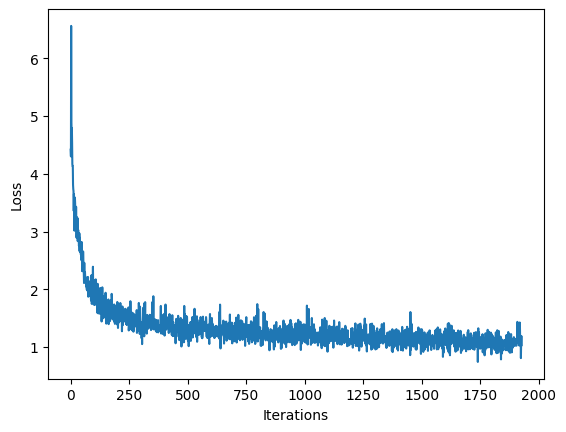

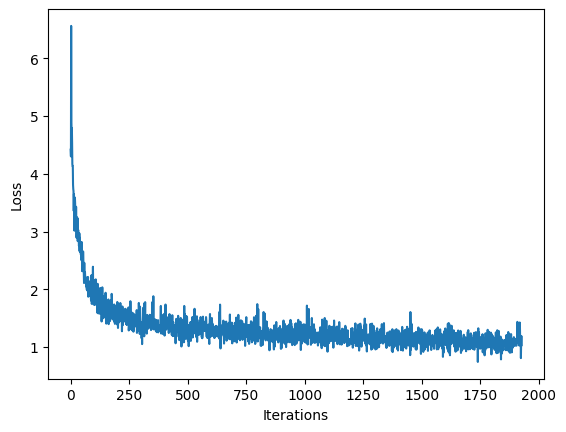

In [19]:
### Define optimizer and training operation ###

'''TODO: instantiate a new model for training using the `build_model`
  function and the hyperparameters created above.'''
model = build_model(vocab_size,embedding_dim,rnn_units,batch_size)

'''TODO: instantiate an optimizer with its learning rate.
  Checkout the tensorflow website for a list of supported optimizers.
  https://www.tensorflow.org/api_docs/python/tf/keras/optimizers/
  Try using the Adam optimizer to start.'''
optimizer = tf.keras.optimizers.Adam(learning_rate)

@tf.function
def train_step(x, y):
  # Use tf.GradientTape()
  with tf.GradientTape() as tape:

    '''TODO: feed the current input into the model and generate predictions'''
    y_hat = model(x)
    print(x)
    print(y_hat)
    print(y)
    '''TODO: compute the loss!'''
    loss = compute_loss(y, y_hat)

  # Now, compute the gradients
  '''TODO: complete the function call for gradient computation.
      Remember that we want the gradient of the loss with respect all
      of the model parameters.
      HINT: use `model.trainable_variables` to get a list of all model
      parameters.'''
  grads = tape.gradient(loss,model.trainable_variables)

  # Apply the gradients to the optimizer so it can update the model accordingly
  optimizer.apply_gradients(zip(grads, model.trainable_variables))
  return loss

##################
# Begin training!#
##################

history = []
plotter = mdl.util.PeriodicPlotter(sec=2, xlabel='Iterations', ylabel='Loss')
if hasattr(tqdm, '_instances'): tqdm._instances.clear() # clear if it exists

for iter in range(num_training_iterations):

  # Grab a batch and propagate it through the network
  x_batch, y_batch = get_batch(vectorized_songs, seq_length, batch_size)
  loss = train_step(x_batch, y_batch)

  # Update the progress bar
  history.append(loss.numpy().mean())
  plotter.plot(history)

  # Update the model with the changed weights!
  if iter % 100 == 0:
    model.save_weights(checkpoint_prefix)

# Save the trained model and the weights
model.save_weights(checkpoint_prefix)


## 2.6 Generate music using the RNN model

Now, we can use our trained RNN model to generate some music! When generating music, we'll have to feed the model some sort of seed to get it started (because it can't predict anything without something to start with!).

Once we have a generated seed, we can then iteratively predict each successive character (remember, we are using the ABC representation for our music) using our trained RNN. More specifically, recall that our RNN outputs a `softmax` over possible successive characters. For inference, we iteratively sample from these distributions, and then use our samples to encode a generated song in the ABC format.

Then, all we have to do is write it to a file and listen!

### Restore the latest checkpoint

To keep this inference step simple, we will use a batch size of 1. Because of how the RNN state is passed from timestep to timestep, the model will only be able to accept a fixed batch size once it is built.

To run the model with a different `batch_size`, we'll need to rebuild the model and restore the weights from the latest checkpoint, i.e., the weights after the last checkpoint during training:

In [19]:
tf.train.latest_checkpoint(checkpoint_dir)

'./training_checkpoints/my_ckpt'

In [20]:
'''TODO: Rebuild the model using a batch_size=1'''
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size=1)

# Restore the model weights for the last checkpoint after training
model.load_weights(tf.train.latest_checkpoint(checkpoint_dir))
model.build(tf.TensorShape([1, None]))

model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_3 (Embedding)     (1, None, 256)            21248     
                                                                 
 lstm_3 (LSTM)               (1, None, 1024)           5246976   
                                                                 
 dense_3 (Dense)             (1, None, 83)             85075     
                                                                 
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


Notice that we have fed in a fixed `batch_size` of 1 for inference.

### The prediction procedure

Now, we're ready to write the code to generate text in the ABC music format:

* Initialize a "seed" start string and the RNN state, and set the number of characters we want to generate.

* Use the start string and the RNN state to obtain the probability distribution over the next predicted character.

* Sample from multinomial distribution to calculate the index of the predicted character. This predicted character is then used as the next input to the model.

* At each time step, the updated RNN state is fed back into the model, so that it now has more context in making the next prediction. After predicting the next character, the updated RNN states are again fed back into the model, which is how it learns sequence dependencies in the data, as it gets more information from the previous predictions.

![LSTM inference](https://raw.githubusercontent.com/aamini/introtodeeplearning/2019/lab1/img/lstm_inference.png)

Complete and experiment with this code block (as well as some of the aspects of network definition and training!), and see how the model performs. How do songs generated after training with a small number of epochs compare to those generated after a longer duration of training?

In [24]:
?model

In [29]:
### Prediction of a generated song ###

def generate_text(model, start_string, generation_length=1000):
  # Evaluation step (generating ABC text using the learned RNN model)

  '''TODO: convert the start string to numbers (vectorize)'''
  input_eval =  [char2idx[s] for s in start_string]
  #print(input_eval)
  input_eval = tf.expand_dims(input_eval, 0)
  #print(input_eval)
  # Empty string to store our results

  text_generated = []

  # Here batch size == 1
  model.reset_states()
  tqdm._instances.clear()

  for i in tqdm(range(generation_length)):
      '''TODO: evaluate the inputs and generate the next character predictions'''
      predictions = model(input_eval)
      #print(predictions)
      # Remove the batch dimension
      predictions = tf.squeeze(predictions, 0)
      #print(predictions)

      '''TODO: use a multinomial distribution to sample'''
      print(tf.random.categorical(predictions, num_samples=1))
      predicted_id = tf.random.categorical(predictions, num_samples=1)[-1,0].numpy()
      print(predicted_id)
      # Pass the prediction along with the previous hidden state
      #   as the next inputs to the model
      input_eval = tf.expand_dims([predicted_id], 0)
      print(input_eval)
      '''TODO: add the predicted character to the generated text!'''
      # Hint: consider what format the prediction is in vs. the output
      text_generated.append(idx2char[predicted_id])

  return (start_string + ''.join(text_generated))

In [37]:
'''TODO: Use the model and the function defined above to generate ABC format text of length 1000!
    As you may notice, ABC files start with "X" - this may be a good start string.'''
generated_text = generate_text(model, start_string="X", generation_length=30000) # TODO
# generated_text = generate_text('''TODO''', start_string="X", generation_length=1000)

[49]
tf.Tensor([[49]], shape=(1, 1), dtype=int32)


  0%|          | 3/30000 [00:00<22:09, 22.56it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)


  0%|          | 9/30000 [00:00<19:56, 25.07it/s]

tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[41]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)


  0%|          | 20/30000 [00:00<12:40, 39.40it/s]

tf.Tensor([[70]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
33
tf.Tensor([[33]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
77
tf.Tensor([[77]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)

  0%|          | 25/30000 [00:00<14:40, 34.05it/s]


tf.Tensor([[69]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[44]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[5]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)


  0%|          | 34/30000 [00:01<13:53, 35.94it/s]

tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)


  0%|          | 47/30000 [00:01<10:38, 46.92it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dty

  0%|          | 52/30000 [00:01<11:19, 44.07it/s]

49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)


  0%|          | 62/30000 [00:01<12:11, 40.90it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
33
tf.Tensor([[33]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
76
tf.Tensor([[76]], shape=(1, 1), dtype=int32)
tf.Tensor([[68]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[68]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)


  0%|          | 72/30000 [00:01<12:47, 38.98it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
33
tf.Tensor([[33]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
76
tf.Tensor([[76]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)


  0%|          | 77/30000 [00:02<12:37, 39.50it/s]

tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)


  0%|          | 85/30000 [00:02<13:53, 35.90it/s]

73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[71]], shape=(1, 1), dtype=int64)
71
tf.Tensor([[71]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[71]], shape=(1, 1), dtype=int64)
71
tf.Tensor([[71]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)


  0%|          | 97/30000 [00:02<11:10, 44.57it/s]

tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
19
tf.Tensor([[19]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1),

  0%|          | 116/30000 [00:02<07:22, 67.56it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1),

  0%|          | 135/30000 [00:02<06:09, 80.90it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

  1%|          | 154/30000 [00:03<05:44, 86.56it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), d

  1%|          | 174/30000 [00:03<05:32, 89.58it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1,

  1%|          | 194/30000 [00:03<05:30, 90.30it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1

  1%|          | 214/30000 [00:03<05:24, 91.83it/s]

tf.Tensor([[70]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 

  1%|          | 234/30000 [00:04<05:20, 92.74it/s]

tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[81]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 

  1%|          | 254/30000 [00:04<05:13, 94.79it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(

  1%|          | 264/30000 [00:04<05:26, 91.04it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

  1%|          | 284/30000 [00:04<05:25, 91.29it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1

  1%|          | 304/30000 [00:04<05:25, 91.23it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
19
tf.Tensor([[19]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1)

  1%|          | 324/30000 [00:04<05:22, 92.01it/s]

tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 

  1%|          | 344/30000 [00:05<05:19, 92.84it/s]

38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 

  1%|          | 364/30000 [00:05<05:29, 89.85it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[24]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1

  1%|▏         | 384/30000 [00:05<05:25, 90.86it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

  1%|▏         | 404/30000 [00:05<05:20, 92.42it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1),

  1%|▏         | 414/30000 [00:05<05:20, 92.37it/s]

22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 

  1%|▏         | 434/30000 [00:06<05:29, 89.86it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1

  2%|▏         | 453/30000 [00:06<05:32, 88.98it/s]

59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 

  2%|▏         | 472/30000 [00:06<05:28, 89.81it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

  2%|▏         | 491/30000 [00:06<05:28, 89.93it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtyp

  2%|▏         | 511/30000 [00:07<05:21, 91.77it/s]

tf.Tensor([[71]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
41
tf.Tensor([[41]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1

  2%|▏         | 531/30000 [00:07<05:22, 91.40it/s]

tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[71]], shape=(1, 1), dtype=int64)
71
tf.Tensor([[71]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[71]], shape=(1, 1), dtype=int64)
71
tf.Tensor([[71]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 

  2%|▏         | 551/30000 [00:07<05:24, 90.81it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 

  2%|▏         | 571/30000 [00:07<05:15, 93.29it/s]

tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1)

  2%|▏         | 591/30000 [00:07<05:20, 91.71it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(

  2%|▏         | 611/30000 [00:08<05:18, 92.36it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 

  2%|▏         | 621/30000 [00:08<05:21, 91.39it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

  2%|▏         | 641/30000 [00:08<05:32, 88.35it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1)

  2%|▏         | 661/30000 [00:08<05:22, 91.05it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

  2%|▏         | 681/30000 [00:08<05:23, 90.59it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1,

  2%|▏         | 701/30000 [00:09<05:22, 90.86it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[41]], shape=(1, 1), dtype=int64)
35
tf.Tensor([[35]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
66
tf.Tensor([[66]], shape=(1

  2%|▏         | 721/30000 [00:09<05:20, 91.37it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[39]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), 

  2%|▏         | 741/30000 [00:09<05:23, 90.55it/s]

tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[71]], shape=(1, 1), dtype=int64)
71
tf.Tensor([[71]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[21]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 

  3%|▎         | 761/30000 [00:09<05:23, 90.50it/s]

0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1)

  3%|▎         | 771/30000 [00:09<05:21, 90.96it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

  3%|▎         | 791/30000 [00:10<05:18, 91.61it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 

  3%|▎         | 811/30000 [00:10<05:50, 83.27it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

  3%|▎         | 828/30000 [00:10<06:18, 77.05it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape

  3%|▎         | 844/30000 [00:10<06:29, 74.81it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1,

  3%|▎         | 852/30000 [00:10<06:37, 73.41it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=

  3%|▎         | 868/30000 [00:11<06:36, 73.39it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1

  3%|▎         | 884/30000 [00:11<06:50, 70.97it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

  3%|▎         | 900/30000 [00:11<06:56, 69.90it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1,

  3%|▎         | 916/30000 [00:11<06:58, 69.55it/s]


61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(

  3%|▎         | 924/30000 [00:12<06:53, 70.35it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(

  3%|▎         | 940/30000 [00:12<06:52, 70.39it/s]

82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1),

  3%|▎         | 955/30000 [00:12<07:02, 68.83it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 

  3%|▎         | 969/30000 [00:12<07:16, 66.49it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

  3%|▎         | 988/30000 [00:12<06:04, 79.70it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[19]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1),

  3%|▎         | 1006/30000 [00:13<05:44, 84.23it/s]

tf.Tensor([[45]], shape=(1, 1), dtype=int64)
41
tf.Tensor([[41]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[5]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 

  3%|▎         | 1025/30000 [00:13<05:26, 88.82it/s]

tf.Tensor([[65]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[19]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 

  3%|▎         | 1044/30000 [00:13<05:20, 90.30it/s]

tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 

  4%|▎         | 1064/30000 [00:13<05:19, 90.50it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

  4%|▎         | 1084/30000 [00:13<05:21, 89.98it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(

  4%|▎         | 1104/30000 [00:14<05:20, 90.12it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[6]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1

  4%|▎         | 1124/30000 [00:14<05:23, 89.30it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(

  4%|▍         | 1143/30000 [00:14<05:17, 90.83it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
76
tf.Tensor([[76]], shape=(1, 

  4%|▍         | 1153/30000 [00:14<05:28, 87.77it/s]

tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[71]], shape=(1, 1), dtype=int64)
71
tf.Tensor([[71]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
71
tf.Tensor([[71]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

  4%|▍         | 1172/30000 [00:14<05:23, 89.00it/s]

tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 

  4%|▍         | 1191/30000 [00:15<05:14, 91.65it/s]

tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 

  4%|▍         | 1211/30000 [00:15<05:14, 91.67it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

  4%|▍         | 1231/30000 [00:15<05:19, 90.15it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

  4%|▍         | 1251/30000 [00:15<05:25, 88.41it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1,

  4%|▍         | 1269/30000 [00:16<05:36, 85.36it/s]

8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype

  4%|▍         | 1288/30000 [00:16<05:26, 88.06it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1

  4%|▍         | 1307/30000 [00:16<05:18, 90.14it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1,

  4%|▍         | 1327/30000 [00:16<05:15, 90.83it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(

  4%|▍         | 1347/30000 [00:16<05:19, 89.69it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(

  5%|▍         | 1365/30000 [00:17<05:22, 88.79it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(

  5%|▍         | 1375/30000 [00:17<05:19, 89.45it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

  5%|▍         | 1395/30000 [00:17<05:14, 91.05it/s]

tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), d

  5%|▍         | 1415/30000 [00:17<05:12, 91.60it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
6
tf.Tensor([[6]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

  5%|▍         | 1435/30000 [00:17<05:18, 89.60it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

  5%|▍         | 1454/30000 [00:18<05:20, 89.10it/s]

tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
78
tf.Tensor([[78]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
41
tf.Tensor([[41]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[5]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1,

  5%|▍         | 1472/30000 [00:18<05:25, 87.76it/s]

59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 

  5%|▍         | 1490/30000 [00:18<05:22, 88.46it/s]

tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(

  5%|▌         | 1509/30000 [00:18<05:15, 90.26it/s]

tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[79]], shape=(1, 1), dtype=int64)
79
tf.Tensor([[79]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[80]], shape=(1, 1), dtype=int64)
80
tf.Tensor([[80]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

  5%|▌         | 1529/30000 [00:18<05:16, 90.00it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

  5%|▌         | 1549/30000 [00:19<05:13, 90.72it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

  5%|▌         | 1559/30000 [00:19<05:15, 90.13it/s]

tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
19
tf.Tensor([[19]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[68]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(

  5%|▌         | 1579/30000 [00:19<05:12, 91.06it/s]

tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[10]], shape=(1, 1), dtype=int64)
10
tf.Tensor([[10]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dt

  5%|▌         | 1599/30000 [00:19<05:13, 90.48it/s]

tf.Tensor([[17]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
19
tf.Tensor([[19]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 

  5%|▌         | 1619/30000 [00:19<05:16, 89.77it/s]

1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[79]], shape=(1, 1), dtype=int64)
79
tf.Tensor([[79]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[80]], shape=(1, 1), dtype=int64)
80
tf.Tensor([[80]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(

  5%|▌         | 1639/30000 [00:20<05:09, 91.75it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
54
tf.Tensor([[54]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=

  6%|▌         | 1659/30000 [00:20<05:16, 89.66it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dt

  6%|▌         | 1679/30000 [00:20<05:09, 91.57it/s]

62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=

  6%|▌         | 1699/30000 [00:20<05:14, 89.87it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1)

  6%|▌         | 1718/30000 [00:21<05:19, 88.57it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(

  6%|▌         | 1737/30000 [00:21<05:16, 89.21it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

  6%|▌         | 1756/30000 [00:21<05:15, 89.41it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1,

  6%|▌         | 1775/30000 [00:21<05:13, 89.96it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(

  6%|▌         | 1784/30000 [00:21<05:22, 87.50it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(

  6%|▌         | 1803/30000 [00:21<05:20, 87.91it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(

  6%|▌         | 1821/30000 [00:22<05:22, 87.26it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

  6%|▌         | 1841/30000 [00:22<05:12, 90.11it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1

  6%|▌         | 1861/30000 [00:22<05:19, 88.01it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

  6%|▌         | 1870/30000 [00:22<05:57, 78.66it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1)

  6%|▋         | 1887/30000 [00:23<06:23, 73.35it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

  6%|▋         | 1903/30000 [00:23<06:39, 70.41it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

  6%|▋         | 1919/30000 [00:23<06:33, 71.41it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1

  6%|▋         | 1935/30000 [00:23<06:38, 70.46it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 

  6%|▋         | 1950/30000 [00:23<06:56, 67.35it/s]


tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1,

  7%|▋         | 1958/30000 [00:24<06:46, 68.94it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1)

  7%|▋         | 1974/30000 [00:24<06:44, 69.23it/s]

58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(

  7%|▋         | 1988/30000 [00:24<07:07, 65.46it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1),

  7%|▋         | 2002/30000 [00:24<07:00, 66.50it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(

  7%|▋         | 2016/30000 [00:24<07:03, 66.10it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1

  7%|▋         | 2030/30000 [00:25<07:04, 65.91it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 

  7%|▋         | 2049/30000 [00:25<05:57, 78.23it/s]

59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1

  7%|▋         | 2069/30000 [00:25<05:24, 86.08it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dt

  7%|▋         | 2089/30000 [00:25<05:10, 90.03it/s]

tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
40
tf.Tensor([[40]], shape=(1, 1), dtype=int32)
tf.Tensor([[5]], shape=(1, 1), dtype=int64)
77
tf.Tensor([[77]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
33
tf.Tensor([[33]], shape=(1, 1), dtype=int32)
tf.Tensor([[76]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[76]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1,

  7%|▋         | 2108/30000 [00:26<05:12, 89.13it/s]

22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 

  7%|▋         | 2127/30000 [00:26<05:15, 88.44it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 

  7%|▋         | 2145/30000 [00:26<05:24, 85.71it/s]

tf.Tensor([[80]], shape=(1, 1), dtype=int64)
80
tf.Tensor([[80]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

  7%|▋         | 2164/30000 [00:26<05:11, 89.39it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

  7%|▋         | 2183/30000 [00:26<05:06, 90.73it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

  7%|▋         | 2193/30000 [00:26<05:12, 88.85it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1),

  7%|▋         | 2213/30000 [00:27<05:02, 91.83it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[6]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1

  7%|▋         | 2233/30000 [00:27<04:59, 92.68it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(

  8%|▊         | 2253/30000 [00:27<05:05, 90.85it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1,

  8%|▊         | 2273/30000 [00:27<05:08, 89.84it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

  8%|▊         | 2291/30000 [00:28<05:14, 88.24it/s]

26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(

  8%|▊         | 2310/30000 [00:28<05:15, 87.75it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(

  8%|▊         | 2329/30000 [00:28<05:10, 89.26it/s]

tf.Tensor([[15]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

  8%|▊         | 2349/30000 [00:28<05:03, 91.09it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1

  8%|▊         | 2369/30000 [00:28<04:57, 92.84it/s]

tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

  8%|▊         | 2389/30000 [00:29<05:01, 91.50it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

  8%|▊         | 2409/30000 [00:29<05:03, 90.81it/s]

tf.Tensor([[2]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1

  8%|▊         | 2429/30000 [00:29<04:59, 91.94it/s]

tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1)

  8%|▊         | 2439/30000 [00:29<05:03, 90.95it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1

  8%|▊         | 2459/30000 [00:29<05:10, 88.67it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[25]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 

  8%|▊         | 2478/30000 [00:30<05:07, 89.54it/s]

tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1,

  8%|▊         | 2496/30000 [00:30<05:14, 87.32it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 

  8%|▊         | 2515/30000 [00:30<05:10, 88.57it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1,

  8%|▊         | 2533/30000 [00:30<05:10, 88.43it/s]

tf.Tensor([[2]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 

  9%|▊         | 2552/30000 [00:31<05:09, 88.55it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(

  9%|▊         | 2570/30000 [00:31<05:14, 87.22it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1),

  9%|▊         | 2588/30000 [00:31<05:14, 87.23it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

  9%|▊         | 2607/30000 [00:31<05:08, 88.79it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1),

  9%|▉         | 2625/30000 [00:31<05:12, 87.65it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1

  9%|▉         | 2643/30000 [00:32<05:21, 85.17it/s]

tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[25]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 

  9%|▉         | 2662/30000 [00:32<05:17, 86.00it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1),

  9%|▉         | 2681/30000 [00:32<05:15, 86.46it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(

  9%|▉         | 2700/30000 [00:32<05:05, 89.26it/s]

62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(

  9%|▉         | 2719/30000 [00:32<05:06, 89.09it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1

  9%|▉         | 2737/30000 [00:33<05:15, 86.41it/s]

tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtyp

  9%|▉         | 2756/30000 [00:33<05:08, 88.36it/s]

59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(

  9%|▉         | 2774/30000 [00:33<05:10, 87.74it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

  9%|▉         | 2793/30000 [00:33<05:07, 88.38it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1,

  9%|▉         | 2812/30000 [00:33<05:05, 88.90it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(

  9%|▉         | 2830/30000 [00:34<05:09, 87.71it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 

  9%|▉         | 2849/30000 [00:34<05:02, 89.74it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 10%|▉         | 2858/30000 [00:34<05:08, 88.05it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 

 10%|▉         | 2876/30000 [00:34<05:14, 86.13it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 

 10%|▉         | 2895/30000 [00:34<05:09, 87.45it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1

 10%|▉         | 2913/30000 [00:35<05:10, 87.33it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), d

 10%|▉         | 2931/30000 [00:35<06:03, 74.37it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
68
tf.Tensor([[68]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[76]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[80]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 10%|▉         | 2939/30000 [00:35<06:20, 71.04it/s]

tf.Tensor([[67]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 

 10%|▉         | 2955/30000 [00:35<06:28, 69.59it/s]

tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
19
tf.Tensor([[19]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1,

 10%|▉         | 2971/30000 [00:36<06:19, 71.26it/s]

13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 

 10%|▉         | 2987/30000 [00:36<06:28, 69.49it/s]


36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[79]], shape=(1, 1), dtype=int64)
79
tf.Tensor([[79]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[80]], shape=(1, 1), dtype=int64)
80
tf.Tensor([[80]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=

 10%|▉         | 2995/30000 [00:36<06:27, 69.62it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1)

 10%|█         | 3011/30000 [00:36<06:18, 71.35it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 

 10%|█         | 3027/30000 [00:36<06:10, 72.79it/s]


tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1)

 10%|█         | 3043/30000 [00:37<06:05, 73.69it/s]


tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 

 10%|█         | 3059/30000 [00:37<06:15, 71.74it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 10%|█         | 3075/30000 [00:37<06:21, 70.65it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), 

 10%|█         | 3090/30000 [00:37<06:28, 69.32it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 10%|█         | 3107/30000 [00:37<05:53, 76.05it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

 10%|█         | 3125/30000 [00:38<05:31, 80.99it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1

 10%|█         | 3134/30000 [00:38<05:34, 80.22it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1),

 11%|█         | 3153/30000 [00:38<05:18, 84.28it/s]

59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(

 11%|█         | 3172/30000 [00:38<05:07, 87.13it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 11%|█         | 3190/30000 [00:38<05:10, 86.22it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape

 11%|█         | 3208/30000 [00:39<05:09, 86.68it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1

 11%|█         | 3226/30000 [00:39<05:12, 85.57it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1

 11%|█         | 3244/30000 [00:39<05:11, 85.80it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
19
tf.Tensor([[19]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
40
tf.Tensor([[40]], shape=(1, 1),

 11%|█         | 3263/30000 [00:39<05:03, 88.17it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(

 11%|█         | 3282/30000 [00:39<05:01, 88.54it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 

 11%|█         | 3301/30000 [00:40<04:59, 89.02it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(

 11%|█         | 3319/30000 [00:40<05:07, 86.74it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1,

 11%|█         | 3338/30000 [00:40<04:57, 89.60it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 11%|█         | 3357/30000 [00:40<04:54, 90.52it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1

 11%|█▏        | 3377/30000 [00:40<04:57, 89.53it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1

 11%|█▏        | 3396/30000 [00:41<04:55, 90.14it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1),

 11%|█▏        | 3416/30000 [00:41<04:58, 89.12it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 11%|█▏        | 3434/30000 [00:41<05:00, 88.30it/s]


tf.Tensor([[81]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=

 12%|█▏        | 3453/30000 [00:41<04:56, 89.49it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1

 12%|█▏        | 3472/30000 [00:42<04:57, 89.31it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 12%|█▏        | 3490/30000 [00:42<05:06, 86.51it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(

 12%|█▏        | 3509/30000 [00:42<05:00, 88.30it/s]

tf.Tensor([[5]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1

 12%|█▏        | 3518/30000 [00:42<05:07, 86.14it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 

 12%|█▏        | 3537/30000 [00:42<05:07, 86.02it/s]

tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(

 12%|█▏        | 3556/30000 [00:43<05:03, 87.01it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 

 12%|█▏        | 3575/30000 [00:43<04:57, 88.94it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[25]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1

 12%|█▏        | 3594/30000 [00:43<05:03, 86.92it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 12%|█▏        | 3613/30000 [00:43<05:00, 87.94it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dt

 12%|█▏        | 3632/30000 [00:43<04:55, 89.10it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
54
tf.Tensor([[54]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(

 12%|█▏        | 3651/30000 [00:44<04:54, 89.55it/s]

1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1

 12%|█▏        | 3671/30000 [00:44<04:58, 88.07it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 

 12%|█▏        | 3690/30000 [00:44<04:54, 89.38it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1,

 12%|█▏        | 3709/30000 [00:44<04:57, 88.48it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1

 12%|█▏        | 3728/30000 [00:44<04:48, 90.99it/s]

tf.Tensor([[15]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1,

 12%|█▏        | 3747/30000 [00:45<04:59, 87.78it/s]

tf.Tensor([[15]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 13%|█▎        | 3756/30000 [00:45<05:09, 84.88it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 

 13%|█▎        | 3776/30000 [00:45<04:59, 87.67it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1

 13%|█▎        | 3795/30000 [00:45<04:55, 88.70it/s]

tf.Tensor([[16]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
80
tf.Tensor([[80]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1,

 13%|█▎        | 3814/30000 [00:45<04:50, 90.05it/s]

tf.Tensor([[78]], shape=(1, 1), dtype=int64)
78
tf.Tensor([[78]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[39]], shape=(1, 1), dtype=int64)
39
tf.Tensor([[39]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
80
tf.Tensor([[80]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1),

 13%|█▎        | 3833/30000 [00:46<04:53, 89.24it/s]

60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[19]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1

 13%|█▎        | 3851/30000 [00:46<05:05, 85.62it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[79]], shape=(1, 1), dtype=int64)
79
tf.Tensor([[79]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[80]], shape=(1, 1), dtype=int64)
80
tf.Tensor([[80]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(

 13%|█▎        | 3870/30000 [00:46<05:06, 85.38it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 13%|█▎        | 3889/30000 [00:46<05:02, 86.33it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 

 13%|█▎        | 3907/30000 [00:47<05:00, 86.85it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=

 13%|█▎        | 3926/30000 [00:47<04:55, 88.18it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1

 13%|█▎        | 3945/30000 [00:47<05:00, 86.79it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 13%|█▎        | 3964/30000 [00:47<04:53, 88.75it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 13%|█▎        | 3973/30000 [00:47<05:15, 82.51it/s]

1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1,

 13%|█▎        | 3990/30000 [00:48<05:47, 74.91it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 

 13%|█▎        | 3998/30000 [00:48<06:29, 66.74it/s]


tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=

 13%|█▎        | 4013/30000 [00:48<06:27, 67.08it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1

 13%|█▎        | 4029/30000 [00:48<06:08, 70.56it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(

 13%|█▎        | 4045/30000 [00:48<06:02, 71.51it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1,

 14%|█▎        | 4060/30000 [00:49<06:30, 66.47it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 14%|█▎        | 4074/30000 [00:49<06:25, 67.33it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[19]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
44
tf.Tensor([[44]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
77
tf.Tensor([[77]], shape=(1, 1

 14%|█▎        | 4088/30000 [00:49<06:21, 67.88it/s]

tf.Tensor([[69]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1

 14%|█▎        | 4103/30000 [00:49<06:22, 67.62it/s]


58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[71]], shape=(1, 1), dtype=int64)
71
tf.Tensor([[71]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[71]], shape=(1, 1), dtype=int64)
71
tf.Tensor([[71]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1,

 14%|█▎        | 4117/30000 [00:49<06:29, 66.46it/s]

tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 

 14%|█▍        | 4132/30000 [00:50<06:16, 68.70it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1

 14%|█▍        | 4139/30000 [00:50<06:29, 66.32it/s]

tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
54
tf.Tensor([[54]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 14%|█▍        | 4153/30000 [00:50<06:46, 63.51it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 

 14%|█▍        | 4172/30000 [00:50<05:40, 75.77it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dt

 14%|█▍        | 4191/30000 [00:50<05:12, 82.48it/s]

59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(

 14%|█▍        | 4209/30000 [00:51<05:09, 83.26it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1,

 14%|█▍        | 4227/30000 [00:51<05:12, 82.55it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1,

 14%|█▍        | 4245/30000 [00:51<05:06, 83.98it/s]

tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=in

 14%|█▍        | 4264/30000 [00:51<04:58, 86.14it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype

 14%|█▍        | 4282/30000 [00:52<04:56, 86.75it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 14%|█▍        | 4301/30000 [00:52<04:52, 87.91it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 14%|█▍        | 4319/30000 [00:52<04:58, 85.90it/s]

31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(

 14%|█▍        | 4338/30000 [00:52<04:53, 87.29it/s]

tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), 

 15%|█▍        | 4356/30000 [00:52<04:56, 86.44it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(

 15%|█▍        | 4376/30000 [00:53<04:43, 90.25it/s]

1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1

 15%|█▍        | 4396/30000 [00:53<04:43, 90.29it/s]

tf.Tensor([[54]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(

 15%|█▍        | 4406/30000 [00:53<04:51, 87.86it/s]

82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1,

 15%|█▍        | 4424/30000 [00:53<05:02, 84.44it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1

 15%|█▍        | 4442/30000 [00:53<05:03, 84.08it/s]

tf.Tensor([[54]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1),

 15%|█▍        | 4460/30000 [00:54<05:03, 84.17it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
6
tf.Tensor([[6]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[6]], shape=(1, 1),

 15%|█▍        | 4478/30000 [00:54<05:08, 82.79it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[24]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 15%|█▍        | 4497/30000 [00:54<04:57, 85.61it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 

 15%|█▌        | 4516/30000 [00:54<04:55, 86.19it/s]

tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 

 15%|█▌        | 4534/30000 [00:55<05:01, 84.59it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[21]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dty

 15%|█▌        | 4552/30000 [00:55<05:00, 84.70it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[76]], shape=(1, 1), dtype=int64)
76
tf.Tensor([[76]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 

 15%|█▌        | 4570/30000 [00:55<05:00, 84.76it/s]

tf.Tensor([[65]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[19]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 

 15%|█▌        | 4588/30000 [00:55<05:00, 84.46it/s]

tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 

 15%|█▌        | 4606/30000 [00:55<05:01, 84.35it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 

 15%|█▌        | 4624/30000 [00:56<04:58, 85.00it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1,

 15%|█▌        | 4643/30000 [00:56<04:54, 86.22it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[25]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
25
tf.Tensor([[25]], shape=(1

 16%|█▌        | 4661/30000 [00:56<04:54, 85.90it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1)

 16%|█▌        | 4679/30000 [00:56<04:56, 85.54it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 16%|█▌        | 4688/30000 [00:56<04:59, 84.41it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1

 16%|█▌        | 4707/30000 [00:57<04:52, 86.51it/s]

59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 

 16%|█▌        | 4726/30000 [00:57<04:50, 87.12it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1),

 16%|█▌        | 4744/30000 [00:57<04:54, 85.90it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 16%|█▌        | 4762/30000 [00:57<04:55, 85.30it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dty

 16%|█▌        | 4781/30000 [00:57<04:47, 87.65it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 16%|█▌        | 4799/30000 [00:58<04:49, 86.96it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 

 16%|█▌        | 4817/30000 [00:58<04:57, 84.72it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
24
tf.Tensor([[24]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 16%|█▌        | 4836/30000 [00:58<04:50, 86.64it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 16%|█▌        | 4854/30000 [00:58<04:57, 84.60it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 16%|█▌        | 4872/30000 [00:58<04:54, 85.39it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), d

 16%|█▋        | 4890/30000 [00:59<04:49, 86.60it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
44
tf.Tensor([[44]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[76]], shape=(1, 1), dtype=int64)
80
tf.Tensor([[80]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1),

 16%|█▋        | 4908/30000 [00:59<04:49, 86.75it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[19]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 

 16%|█▋        | 4926/30000 [00:59<04:54, 85.02it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1),

 16%|█▋        | 4944/30000 [00:59<05:02, 82.82it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 17%|█▋        | 4962/30000 [01:00<04:56, 84.40it/s]

59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(

 17%|█▋        | 4980/30000 [01:00<04:56, 84.49it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1)

 17%|█▋        | 4998/30000 [01:00<04:59, 83.46it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(

 17%|█▋        | 5007/30000 [01:00<05:18, 78.41it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1)

 17%|█▋        | 5023/30000 [01:00<06:00, 69.26it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 17%|█▋        | 5038/30000 [01:01<06:16, 66.25it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 17%|█▋        | 5046/30000 [01:01<06:08, 67.64it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 

 17%|█▋        | 5061/30000 [01:01<06:06, 67.98it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(

 17%|█▋        | 5077/30000 [01:01<06:01, 69.03it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 17%|█▋        | 5092/30000 [01:01<05:59, 69.23it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1)

 17%|█▋        | 5107/30000 [01:02<05:53, 70.50it/s]


tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 

 17%|█▋        | 5122/30000 [01:02<06:03, 68.45it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(

 17%|█▋        | 5136/30000 [01:02<06:06, 67.84it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dt

 17%|█▋        | 5150/30000 [01:02<06:23, 64.81it/s]

tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
77
tf.Tensor([[77]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(

 17%|█▋        | 5157/30000 [01:02<06:47, 60.93it/s]

tf.Tensor([[70]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[76]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1,

 17%|█▋        | 5171/30000 [01:03<06:31, 63.42it/s]

tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[71]], shape=(1, 1), dtype=int64)
71
tf.Tensor([[71]], shape=(

 17%|█▋        | 5185/30000 [01:03<06:43, 61.56it/s]

tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
19
tf.Tensor([[19]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1),

 17%|█▋        | 5203/30000 [01:03<05:38, 73.36it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 

 17%|█▋        | 5221/30000 [01:03<05:10, 79.88it/s]

26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(

 17%|█▋        | 5239/30000 [01:03<05:04, 81.29it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
71
tf.Tensor([[71]], shape=(1

 18%|█▊        | 5258/30000 [01:04<04:52, 84.60it/s]

tf.Tensor([[75]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[76]], shape=(1, 1), dtype=int64)
76
tf.Tensor([[76]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1,

 18%|█▊        | 5277/30000 [01:04<04:47, 86.13it/s]

tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
21
tf.Tensor([[21]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1),

 18%|█▊        | 5296/30000 [01:04<04:41, 87.62it/s]

tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

 18%|█▊        | 5315/30000 [01:04<04:38, 88.65it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 18%|█▊        | 5324/30000 [01:04<04:45, 86.48it/s]

32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(

 18%|█▊        | 5342/30000 [01:05<04:57, 83.02it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1,

 18%|█▊        | 5360/30000 [01:05<04:53, 84.01it/s]

26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1,

 18%|█▊        | 5378/30000 [01:05<04:48, 85.45it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[48]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), 

 18%|█▊        | 5397/30000 [01:05<04:42, 87.15it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1),

 18%|█▊        | 5416/30000 [01:06<04:43, 86.58it/s]

tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 

 18%|█▊        | 5435/30000 [01:06<04:44, 86.30it/s]

tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 

 18%|█▊        | 5453/30000 [01:06<04:41, 87.20it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 

 18%|█▊        | 5472/30000 [01:06<04:42, 86.91it/s]

tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), 

 18%|█▊        | 5490/30000 [01:06<04:45, 85.91it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), 

 18%|█▊        | 5499/30000 [01:07<04:54, 83.33it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype

 18%|█▊        | 5517/30000 [01:07<04:52, 83.65it/s]

tf.Tensor([[48]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[76]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(

 18%|█▊        | 5535/30000 [01:07<04:48, 84.81it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[71]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
71
tf.Tensor([[71]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 

 19%|█▊        | 5553/30000 [01:07<04:51, 83.78it/s]

tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 

 19%|█▊        | 5571/30000 [01:07<04:47, 84.87it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 19%|█▊        | 5589/30000 [01:08<05:00, 81.28it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=

 19%|█▊        | 5607/30000 [01:08<04:57, 82.08it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dt

 19%|█▉        | 5625/30000 [01:08<04:50, 83.84it/s]

60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1,

 19%|█▉        | 5644/30000 [01:08<04:40, 86.75it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 

 19%|█▉        | 5662/30000 [01:08<04:40, 86.75it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape

 19%|█▉        | 5681/30000 [01:09<04:43, 85.75it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1

 19%|█▉        | 5700/30000 [01:09<04:37, 87.44it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[25]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), 

 19%|█▉        | 5718/30000 [01:09<04:39, 86.77it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(

 19%|█▉        | 5736/30000 [01:09<04:40, 86.51it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[25]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1)

 19%|█▉        | 5754/30000 [01:10<04:43, 85.65it/s]

tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1),

 19%|█▉        | 5773/30000 [01:10<04:39, 86.79it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), d

 19%|█▉        | 5792/30000 [01:10<04:34, 88.34it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1)

 19%|█▉        | 5810/30000 [01:10<04:35, 87.90it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 

 19%|█▉        | 5829/30000 [01:10<04:32, 88.76it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 19%|█▉        | 5847/30000 [01:11<04:36, 87.38it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
24
tf.Tensor([[24]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1),

 20%|█▉        | 5865/30000 [01:11<04:35, 87.60it/s]


60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=

 20%|█▉        | 5883/30000 [01:11<04:35, 87.41it/s]


58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=

 20%|█▉        | 5902/30000 [01:11<04:32, 88.56it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1

 20%|█▉        | 5911/30000 [01:11<04:48, 83.61it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(

 20%|█▉        | 5929/30000 [01:12<04:46, 84.16it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 20%|█▉        | 5947/30000 [01:12<04:43, 84.99it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1)

 20%|█▉        | 5965/30000 [01:12<04:38, 86.27it/s]

tf.Tensor([[21]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 

 20%|█▉        | 5983/30000 [01:12<04:37, 86.53it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1

 20%|██        | 6002/30000 [01:12<04:35, 87.23it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1

 20%|██        | 6020/30000 [01:13<04:38, 86.19it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 20%|██        | 6038/30000 [01:13<04:41, 85.03it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 

 20%|██        | 6055/30000 [01:13<05:26, 73.24it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1

 20%|██        | 6063/30000 [01:13<05:49, 68.53it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(

 20%|██        | 6077/30000 [01:13<05:56, 67.02it/s]


tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1)

 20%|██        | 6091/30000 [01:14<06:00, 66.29it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1)

 20%|██        | 6105/30000 [01:14<06:15, 63.60it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1,

 20%|██        | 6120/30000 [01:14<06:01, 66.07it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1

 20%|██        | 6134/30000 [01:14<05:56, 67.01it/s]


tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtyp

 20%|██        | 6149/30000 [01:15<05:45, 69.10it/s]

tf.Tensor([[16]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
66
tf.Tensor([[66]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(

 21%|██        | 6163/30000 [01:15<05:50, 67.97it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1),

 21%|██        | 6178/30000 [01:15<05:44, 69.20it/s]

tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
19
tf.Tensor([[19]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
21
tf.Tensor([[21]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1),

 21%|██        | 6192/30000 [01:15<06:02, 65.66it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1),

 21%|██        | 6206/30000 [01:15<06:09, 64.46it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 21%|██        | 6213/30000 [01:16<06:20, 62.52it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(

 21%|██        | 6227/30000 [01:16<06:25, 61.59it/s]


tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 

 21%|██        | 6246/30000 [01:16<05:20, 74.14it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1),

 21%|██        | 6265/30000 [01:16<04:51, 81.43it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 

 21%|██        | 6283/30000 [01:16<04:42, 83.89it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), d

 21%|██        | 6302/30000 [01:17<04:36, 85.84it/s]

tf.Tensor([[67]], shape=(1, 1), dtype=int64)
79
tf.Tensor([[79]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 

 21%|██        | 6320/30000 [01:17<04:44, 83.31it/s]

tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 

 21%|██        | 6338/30000 [01:17<04:42, 83.64it/s]

tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), 

 21%|██        | 6356/30000 [01:17<04:44, 83.24it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1),

 21%|██        | 6374/30000 [01:17<04:39, 84.54it/s]

13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1

 21%|██▏       | 6392/30000 [01:18<04:43, 83.36it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1

 21%|██▏       | 6401/30000 [01:18<04:55, 79.84it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1),

 21%|██▏       | 6419/30000 [01:18<04:45, 82.72it/s]

tf.Tensor([[2]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1,

 21%|██▏       | 6438/30000 [01:18<04:40, 83.97it/s]

0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 

 22%|██▏       | 6457/30000 [01:18<04:34, 85.91it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 

 22%|██▏       | 6476/30000 [01:19<04:29, 87.15it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dty

 22%|██▏       | 6495/30000 [01:19<04:35, 85.26it/s]

tf.Tensor([[37]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1,

 22%|██▏       | 6513/30000 [01:19<04:34, 85.47it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[21]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 

 22%|██▏       | 6531/30000 [01:19<04:36, 84.88it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 

 22%|██▏       | 6549/30000 [01:20<04:40, 83.52it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 22%|██▏       | 6567/30000 [01:20<04:44, 82.35it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 22%|██▏       | 6585/30000 [01:20<04:40, 83.58it/s]

tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
19
tf.Tensor([[19]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
71
tf.Tensor([[71]], shape=(

 22%|██▏       | 6594/30000 [01:20<04:46, 81.69it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1,

 22%|██▏       | 6612/30000 [01:20<04:45, 81.89it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1

 22%|██▏       | 6630/30000 [01:21<04:39, 83.69it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 

 22%|██▏       | 6648/30000 [01:21<04:40, 83.14it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(

 22%|██▏       | 6667/30000 [01:21<04:45, 81.69it/s]

61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), 

 22%|██▏       | 6685/30000 [01:21<04:47, 81.18it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 22%|██▏       | 6704/30000 [01:21<04:36, 84.28it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 

 22%|██▏       | 6713/30000 [01:22<04:42, 82.43it/s]

tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1),

 22%|██▏       | 6732/30000 [01:22<04:36, 84.13it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1

 23%|██▎       | 6751/30000 [01:22<04:32, 85.19it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 

 23%|██▎       | 6770/30000 [01:22<04:30, 85.99it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1,

 23%|██▎       | 6789/30000 [01:22<04:28, 86.52it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[44]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
76
tf.Tensor([[76]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1,

 23%|██▎       | 6807/30000 [01:23<04:27, 86.70it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1,

 23%|██▎       | 6825/30000 [01:23<04:38, 83.13it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 23%|██▎       | 6843/30000 [01:23<04:40, 82.52it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1

 23%|██▎       | 6861/30000 [01:23<04:41, 82.14it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1

 23%|██▎       | 6870/30000 [01:23<04:46, 80.71it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 23%|██▎       | 6888/30000 [01:24<04:42, 81.84it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 23%|██▎       | 6906/30000 [01:24<04:44, 81.11it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), 

 23%|██▎       | 6924/30000 [01:24<04:45, 80.81it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 23%|██▎       | 6943/30000 [01:24<04:35, 83.78it/s]

26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 

 23%|██▎       | 6961/30000 [01:25<04:31, 84.96it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 23%|██▎       | 6979/30000 [01:25<04:35, 83.49it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1)

 23%|██▎       | 6997/30000 [01:25<04:38, 82.52it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 23%|██▎       | 7016/30000 [01:25<04:27, 85.97it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 23%|██▎       | 7034/30000 [01:25<04:34, 83.79it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), d

 24%|██▎       | 7052/30000 [01:26<04:38, 82.28it/s]

tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
76
tf.Tensor([[76]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
76
tf.Tensor([[76]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1,

 24%|██▎       | 7061/30000 [01:26<05:05, 75.01it/s]

tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 

 24%|██▎       | 7077/30000 [01:26<05:19, 71.81it/s]

tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
19
tf.Tensor([[19]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1)

 24%|██▎       | 7092/30000 [01:26<05:32, 68.97it/s]


tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1)

 24%|██▎       | 7108/30000 [01:26<05:17, 72.09it/s]


tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1

 24%|██▎       | 7116/30000 [01:27<05:17, 72.05it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 24%|██▍       | 7132/30000 [01:27<05:15, 72.42it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(

 24%|██▍       | 7148/30000 [01:27<05:18, 71.65it/s]


tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), d

 24%|██▍       | 7164/30000 [01:27<05:26, 69.86it/s]


tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1,

 24%|██▍       | 7180/30000 [01:27<05:18, 71.57it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1),

 24%|██▍       | 7196/30000 [01:28<05:17, 71.90it/s]

tf.Tensor([[64]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(

 24%|██▍       | 7204/30000 [01:28<05:17, 71.78it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[5]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1

 24%|██▍       | 7220/30000 [01:28<05:13, 72.61it/s]


tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=

 24%|██▍       | 7236/30000 [01:28<05:31, 68.57it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 24%|██▍       | 7251/30000 [01:29<05:34, 67.97it/s]


tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1),

 24%|██▍       | 7266/30000 [01:29<05:29, 68.94it/s]

tf.Tensor([[70]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 

 24%|██▍       | 7282/30000 [01:29<05:05, 74.47it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1

 24%|██▍       | 7300/30000 [01:29<04:48, 78.56it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 24%|██▍       | 7319/30000 [01:29<04:30, 83.94it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
6
tf.Tensor([[6]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), 

 24%|██▍       | 7328/30000 [01:29<04:40, 80.93it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 24%|██▍       | 7346/30000 [01:30<04:28, 84.33it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(

 25%|██▍       | 7364/30000 [01:30<04:28, 84.40it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1),

 25%|██▍       | 7382/30000 [01:30<04:28, 84.23it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[6]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1)

 25%|██▍       | 7400/30000 [01:30<04:31, 83.26it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[24]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1,

 25%|██▍       | 7417/30000 [01:31<05:19, 70.64it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 

 25%|██▍       | 7434/30000 [01:31<04:55, 76.43it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), d

 25%|██▍       | 7451/30000 [01:31<04:42, 79.94it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[68]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=

 25%|██▍       | 7469/30000 [01:31<04:38, 80.85it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 

 25%|██▍       | 7488/30000 [01:31<04:26, 84.57it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 

 25%|██▍       | 7497/30000 [01:32<04:34, 82.06it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 

 25%|██▌       | 7515/30000 [01:32<04:35, 81.73it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 25%|██▌       | 7533/30000 [01:32<04:32, 82.31it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[6]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1

 25%|██▌       | 7551/30000 [01:32<04:33, 81.97it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(

 25%|██▌       | 7570/30000 [01:32<04:22, 85.54it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 

 25%|██▌       | 7588/30000 [01:33<04:21, 85.70it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1)

 25%|██▌       | 7606/30000 [01:33<04:21, 85.76it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 25%|██▌       | 7624/30000 [01:33<04:26, 83.97it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1,

 25%|██▌       | 7642/30000 [01:33<04:34, 81.46it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 26%|██▌       | 7660/30000 [01:34<04:29, 82.79it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), 

 26%|██▌       | 7669/30000 [01:34<04:31, 82.22it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1),

 26%|██▌       | 7687/30000 [01:34<04:31, 82.27it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), 

 26%|██▌       | 7705/30000 [01:34<04:34, 81.29it/s]

tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 

 26%|██▌       | 7723/30000 [01:34<04:34, 81.07it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 

 26%|██▌       | 7741/30000 [01:35<04:28, 82.80it/s]

tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 26%|██▌       | 7759/30000 [01:35<04:30, 82.19it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 26%|██▌       | 7776/30000 [01:35<04:39, 79.65it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 

 26%|██▌       | 7793/30000 [01:35<04:34, 80.92it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1)

 26%|██▌       | 7802/30000 [01:35<04:43, 78.24it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 26%|██▌       | 7820/30000 [01:36<04:39, 79.37it/s]

14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(

 26%|██▌       | 7839/30000 [01:36<04:25, 83.37it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), 

 26%|██▌       | 7858/30000 [01:36<04:17, 85.84it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 26%|██▋       | 7876/30000 [01:36<04:19, 85.27it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 26%|██▋       | 7894/30000 [01:36<04:24, 83.64it/s]

tf.Tensor([[15]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1

 26%|██▋       | 7912/30000 [01:37<04:19, 85.21it/s]

27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(

 26%|██▋       | 7930/30000 [01:37<04:24, 83.35it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1,

 26%|██▋       | 7948/30000 [01:37<04:20, 84.77it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1),

 27%|██▋       | 7966/30000 [01:37<04:22, 83.97it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1),

 27%|██▋       | 7975/30000 [01:37<04:27, 82.44it/s]

tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
44
tf.Tensor([[44]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[76]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[5]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1

 27%|██▋       | 7994/30000 [01:38<04:20, 84.61it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1),

 27%|██▋       | 8012/30000 [01:38<04:24, 83.21it/s]

tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 

 27%|██▋       | 8030/30000 [01:38<04:20, 84.49it/s]

27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[5]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 

 27%|██▋       | 8048/30000 [01:38<04:19, 84.65it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 27%|██▋       | 8067/30000 [01:38<04:22, 83.63it/s]

tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(

 27%|██▋       | 8085/30000 [01:39<04:22, 83.34it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[78]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
80
tf.Tensor([[80]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1),

 27%|██▋       | 8103/30000 [01:39<04:49, 75.52it/s]

60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1)

 27%|██▋       | 8111/30000 [01:39<05:14, 69.56it/s]

tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 

 27%|██▋       | 8126/30000 [01:39<05:35, 65.29it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

 27%|██▋       | 8141/30000 [01:40<05:17, 68.83it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 27%|██▋       | 8156/30000 [01:40<05:08, 70.79it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 27%|██▋       | 8172/30000 [01:40<05:19, 68.33it/s]

tf.Tensor([[2]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(

 27%|██▋       | 8179/30000 [01:40<05:32, 65.62it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 27%|██▋       | 8193/30000 [01:40<05:39, 64.20it/s]


32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1

 27%|██▋       | 8208/30000 [01:41<05:42, 63.60it/s]


29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(

 27%|██▋       | 8224/30000 [01:41<05:18, 68.35it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(

 27%|██▋       | 8239/30000 [01:41<05:13, 69.33it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1)

 27%|██▋       | 8247/30000 [01:41<05:09, 70.33it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 28%|██▊       | 8263/30000 [01:41<05:11, 69.70it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1,

 28%|██▊       | 8277/30000 [01:42<05:33, 65.21it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[6]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1

 28%|██▊       | 8291/30000 [01:42<05:43, 63.24it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1)

 28%|██▊       | 8307/30000 [01:42<05:19, 67.83it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
6
tf.Tensor([[6]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1)

 28%|██▊       | 8324/30000 [01:42<04:44, 76.22it/s]

29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1

 28%|██▊       | 8341/30000 [01:42<04:28, 80.55it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), 

 28%|██▊       | 8360/30000 [01:43<04:21, 82.73it/s]

tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 

 28%|██▊       | 8378/30000 [01:43<04:18, 83.63it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1

 28%|██▊       | 8396/30000 [01:43<04:15, 84.55it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1

 28%|██▊       | 8405/30000 [01:43<04:22, 82.42it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
6
tf.Tensor([[6]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1,

 28%|██▊       | 8423/30000 [01:43<04:21, 82.58it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), 

 28%|██▊       | 8442/30000 [01:44<04:12, 85.33it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 28%|██▊       | 8460/30000 [01:44<04:23, 81.67it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1),

 28%|██▊       | 8479/30000 [01:44<04:16, 84.01it/s]

tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[41]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
76
tf.Tensor([[76]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(

 28%|██▊       | 8497/30000 [01:44<04:16, 83.67it/s]

tf.Tensor([[75]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
33
tf.Tensor([[33]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[66]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=

 28%|██▊       | 8515/30000 [01:45<04:18, 83.09it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
71
tf.Tensor([[71]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[66]], shape=(1, 1), dtype=int64)
66
tf.Tensor([[66]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 

 28%|██▊       | 8534/30000 [01:45<04:07, 86.81it/s]

tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 

 29%|██▊       | 8552/30000 [01:45<04:14, 84.29it/s]

tf.Tensor([[28]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1)

 29%|██▊       | 8571/30000 [01:45<04:10, 85.54it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1

 29%|██▊       | 8589/30000 [01:45<04:16, 83.33it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1)

 29%|██▊       | 8598/30000 [01:46<04:22, 81.39it/s]

tf.Tensor([[54]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(

 29%|██▊       | 8616/30000 [01:46<04:19, 82.38it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dt

 29%|██▉       | 8634/30000 [01:46<04:20, 82.00it/s]

tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[78]], shape=(1, 1), dtype=int64)
77
tf.Tensor([[77]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 

 29%|██▉       | 8653/30000 [01:46<04:08, 85.97it/s]

tf.Tensor([[41]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(

 29%|██▉       | 8671/30000 [01:46<04:07, 86.19it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1),

 29%|██▉       | 8689/30000 [01:47<04:10, 84.98it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 

 29%|██▉       | 8707/30000 [01:47<04:11, 84.54it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dt

 29%|██▉       | 8725/30000 [01:47<04:08, 85.55it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 

 29%|██▉       | 8743/30000 [01:47<04:16, 82.80it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[6]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 

 29%|██▉       | 8762/30000 [01:48<04:10, 84.69it/s]

6
tf.Tensor([[6]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[24]], shape=(1,

 29%|██▉       | 8780/30000 [01:48<04:18, 82.16it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1

 29%|██▉       | 8798/30000 [01:48<04:16, 82.64it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1),

 29%|██▉       | 8807/30000 [01:48<04:15, 82.82it/s]

tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dt

 29%|██▉       | 8825/30000 [01:48<04:16, 82.52it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1)

 29%|██▉       | 8843/30000 [01:48<04:14, 83.04it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 30%|██▉       | 8861/30000 [01:49<04:19, 81.31it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1

 30%|██▉       | 8880/30000 [01:49<04:10, 84.20it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
21
tf.Tensor([[21]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[35]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1),

 30%|██▉       | 8898/30000 [01:49<04:10, 84.27it/s]

tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1)

 30%|██▉       | 8916/30000 [01:49<04:14, 82.89it/s]

tf.Tensor([[17]], shape=(1, 1), dtype=int64)
19
tf.Tensor([[19]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 

 30%|██▉       | 8934/30000 [01:50<04:11, 83.72it/s]

tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[79]], shape=(1, 1), dtype=int64)
79
tf.Tensor([[79]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[80]], shape=(1, 1), dtype=int64)
80
tf.Tensor([[80]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(

 30%|██▉       | 8952/30000 [01:50<04:18, 81.57it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 30%|██▉       | 8970/30000 [01:50<04:11, 83.62it/s]

27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(

 30%|██▉       | 8988/30000 [01:50<04:06, 85.35it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 

 30%|███       | 9007/30000 [01:50<04:06, 85.31it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1),

 30%|███       | 9016/30000 [01:51<04:09, 84.14it/s]

tf.Tensor([[52]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 

 30%|███       | 9034/30000 [01:51<04:13, 82.61it/s]

8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=

 30%|███       | 9053/30000 [01:51<04:14, 82.40it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1

 30%|███       | 9072/30000 [01:51<04:09, 83.74it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1

 30%|███       | 9090/30000 [01:52<04:21, 79.91it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 30%|███       | 9108/30000 [01:52<04:19, 80.59it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 30%|███       | 9117/30000 [01:52<04:21, 79.83it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 30%|███       | 9136/30000 [01:52<04:28, 77.70it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), 

 31%|███       | 9152/30000 [01:52<04:45, 72.95it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(

 31%|███       | 9160/30000 [01:52<05:15, 65.99it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=

 31%|███       | 9175/30000 [01:53<05:02, 68.87it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=

 31%|███       | 9190/30000 [01:53<05:08, 67.49it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1,

 31%|███       | 9205/30000 [01:53<04:56, 70.07it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=

 31%|███       | 9221/30000 [01:53<04:55, 70.28it/s]

tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), 

 31%|███       | 9237/30000 [01:54<04:53, 70.79it/s]


tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), d

 31%|███       | 9252/30000 [01:54<05:08, 67.31it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1,

 31%|███       | 9268/30000 [01:54<04:55, 70.27it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 31%|███       | 9276/30000 [01:54<04:58, 69.49it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1,

 31%|███       | 9292/30000 [01:54<04:46, 72.23it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1,

 31%|███       | 9308/30000 [01:55<05:02, 68.37it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 31%|███       | 9322/30000 [01:55<05:21, 64.26it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1

 31%|███       | 9337/30000 [01:55<05:11, 66.43it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1)

 31%|███       | 9351/30000 [01:55<05:10, 66.54it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 

 31%|███       | 9366/30000 [01:55<04:52, 70.47it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1

 31%|███▏      | 9383/30000 [01:56<04:28, 76.87it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1)

 31%|███▏      | 9399/30000 [01:56<04:26, 77.37it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(

 31%|███▏      | 9416/30000 [01:56<04:17, 80.07it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1),

 31%|███▏      | 9425/30000 [01:56<04:15, 80.56it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
77
tf.Tensor([[77]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1

 31%|███▏      | 9443/30000 [01:56<04:11, 81.73it/s]

1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1,

 32%|███▏      | 9461/30000 [01:57<04:14, 80.72it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[81]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1),

 32%|███▏      | 9479/30000 [01:57<04:15, 80.46it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1,

 32%|███▏      | 9497/30000 [01:57<04:10, 81.78it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtyp

 32%|███▏      | 9515/30000 [01:57<04:11, 81.35it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 

 32%|███▏      | 9533/30000 [01:58<04:09, 82.18it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 

 32%|███▏      | 9551/30000 [01:58<04:08, 82.29it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1,

 32%|███▏      | 9569/30000 [01:58<04:10, 81.42it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=

 32%|███▏      | 9587/30000 [01:58<04:03, 83.81it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dty

 32%|███▏      | 9596/30000 [01:58<04:07, 82.40it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1,

 32%|███▏      | 9614/30000 [01:59<04:05, 83.00it/s]

tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1

 32%|███▏      | 9633/30000 [01:59<03:54, 86.72it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1,

 32%|███▏      | 9651/30000 [01:59<04:03, 83.58it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1)

 32%|███▏      | 9669/30000 [01:59<04:03, 83.55it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 32%|███▏      | 9687/30000 [01:59<04:10, 81.25it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1)

 32%|███▏      | 9706/30000 [02:00<04:01, 84.05it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 32%|███▏      | 9724/30000 [02:00<04:01, 83.80it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 32%|███▏      | 9742/30000 [02:00<04:07, 81.84it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1

 33%|███▎      | 9760/30000 [02:00<04:01, 83.77it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1)

 33%|███▎      | 9779/30000 [02:00<03:52, 86.92it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(

 33%|███▎      | 9788/30000 [02:01<04:01, 83.54it/s]

27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(

 33%|███▎      | 9806/30000 [02:01<04:04, 82.55it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
54
tf.Tensor([[54]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 

 33%|███▎      | 9824/30000 [02:01<04:05, 82.19it/s]

30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1),

 33%|███▎      | 9842/30000 [02:01<03:59, 84.20it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1,

 33%|███▎      | 9860/30000 [02:01<04:09, 80.84it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 33%|███▎      | 9878/30000 [02:02<04:03, 82.53it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), d

 33%|███▎      | 9896/30000 [02:02<04:02, 82.93it/s]

tf.Tensor([[44]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
78
tf.Tensor([[78]], shape=(1, 

 33%|███▎      | 9914/30000 [02:02<04:13, 79.08it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), d

 33%|███▎      | 9931/30000 [02:02<04:08, 80.74it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 33%|███▎      | 9940/30000 [02:02<04:12, 79.29it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 

 33%|███▎      | 9958/30000 [02:03<04:06, 81.25it/s]

tf.Tensor([[16]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[39]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1

 33%|███▎      | 9976/30000 [02:03<04:03, 82.31it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 

 33%|███▎      | 9994/30000 [02:03<04:09, 80.08it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 

 33%|███▎      | 10012/30000 [02:03<04:07, 80.77it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1),

 33%|███▎      | 10030/30000 [02:04<04:03, 81.88it/s]

26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1

 33%|███▎      | 10048/30000 [02:04<04:03, 82.04it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[21]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[41]], shape=(1, 1), dtype=int64)
47
tf.Tensor([[47]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1)

 34%|███▎      | 10066/30000 [02:04<04:02, 82.08it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[5]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1),

 34%|███▎      | 10084/30000 [02:04<04:01, 82.30it/s]

tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1)

 34%|███▎      | 10093/30000 [02:04<04:04, 81.49it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1,

 34%|███▎      | 10111/30000 [02:05<04:07, 80.45it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1

 34%|███▍      | 10129/30000 [02:05<04:01, 82.26it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 34%|███▍      | 10147/30000 [02:05<03:58, 83.13it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), 

 34%|███▍      | 10165/30000 [02:05<04:05, 80.86it/s]

67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[80]], shape=(1, 1), dtype=int64)
80
tf.Tensor([[80]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1

 34%|███▍      | 10174/30000 [02:05<04:12, 78.56it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 34%|███▍      | 10190/30000 [02:06<04:46, 69.08it/s]


tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1,

 34%|███▍      | 10205/30000 [02:06<05:13, 63.23it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1

 34%|███▍      | 10220/30000 [02:06<04:54, 67.09it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 34%|███▍      | 10228/30000 [02:06<04:45, 69.21it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1,

 34%|███▍      | 10252/30000 [02:07<04:31, 72.71it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1

 34%|███▍      | 10268/30000 [02:07<04:27, 73.68it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[79]], shape=(1, 1), dtype=int64)
79
tf.Tensor([[79]], shape=(1, 1), 

 34%|███▍      | 10276/30000 [02:07<04:31, 72.61it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 34%|███▍      | 10292/30000 [02:07<04:53, 67.21it/s]

tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 34%|███▍      | 10306/30000 [02:07<05:10, 63.42it/s]

61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1

 34%|███▍      | 10321/30000 [02:08<04:55, 66.66it/s]

tf.Tensor([[6]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[68]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1

 34%|███▍      | 10336/30000 [02:08<04:51, 67.51it/s]

tf.Tensor([[74]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 

 34%|███▍      | 10343/30000 [02:08<05:22, 60.98it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[5]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), d

 35%|███▍      | 10357/30000 [02:08<05:25, 60.43it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 

 35%|███▍      | 10372/30000 [02:08<05:02, 64.88it/s]

tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 

 35%|███▍      | 10386/30000 [02:09<05:18, 61.58it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1

 35%|███▍      | 10403/30000 [02:09<04:33, 71.75it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[6]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1)

 35%|███▍      | 10420/30000 [02:09<04:10, 78.09it/s]

tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), d

 35%|███▍      | 10437/30000 [02:09<04:05, 79.54it/s]

1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1,

 35%|███▍      | 10456/30000 [02:09<03:51, 84.32it/s]

tf.Tensor([[16]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dt

 35%|███▍      | 10465/30000 [02:10<03:54, 83.28it/s]


tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dt

 35%|███▍      | 10483/30000 [02:10<03:56, 82.49it/s]

tf.Tensor([[74]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 

 35%|███▌      | 10501/30000 [02:10<03:53, 83.42it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1),

 35%|███▌      | 10519/30000 [02:10<04:01, 80.74it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 

 35%|███▌      | 10537/30000 [02:10<03:53, 83.48it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1),

 35%|███▌      | 10555/30000 [02:11<03:51, 83.85it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(

 35%|███▌      | 10573/30000 [02:11<03:49, 84.55it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 

 35%|███▌      | 10591/30000 [02:11<03:49, 84.70it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 

 35%|███▌      | 10609/30000 [02:11<03:57, 81.67it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1)

 35%|███▌      | 10627/30000 [02:12<03:56, 81.88it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 35%|███▌      | 10645/30000 [02:12<03:57, 81.42it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[25]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), d

 36%|███▌      | 10663/30000 [02:12<03:54, 82.45it/s]


tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[25]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1)

 36%|███▌      | 10681/30000 [02:12<03:54, 82.43it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1,

 36%|███▌      | 10690/30000 [02:12<04:01, 79.83it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 

 36%|███▌      | 10708/30000 [02:13<03:56, 81.56it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

 36%|███▌      | 10726/30000 [02:13<03:56, 81.62it/s]

0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 

 36%|███▌      | 10744/30000 [02:13<03:53, 82.35it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1,

 36%|███▌      | 10762/30000 [02:13<03:49, 83.91it/s]

tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
39
tf.Tensor([[39]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
78
tf.Tensor([[78]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1

 36%|███▌      | 10780/30000 [02:13<03:55, 81.70it/s]

tf.Tensor([[74]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), 

 36%|███▌      | 10798/30000 [02:14<03:50, 83.14it/s]

tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 

 36%|███▌      | 10816/30000 [02:14<03:56, 81.05it/s]

tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 

 36%|███▌      | 10825/30000 [02:14<04:02, 79.09it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1,

 36%|███▌      | 10843/30000 [02:14<03:53, 82.06it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 36%|███▌      | 10861/30000 [02:14<03:56, 80.86it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1,

 36%|███▋      | 10880/30000 [02:15<03:45, 84.95it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1

 36%|███▋      | 10898/30000 [02:15<03:43, 85.53it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1)

 36%|███▋      | 10916/30000 [02:15<03:52, 82.05it/s]

32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(

 36%|███▋      | 10934/30000 [02:15<03:50, 82.69it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), 

 37%|███▋      | 10952/30000 [02:16<03:53, 81.49it/s]

tf.Tensor([[69]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[80]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1

 37%|███▋      | 10970/30000 [02:16<03:46, 83.86it/s]

tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[71]], shape=(1, 1), dtype=int64)
71
tf.Tensor([[71]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[71]], shape=(1, 1), dtype=int64)
71
tf.Tensor([[71]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1),

 37%|███▋      | 10979/30000 [02:16<03:56, 80.28it/s]

tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[79]], shape=(1, 1), dtype=int64)
79
tf.Tensor([[79]], shape=(1, 

 37%|███▋      | 10997/30000 [02:16<03:55, 80.64it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1),

 37%|███▋      | 11015/30000 [02:16<03:50, 82.31it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 37%|███▋      | 11033/30000 [02:17<03:55, 80.46it/s]


30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=

 37%|███▋      | 11052/30000 [02:17<03:46, 83.51it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 37%|███▋      | 11070/30000 [02:17<03:51, 81.67it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(

 37%|███▋      | 11088/30000 [02:17<03:49, 82.48it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1,

 37%|███▋      | 11106/30000 [02:17<03:51, 81.72it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 37%|███▋      | 11124/30000 [02:18<03:52, 81.03it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(

 37%|███▋      | 11141/30000 [02:18<03:56, 79.59it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1),

 37%|███▋      | 11158/30000 [02:18<03:50, 81.87it/s]

tf.Tensor([[38]], shape=(1, 1), dtype=int64)
44
tf.Tensor([[44]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1

 37%|███▋      | 11167/30000 [02:18<03:56, 79.65it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1),

 37%|███▋      | 11184/30000 [02:18<04:00, 78.13it/s]

tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 

 37%|███▋      | 11200/30000 [02:19<04:00, 78.31it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=

 37%|███▋      | 11216/30000 [02:19<04:33, 68.77it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 37%|███▋      | 11232/30000 [02:19<04:25, 70.62it/s]


15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[48]], shape=(1, 1), dtype=int64)
44
tf.Tensor([[44]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1

 37%|███▋      | 11248/30000 [02:19<04:22, 71.50it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 

 38%|███▊      | 11256/30000 [02:19<04:25, 70.51it/s]

tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 

 38%|███▊      | 11272/30000 [02:20<04:17, 72.62it/s]

tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 

 38%|███▊      | 11288/30000 [02:20<04:27, 69.98it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(

 38%|███▊      | 11304/30000 [02:20<04:17, 72.58it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 38%|███▊      | 11320/30000 [02:20<04:16, 72.83it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), d

 38%|███▊      | 11336/30000 [02:21<04:27, 69.78it/s]

tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
66
tf.Tensor([[66]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[77]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shap

 38%|███▊      | 11352/30000 [02:21<04:24, 70.37it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 

 38%|███▊      | 11360/30000 [02:21<04:29, 69.20it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1),

 38%|███▊      | 11376/30000 [02:21<04:22, 70.93it/s]

tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

 38%|███▊      | 11392/30000 [02:21<04:19, 71.57it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1

 38%|███▊      | 11408/30000 [02:22<04:34, 67.83it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 38%|███▊      | 11423/30000 [02:22<04:34, 67.58it/s]


27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1

 38%|███▊      | 11438/30000 [02:22<04:32, 68.11it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 38%|███▊      | 11453/30000 [02:22<04:28, 69.14it/s]


32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(

 38%|███▊      | 11467/30000 [02:22<04:34, 67.63it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[25]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), 

 38%|███▊      | 11483/30000 [02:23<04:14, 72.82it/s]

tf.Tensor([[11]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1

 38%|███▊      | 11492/30000 [02:23<04:06, 75.23it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 38%|███▊      | 11510/30000 [02:23<03:53, 79.09it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 

 38%|███▊      | 11528/30000 [02:23<03:49, 80.45it/s]

82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1),

 38%|███▊      | 11546/30000 [02:23<03:46, 81.64it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(

 39%|███▊      | 11564/30000 [02:24<03:41, 83.30it/s]

tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1

 39%|███▊      | 11582/30000 [02:24<03:42, 82.72it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 39%|███▊      | 11600/30000 [02:24<03:41, 83.08it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 39%|███▊      | 11618/30000 [02:24<03:46, 81.09it/s]


0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1

 39%|███▉      | 11627/30000 [02:24<03:53, 78.73it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 39%|███▉      | 11645/30000 [02:25<03:51, 79.29it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1),

 39%|███▉      | 11662/30000 [02:25<03:50, 79.70it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 

 39%|███▉      | 11679/30000 [02:25<03:43, 81.82it/s]

tf.Tensor([[20]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 

 39%|███▉      | 11697/30000 [02:25<03:38, 83.88it/s]

tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 

 39%|███▉      | 11715/30000 [02:26<03:35, 84.85it/s]

30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1,

 39%|███▉      | 11733/30000 [02:26<03:44, 81.26it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 39%|███▉      | 11751/30000 [02:26<03:43, 81.74it/s]

2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1)

 39%|███▉      | 11769/30000 [02:26<03:40, 82.55it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dt

 39%|███▉      | 11787/30000 [02:26<03:41, 82.27it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1,

 39%|███▉      | 11805/30000 [02:27<03:38, 83.31it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 

 39%|███▉      | 11814/30000 [02:27<03:50, 78.80it/s]

1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1,

 39%|███▉      | 11831/30000 [02:27<03:48, 79.59it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1

 39%|███▉      | 11849/30000 [02:27<03:39, 82.64it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), 

 40%|███▉      | 11867/30000 [02:27<03:36, 83.60it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[41]], shape=(1, 1), dtype=int64)
44
tf.Tensor([[44]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1),

 40%|███▉      | 11885/30000 [02:28<03:37, 83.15it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 

 40%|███▉      | 11903/30000 [02:28<03:43, 81.05it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), 

 40%|███▉      | 11921/30000 [02:28<03:39, 82.48it/s]

tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 40%|███▉      | 11940/30000 [02:28<03:37, 83.03it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
76
tf.Tensor([[76]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), 

 40%|███▉      | 11958/30000 [02:28<03:33, 84.60it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 40%|███▉      | 11976/30000 [02:29<03:36, 83.33it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 40%|███▉      | 11985/30000 [02:29<03:43, 80.49it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 40%|████      | 12003/30000 [02:29<03:41, 81.43it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(

 40%|████      | 12021/30000 [02:29<03:40, 81.60it/s]

tf.Tensor([[53]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1),

 40%|████      | 12039/30000 [02:30<03:39, 81.81it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[76]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1,

 40%|████      | 12057/30000 [02:30<03:39, 81.93it/s]

tf.Tensor([[5]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[33]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[41]], shape=(1, 1), dtype=int64)
43
tf.Tensor([[43]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
80
tf.Tensor([[80]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), d

 40%|████      | 12075/30000 [02:30<03:43, 80.08it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1),

 40%|████      | 12093/30000 [02:30<03:37, 82.36it/s]

tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[79]], shape=(1, 1), dtype=int64)
79
tf.Tensor([[79]], shape=(1, 

 40%|████      | 12111/30000 [02:30<03:35, 83.08it/s]

tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1),

 40%|████      | 12129/30000 [02:31<03:32, 84.30it/s]


32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1,

 40%|████      | 12138/30000 [02:31<03:36, 82.43it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1)

 41%|████      | 12156/30000 [02:31<03:42, 80.26it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 41%|████      | 12174/30000 [02:31<03:37, 81.97it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 

 41%|████      | 12192/30000 [02:31<03:38, 81.37it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1,

 41%|████      | 12210/30000 [02:32<03:38, 81.34it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1)

 41%|████      | 12228/30000 [02:32<03:42, 80.03it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(

 41%|████      | 12246/30000 [02:32<03:35, 82.43it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(

 41%|████      | 12255/30000 [02:32<03:38, 81.03it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1),

 41%|████      | 12273/30000 [02:32<03:36, 82.06it/s]

tf.Tensor([[67]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
76
tf.Tensor([[76]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
41
tf.Tensor([[41]], shape=(1,

 41%|████      | 12291/30000 [02:33<03:49, 77.11it/s]

tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1),

 41%|████      | 12299/30000 [02:33<04:00, 73.53it/s]

tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1),

 41%|████      | 12314/30000 [02:33<04:24, 66.82it/s]


tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1)

 41%|████      | 12329/30000 [02:33<04:41, 62.87it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=

 41%|████      | 12343/30000 [02:34<04:55, 59.68it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 

 41%|████      | 12359/30000 [02:34<04:26, 66.11it/s]

tf.Tensor([[2]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[25]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1

 41%|████      | 12373/30000 [02:34<04:28, 65.62it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), 

 41%|████▏     | 12380/30000 [02:34<04:32, 64.63it/s]


tf.Tensor([[27]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[44]], shape=(1, 1), dtype=int64)
33
tf.Tensor([[33]], shape=(1, 1), dtype=int32)
tf.Tensor([[76]], shape=(1, 1), dtype=int64)
76
tf.Tensor([[76]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[5]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 

 41%|████▏     | 12395/30000 [02:34<04:32, 64.49it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 

 41%|████▏     | 12410/30000 [02:35<04:24, 66.58it/s]


tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[21]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[19]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1

 41%|████▏     | 12425/30000 [02:35<04:25, 66.18it/s]

tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 

 41%|████▏     | 12439/30000 [02:35<04:19, 67.80it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 42%|████▏     | 12453/30000 [02:35<04:28, 65.34it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1,

 42%|████▏     | 12467/30000 [02:35<04:53, 59.65it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 42%|████▏     | 12474/30000 [02:36<05:16, 55.39it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 

 42%|████▏     | 12488/30000 [02:36<04:55, 59.18it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dt

 42%|████▏     | 12501/30000 [02:36<05:13, 55.86it/s]

tf.Tensor([[38]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[71]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1,

 42%|████▏     | 12518/30000 [02:36<04:15, 68.32it/s]

tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1),

 42%|████▏     | 12535/30000 [02:36<03:53, 74.90it/s]

tf.Tensor([[73]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[71]], shape=(1, 1), dtype=int64)
71
tf.Tensor([[71]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[71]], shape=(1, 1), dtype=int64)
71
tf.Tensor([[71]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
19
tf.Tensor([[19]], shape=(

 42%|████▏     | 12553/30000 [02:37<03:37, 80.29it/s]

tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 

 42%|████▏     | 12571/30000 [02:37<03:32, 81.87it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 42%|████▏     | 12580/30000 [02:37<03:37, 80.26it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 42%|████▏     | 12597/30000 [02:37<03:43, 77.94it/s]

59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1

 42%|████▏     | 12614/30000 [02:37<03:37, 79.76it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1

 42%|████▏     | 12631/30000 [02:38<03:33, 81.43it/s]

tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), d

 42%|████▏     | 12649/30000 [02:38<03:32, 81.57it/s]

tf.Tensor([[57]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
80
tf.Tensor([[80]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1),

 42%|████▏     | 12667/30000 [02:38<03:36, 80.21it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1),

 42%|████▏     | 12685/30000 [02:38<03:32, 81.48it/s]

tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 

 42%|████▏     | 12703/30000 [02:39<03:29, 82.48it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

 42%|████▏     | 12721/30000 [02:39<03:25, 84.10it/s]


54
tf.Tensor([[54]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=

 42%|████▏     | 12739/30000 [02:39<03:24, 84.31it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(

 43%|████▎     | 12757/30000 [02:39<03:28, 82.78it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), 

 43%|████▎     | 12766/30000 [02:39<03:32, 81.01it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1,

 43%|████▎     | 12784/30000 [02:39<03:31, 81.50it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dt

 43%|████▎     | 12803/30000 [02:40<03:23, 84.45it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), 

 43%|████▎     | 12821/30000 [02:40<03:25, 83.72it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1

 43%|████▎     | 12839/30000 [02:40<03:28, 82.41it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1,

 43%|████▎     | 12858/30000 [02:40<03:23, 84.05it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1

 43%|████▎     | 12876/30000 [02:41<03:27, 82.50it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), 

 43%|████▎     | 12894/30000 [02:41<03:25, 83.38it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[5]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 

 43%|████▎     | 12913/30000 [02:41<03:20, 85.37it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1

 43%|████▎     | 12922/30000 [02:41<03:32, 80.50it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(

 43%|████▎     | 12940/30000 [02:41<03:26, 82.55it/s]

27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(

 43%|████▎     | 12958/30000 [02:42<03:23, 83.76it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 43%|████▎     | 12976/30000 [02:42<03:24, 83.20it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 43%|████▎     | 12994/30000 [02:42<03:24, 83.00it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1

 43%|████▎     | 13012/30000 [02:42<03:29, 81.21it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1)

 43%|████▎     | 13030/30000 [02:42<03:28, 81.28it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 43%|████▎     | 13049/30000 [02:43<03:21, 84.07it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 

 44%|████▎     | 13067/30000 [02:43<03:22, 83.49it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1,

 44%|████▎     | 13085/30000 [02:43<03:26, 82.02it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1

 44%|████▎     | 13094/30000 [02:43<03:32, 79.44it/s]

tf.Tensor([[2]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dt

 44%|████▎     | 13112/30000 [02:43<03:29, 80.52it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[41]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
76
tf.Tensor([[76]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
71
tf.Tensor([[71]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[5]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1)

 44%|████▍     | 13130/30000 [02:44<03:27, 81.21it/s]

tf.Tensor([[78]], shape=(1, 1), dtype=int64)
76
tf.Tensor([[76]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1,

 44%|████▍     | 13148/30000 [02:44<03:28, 80.92it/s]

tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1),

 44%|████▍     | 13166/30000 [02:44<03:28, 80.77it/s]

tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 

 44%|████▍     | 13184/30000 [02:44<03:31, 79.57it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 44%|████▍     | 13201/30000 [02:45<03:31, 79.41it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

 44%|████▍     | 13218/30000 [02:45<03:29, 80.16it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1,

 44%|████▍     | 13236/30000 [02:45<03:27, 80.86it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(

 44%|████▍     | 13245/30000 [02:45<03:27, 80.61it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 44%|████▍     | 13263/30000 [02:45<03:24, 81.97it/s]

14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(

 44%|████▍     | 13281/30000 [02:46<03:26, 80.86it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 44%|████▍     | 13299/30000 [02:46<03:18, 83.94it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=

 44%|████▍     | 13317/30000 [02:46<03:30, 79.30it/s]

80
tf.Tensor([[80]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[41]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
68
tf.Tensor([[68]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 

 44%|████▍     | 13325/30000 [02:46<04:00, 69.24it/s]


tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)


 44%|████▍     | 13340/30000 [02:46<04:21, 63.66it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 

 44%|████▍     | 13347/30000 [02:47<04:37, 59.92it/s]

tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), 

 45%|████▍     | 13361/30000 [02:47<04:30, 61.57it/s]


31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1

 45%|████▍     | 13375/30000 [02:47<04:42, 58.82it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 

 45%|████▍     | 13388/30000 [02:47<04:39, 59.44it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 

 45%|████▍     | 13401/30000 [02:47<04:30, 61.32it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1

 45%|████▍     | 13415/30000 [02:48<04:32, 60.79it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dt

 45%|████▍     | 13422/30000 [02:48<04:42, 58.78it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
19
tf.Tensor([[19]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
33
tf.Tensor([[33]], shape=(1, 1), dtype=int32)
tf.Tensor([[76]], shape=(1, 1), dtype=int64)
76
tf.Tensor([[76]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1,

 45%|████▍     | 13434/30000 [02:48<04:57, 55.62it/s]

69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[66]], shape=(1, 1), dtype=int64)
19
tf.Tensor([[19]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)


 45%|████▍     | 13447/30000 [02:48<04:49, 57.16it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1),

 45%|████▍     | 13462/30000 [02:49<04:15, 64.82it/s]


tf.Tensor([[19]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1)

 45%|████▍     | 13477/30000 [02:49<04:04, 67.48it/s]


tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1)

 45%|████▍     | 13492/30000 [02:49<03:59, 68.98it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 45%|████▌     | 13507/30000 [02:49<03:57, 69.41it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 45%|████▌     | 13522/30000 [02:49<03:58, 69.18it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 45%|████▌     | 13529/30000 [02:50<04:15, 64.55it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1)

 45%|████▌     | 13547/30000 [02:50<03:39, 74.94it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 45%|████▌     | 13564/30000 [02:50<03:31, 77.82it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

 45%|████▌     | 13582/30000 [02:50<03:25, 79.81it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1),

 45%|████▌     | 13600/30000 [02:50<03:23, 80.66it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(

 45%|████▌     | 13618/30000 [02:51<03:29, 78.33it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(

 45%|████▌     | 13635/30000 [02:51<03:23, 80.40it/s]

tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dt

 46%|████▌     | 13652/30000 [02:51<03:26, 79.31it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
41
tf.Tensor([[41]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 

 46%|████▌     | 13669/30000 [02:51<03:21, 81.04it/s]

tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1),

 46%|████▌     | 13678/30000 [02:51<03:24, 79.86it/s]

tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 

 46%|████▌     | 13696/30000 [02:52<03:24, 79.76it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1,

 46%|████▌     | 13714/30000 [02:52<03:31, 77.10it/s]

59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(

 46%|████▌     | 13731/30000 [02:52<03:26, 78.94it/s]

27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1

 46%|████▌     | 13748/30000 [02:52<03:21, 80.56it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 

 46%|████▌     | 13766/30000 [02:52<03:22, 80.04it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=

 46%|████▌     | 13784/30000 [02:53<03:20, 80.89it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1,

 46%|████▌     | 13802/30000 [02:53<03:16, 82.37it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1),

 46%|████▌     | 13811/30000 [02:53<03:20, 80.73it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1,

 46%|████▌     | 13829/30000 [02:53<03:20, 80.68it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), 

 46%|████▌     | 13847/30000 [02:53<03:17, 81.93it/s]

1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1,

 46%|████▌     | 13865/30000 [02:54<03:16, 82.31it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1

 46%|████▋     | 13883/30000 [02:54<03:17, 81.50it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dty

 46%|████▋     | 13901/30000 [02:54<03:15, 82.40it/s]

tf.Tensor([[80]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[5]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1),

 46%|████▋     | 13919/30000 [02:54<03:13, 82.97it/s]

tf.Tensor([[12]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1,

 46%|████▋     | 13928/30000 [02:54<03:14, 82.50it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 46%|████▋     | 13946/30000 [02:55<03:22, 79.20it/s]

31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(

 47%|████▋     | 13965/30000 [02:55<03:16, 81.58it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1

 47%|████▋     | 13983/30000 [02:55<03:15, 82.08it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1

 47%|████▋     | 14001/30000 [02:55<03:16, 81.37it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1)

 47%|████▋     | 14010/30000 [02:56<03:24, 78.16it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 

 47%|████▋     | 14027/30000 [02:56<03:22, 78.76it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

 47%|████▋     | 14045/30000 [02:56<03:14, 81.97it/s]

tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), 

 47%|████▋     | 14063/30000 [02:56<03:13, 82.20it/s]

13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1,

 47%|████▋     | 14081/30000 [02:56<03:18, 80.10it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 

 47%|████▋     | 14098/30000 [02:57<03:22, 78.39it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 47%|████▋     | 14114/30000 [02:57<03:22, 78.59it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
24
tf.Tensor([[24]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 47%|████▋     | 14132/30000 [02:57<03:14, 81.50it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 

 47%|████▋     | 14151/30000 [02:57<03:08, 83.95it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
54
tf.Tensor([[54]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1,

 47%|████▋     | 14169/30000 [02:57<03:12, 82.45it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
19
tf.Tensor([[19]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 

 47%|████▋     | 14178/30000 [02:58<03:21, 78.50it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1)

 47%|████▋     | 14196/30000 [02:58<03:16, 80.38it/s]

tf.Tensor([[13]], shape=(1, 1), dtype=int64)
19
tf.Tensor([[19]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 

 47%|████▋     | 14214/30000 [02:58<03:12, 81.94it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1,

 47%|████▋     | 14232/30000 [02:58<03:12, 82.01it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1

 48%|████▊     | 14250/30000 [02:58<03:09, 83.07it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dt

 48%|████▊     | 14268/30000 [02:59<03:08, 83.30it/s]

tf.Tensor([[38]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[77]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1,

 48%|████▊     | 14286/30000 [02:59<03:09, 83.06it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1),

 48%|████▊     | 14295/30000 [02:59<03:13, 81.00it/s]


tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1)

 48%|████▊     | 14313/30000 [02:59<03:11, 81.81it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 

 48%|████▊     | 14331/30000 [02:59<03:12, 81.58it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 48%|████▊     | 14348/30000 [03:00<03:39, 71.38it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1),

 48%|████▊     | 14356/30000 [03:00<03:42, 70.16it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1

 48%|████▊     | 14371/30000 [03:00<04:13, 61.62it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(

 48%|████▊     | 14385/30000 [03:00<04:11, 62.06it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 48%|████▊     | 14393/30000 [03:00<04:00, 64.99it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 48%|████▊     | 14408/30000 [03:01<03:58, 65.45it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1,

 48%|████▊     | 14422/30000 [03:01<03:57, 65.66it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[71]], shape=(1, 1), dtype=int64)
71
tf.Tensor([[71]], shape=(1,

 48%|████▊     | 14438/30000 [03:01<03:38, 71.13it/s]


tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1),

 48%|████▊     | 14453/30000 [03:01<04:05, 63.38it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1),

 48%|████▊     | 14468/30000 [03:02<03:49, 67.66it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 48%|████▊     | 14476/30000 [03:02<03:43, 69.61it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1

 48%|████▊     | 14492/30000 [03:02<03:54, 66.24it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[6]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
6
tf.Tensor([[6]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 

 48%|████▊     | 14508/30000 [03:02<03:42, 69.72it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1),

 48%|████▊     | 14524/30000 [03:02<03:54, 65.94it/s]

tf.Tensor([[54]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 48%|████▊     | 14539/30000 [03:03<03:53, 66.31it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1)

 48%|████▊     | 14546/30000 [03:03<04:14, 60.69it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)


 49%|████▊     | 14559/30000 [03:03<04:33, 56.54it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(

 49%|████▊     | 14571/30000 [03:03<04:38, 55.41it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 49%|████▊     | 14587/30000 [03:03<03:55, 65.46it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 

 49%|████▊     | 14602/30000 [03:04<03:43, 68.89it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 49%|████▊     | 14617/30000 [03:04<03:37, 70.82it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(

 49%|████▉     | 14634/30000 [03:04<03:22, 75.83it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(

 49%|████▉     | 14651/30000 [03:04<03:17, 77.67it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1)

 49%|████▉     | 14668/30000 [03:05<03:10, 80.56it/s]

58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(

 49%|████▉     | 14677/30000 [03:05<03:12, 79.60it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 49%|████▉     | 14695/30000 [03:05<03:12, 79.36it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1

 49%|████▉     | 14712/30000 [03:05<03:10, 80.40it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 49%|████▉     | 14730/30000 [03:05<03:06, 81.71it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 49%|████▉     | 14747/30000 [03:06<03:18, 76.85it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

 49%|████▉     | 14764/30000 [03:06<03:13, 78.67it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 

 49%|████▉     | 14780/30000 [03:06<03:20, 75.94it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1),

 49%|████▉     | 14797/30000 [03:06<03:16, 77.49it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 

 49%|████▉     | 14805/30000 [03:06<03:22, 75.07it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

 49%|████▉     | 14822/30000 [03:07<03:17, 76.73it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 49%|████▉     | 14838/30000 [03:07<03:15, 77.49it/s]

tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[79]], shape=(1, 1), dtype=int64)
79
tf.Tensor([[79]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1),

 50%|████▉     | 14854/30000 [03:07<03:19, 75.74it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1

 50%|████▉     | 14871/30000 [03:07<03:18, 76.25it/s]

29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 

 50%|████▉     | 14888/30000 [03:07<03:11, 79.11it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
81
tf.Tensor([[81]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), 

 50%|████▉     | 14904/30000 [03:08<03:13, 77.89it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 

 50%|████▉     | 14920/30000 [03:08<03:18, 75.87it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1

 50%|████▉     | 14936/30000 [03:08<03:21, 74.85it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 50%|████▉     | 14952/30000 [03:08<03:18, 76.00it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1),

 50%|████▉     | 14969/30000 [03:08<03:13, 77.57it/s]

tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 50%|████▉     | 14985/30000 [03:09<03:18, 75.65it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 50%|█████     | 15002/30000 [03:09<03:13, 77.68it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 

 50%|█████     | 15019/30000 [03:09<03:13, 77.32it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 50%|█████     | 15035/30000 [03:09<03:13, 77.28it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1)

 50%|█████     | 15052/30000 [03:10<03:06, 80.09it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1

 50%|█████     | 15061/30000 [03:10<03:09, 78.77it/s]

26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 

 50%|█████     | 15077/30000 [03:10<03:12, 77.69it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(

 50%|█████     | 15094/30000 [03:10<03:10, 78.24it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[6]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1

 50%|█████     | 15111/30000 [03:10<03:09, 78.66it/s]

tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), 

 50%|█████     | 15127/30000 [03:11<03:12, 77.46it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1,

 50%|█████     | 15144/30000 [03:11<03:08, 78.80it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1

 51%|█████     | 15160/30000 [03:11<03:09, 78.23it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1),

 51%|█████     | 15176/30000 [03:11<03:10, 77.64it/s]

tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
33
tf.Tensor([[33]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1,

 51%|█████     | 15193/30000 [03:11<03:05, 79.71it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[78]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dt

 51%|█████     | 15210/30000 [03:12<03:05, 79.86it/s]

tf.Tensor([[76]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dt

 51%|█████     | 15227/30000 [03:12<03:01, 81.31it/s]

tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
21
tf.Tensor([[21]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 

 51%|█████     | 15245/30000 [03:12<03:02, 80.80it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 

 51%|█████     | 15263/30000 [03:12<03:04, 79.84it/s]

27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1,

 51%|█████     | 15280/30000 [03:12<03:03, 80.30it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 51%|█████     | 15289/30000 [03:13<03:09, 77.80it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), 

 51%|█████     | 15307/30000 [03:13<03:06, 78.79it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1

 51%|█████     | 15324/30000 [03:13<03:02, 80.50it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1)

 51%|█████     | 15341/30000 [03:13<03:09, 77.24it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 51%|█████     | 15357/30000 [03:13<03:30, 69.66it/s]

27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(

 51%|█████     | 15365/30000 [03:14<03:48, 64.01it/s]

32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dt

 51%|█████▏    | 15379/30000 [03:14<03:51, 63.25it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1,

 51%|█████▏    | 15393/30000 [03:14<03:50, 63.29it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 

 51%|█████▏    | 15408/30000 [03:14<03:46, 64.44it/s]


62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1,

 51%|█████▏    | 15423/30000 [03:15<03:41, 65.85it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 

 51%|█████▏    | 15430/30000 [03:15<03:47, 64.01it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 51%|█████▏    | 15444/30000 [03:15<04:06, 59.08it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 52%|█████▏    | 15456/30000 [03:15<04:14, 57.25it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1)

 52%|█████▏    | 15468/30000 [03:15<04:14, 57.17it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
24
tf.Tensor([[24]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(

 52%|█████▏    | 15480/30000 [03:16<04:14, 57.04it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 52%|█████▏    | 15492/30000 [03:16<04:20, 55.59it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 52%|█████▏    | 15504/30000 [03:16<04:37, 52.22it/s]

tf.Tensor([[24]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=

 52%|█████▏    | 15516/30000 [03:16<04:36, 52.35it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1

 52%|█████▏    | 15522/30000 [03:16<04:38, 51.98it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(

 52%|█████▏    | 15534/30000 [03:17<04:30, 53.43it/s]

14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1

 52%|█████▏    | 15546/30000 [03:17<04:24, 54.61it/s]

1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1,

 52%|█████▏    | 15559/30000 [03:17<04:13, 57.03it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[81]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1)

 52%|█████▏    | 15574/30000 [03:17<03:44, 64.30it/s]


0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[41]], shape=(1, 1), dtype=int64)
44
tf.Tensor([[44]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(

 52%|█████▏    | 15589/30000 [03:17<03:29, 68.63it/s]


tf.Tensor([[64]], shape=(1, 1), dtype=int64)
41
tf.Tensor([[41]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape

 52%|█████▏    | 15606/30000 [03:18<03:10, 75.57it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1),

 52%|█████▏    | 15623/30000 [03:18<03:07, 76.51it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 

 52%|█████▏    | 15640/30000 [03:18<02:58, 80.26it/s]

15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), 

 52%|█████▏    | 15658/30000 [03:18<02:59, 79.95it/s]

tf.Tensor([[15]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 

 52%|█████▏    | 15667/30000 [03:18<03:04, 77.66it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), d

 52%|█████▏    | 15685/30000 [03:19<02:56, 81.01it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 52%|█████▏    | 15703/30000 [03:19<02:57, 80.72it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), 

 52%|█████▏    | 15721/30000 [03:19<02:54, 81.90it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
25
tf.Tensor([[25]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 52%|█████▏    | 15739/30000 [03:19<02:57, 80.41it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(

 53%|█████▎    | 15757/30000 [03:20<02:59, 79.57it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 53%|█████▎    | 15774/30000 [03:20<02:59, 79.08it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 

 53%|█████▎    | 15791/30000 [03:20<02:59, 79.14it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 

 53%|█████▎    | 15799/30000 [03:20<03:05, 76.53it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 

 53%|█████▎    | 15816/30000 [03:20<03:03, 77.11it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dty

 53%|█████▎    | 15832/30000 [03:21<03:13, 73.21it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 53%|█████▎    | 15848/30000 [03:21<03:17, 71.70it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1

 53%|█████▎    | 15864/30000 [03:21<03:13, 73.08it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1

 53%|█████▎    | 15881/30000 [03:21<03:06, 75.91it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 53%|█████▎    | 15897/30000 [03:21<03:05, 75.85it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 53%|█████▎    | 15914/30000 [03:22<02:59, 78.69it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(

 53%|█████▎    | 15931/30000 [03:22<02:57, 79.43it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 53%|█████▎    | 15948/30000 [03:22<02:56, 79.56it/s]

14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
21
tf.Tensor([[21]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[44]], shape=(1, 1), dtype=int64)
41
tf.Tensor([[41]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
66
tf.Tensor([[66]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1,

 53%|█████▎    | 15964/30000 [03:22<02:57, 78.99it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[21]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 

 53%|█████▎    | 15980/30000 [03:22<03:02, 76.87it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1),

 53%|█████▎    | 15997/30000 [03:23<02:58, 78.23it/s]

tf.Tensor([[80]], shape=(1, 1), dtype=int64)
80
tf.Tensor([[80]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1

 53%|█████▎    | 16013/30000 [03:23<03:02, 76.57it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1

 53%|█████▎    | 16030/30000 [03:23<02:57, 78.85it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1

 53%|█████▎    | 16046/30000 [03:23<03:00, 77.25it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 54%|█████▎    | 16054/30000 [03:23<03:11, 72.80it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(

 54%|█████▎    | 16070/30000 [03:24<03:07, 74.45it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 

 54%|█████▎    | 16086/30000 [03:24<03:02, 76.33it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dt

 54%|█████▎    | 16102/30000 [03:24<03:01, 76.53it/s]

tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
39
tf.Tensor([[39]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[10]], shape=(1, 1), dtype=int64)
10
tf.Tensor([[10]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dt

 54%|█████▎    | 16118/30000 [03:24<03:03, 75.63it/s]

tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1),

 54%|█████▍    | 16134/30000 [03:25<03:09, 73.35it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 

 54%|█████▍    | 16151/30000 [03:25<03:03, 75.63it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
80
tf.Tensor([[80]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
77
tf.Tensor([[77]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1

 54%|█████▍    | 16167/30000 [03:25<03:04, 74.84it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 

 54%|█████▍    | 16183/30000 [03:25<03:03, 75.21it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 

 54%|█████▍    | 16200/30000 [03:25<02:57, 77.77it/s]

tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1,

 54%|█████▍    | 16217/30000 [03:26<02:56, 78.08it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 54%|█████▍    | 16234/30000 [03:26<02:57, 77.70it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 54%|█████▍    | 16242/30000 [03:26<03:04, 74.58it/s]

tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
35
tf.Tensor([[35]], shape=(1, 1), dtype=int32)
tf.Tensor([[76]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1)

 54%|█████▍    | 16258/30000 [03:26<03:03, 74.70it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1),

 54%|█████▍    | 16274/30000 [03:26<03:02, 75.28it/s]

tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1),

 54%|█████▍    | 16290/30000 [03:27<03:04, 74.13it/s]

13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[79]], shape=(1, 1), dtype=int64)
79
tf.Tensor([[79]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 

 54%|█████▍    | 16306/30000 [03:27<03:05, 74.00it/s]

tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 54%|█████▍    | 16322/30000 [03:27<03:01, 75.34it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 54%|█████▍    | 16337/30000 [03:27<03:31, 64.64it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1

 55%|█████▍    | 16351/30000 [03:27<03:27, 65.90it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(

 55%|█████▍    | 16358/30000 [03:28<03:30, 64.91it/s]

tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[77]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), d

 55%|█████▍    | 16373/30000 [03:28<03:23, 66.92it/s]

tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 

 55%|█████▍    | 16389/30000 [03:28<03:10, 71.29it/s]

tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 

 55%|█████▍    | 16405/30000 [03:28<03:05, 73.30it/s]

tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 55%|█████▍    | 16421/30000 [03:28<03:06, 72.77it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1)

 55%|█████▍    | 16437/30000 [03:29<03:20, 67.79it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 

 55%|█████▍    | 16452/30000 [03:29<03:16, 69.10it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 55%|█████▍    | 16459/30000 [03:29<03:20, 67.52it/s]

1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1

 55%|█████▍    | 16473/30000 [03:29<03:36, 62.46it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 

 55%|█████▍    | 16488/30000 [03:30<03:29, 64.56it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 55%|█████▌    | 16502/30000 [03:30<03:24, 65.95it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1),

 55%|█████▌    | 16516/30000 [03:30<03:19, 67.46it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1

 55%|█████▌    | 16531/30000 [03:30<03:20, 67.34it/s]


32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=

 55%|█████▌    | 16547/30000 [03:30<03:15, 68.94it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(

 55%|█████▌    | 16554/30000 [03:30<03:22, 66.32it/s]


tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 

 55%|█████▌    | 16570/30000 [03:31<03:12, 69.86it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(

 55%|█████▌    | 16585/30000 [03:31<03:26, 64.84it/s]

tf.Tensor([[57]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1),

 55%|█████▌    | 16599/30000 [03:31<03:37, 61.71it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(

 55%|█████▌    | 16613/30000 [03:31<03:33, 62.75it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 55%|█████▌    | 16621/30000 [03:32<03:23, 65.90it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1,

 55%|█████▌    | 16637/30000 [03:32<03:11, 69.69it/s]


22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
78
tf.Tensor([[78]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[80]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(

 56%|█████▌    | 16653/30000 [03:32<03:03, 72.75it/s]

tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 

 56%|█████▌    | 16670/30000 [03:32<02:59, 74.47it/s]

tf.Tensor([[18]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 

 56%|█████▌    | 16687/30000 [03:32<02:54, 76.34it/s]

64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1

 56%|█████▌    | 16704/30000 [03:33<02:52, 77.15it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[5]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1

 56%|█████▌    | 16721/30000 [03:33<02:51, 77.44it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 56%|█████▌    | 16738/30000 [03:33<02:47, 79.14it/s]

tf.Tensor([[54]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 56%|█████▌    | 16754/30000 [03:33<02:50, 77.89it/s]

82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[19]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dt

 56%|█████▌    | 16771/30000 [03:33<02:45, 79.87it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1

 56%|█████▌    | 16789/30000 [03:34<02:41, 81.98it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), 

 56%|█████▌    | 16806/30000 [03:34<02:48, 78.44it/s]

tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[79]], shape=(1, 1), dtype=int64)
79
tf.Tensor([[79]], shape=(1, 

 56%|█████▌    | 16823/30000 [03:34<02:43, 80.73it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1)

 56%|█████▌    | 16832/30000 [03:34<02:44, 80.21it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 56%|█████▌    | 16850/30000 [03:34<02:48, 78.02it/s]

82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1,

 56%|█████▌    | 16867/30000 [03:35<02:45, 79.29it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 56%|█████▋    | 16883/30000 [03:35<02:48, 77.78it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 56%|█████▋    | 16900/30000 [03:35<02:42, 80.58it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 56%|█████▋    | 16917/30000 [03:35<02:45, 78.84it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1

 56%|█████▋    | 16934/30000 [03:36<02:43, 79.68it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1)

 57%|█████▋    | 16951/30000 [03:36<02:41, 80.98it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 57%|█████▋    | 16968/30000 [03:36<02:49, 77.04it/s]

14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(

 57%|█████▋    | 16985/30000 [03:36<02:44, 79.17it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 57%|█████▋    | 16993/30000 [03:36<02:54, 74.39it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), 

 57%|█████▋    | 17009/30000 [03:37<02:55, 74.04it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 

 57%|█████▋    | 17025/30000 [03:37<02:51, 75.70it/s]

1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1,

 57%|█████▋    | 17041/30000 [03:37<02:55, 73.79it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1),

 57%|█████▋    | 17058/30000 [03:37<02:45, 78.33it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 

 57%|█████▋    | 17075/30000 [03:37<02:43, 79.24it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), d

 57%|█████▋    | 17091/30000 [03:38<02:45, 78.21it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1

 57%|█████▋    | 17107/30000 [03:38<02:46, 77.48it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1

 57%|█████▋    | 17123/30000 [03:38<02:52, 74.76it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
25
tf.Tensor([[25]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1)

 57%|█████▋    | 17140/30000 [03:38<02:44, 77.98it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1

 57%|█████▋    | 17157/30000 [03:38<02:45, 77.64it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1),

 57%|█████▋    | 17174/30000 [03:39<02:42, 78.73it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 57%|█████▋    | 17191/30000 [03:39<02:40, 79.78it/s]

26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1),

 57%|█████▋    | 17209/30000 [03:39<02:40, 79.89it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 57%|█████▋    | 17226/30000 [03:39<02:43, 77.96it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 57%|█████▋    | 17234/30000 [03:39<02:47, 76.10it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 

 58%|█████▊    | 17252/30000 [03:40<02:43, 77.89it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 58%|█████▊    | 17269/30000 [03:40<02:42, 78.28it/s]

59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1),

 58%|█████▊    | 17285/30000 [03:40<02:44, 77.12it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1

 58%|█████▊    | 17302/30000 [03:40<02:39, 79.83it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 

 58%|█████▊    | 17318/30000 [03:41<02:45, 76.77it/s]

tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(

 58%|█████▊    | 17336/30000 [03:41<02:39, 79.55it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

 58%|█████▊    | 17353/30000 [03:41<02:39, 79.25it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 58%|█████▊    | 17370/30000 [03:41<02:39, 78.94it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1)

 58%|█████▊    | 17387/30000 [03:41<02:36, 80.40it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1)

 58%|█████▊    | 17396/30000 [03:42<02:44, 76.41it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[48]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[76]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
80
tf.Tensor([[80]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[41]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[76]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[68]], shape=(1, 1), dtype=int64)
68
tf.Tensor([[68]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1

 58%|█████▊    | 17412/30000 [03:42<02:50, 73.94it/s]

tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
39
tf.Tensor([[39]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[77]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[39]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 

 58%|█████▊    | 17428/30000 [03:42<02:49, 74.18it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1

 58%|█████▊    | 17444/30000 [03:42<02:57, 70.83it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1),

 58%|█████▊    | 17460/30000 [03:42<02:52, 72.71it/s]


tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 

 58%|█████▊    | 17476/30000 [03:43<02:50, 73.55it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
54
tf.Tensor([[54]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 58%|█████▊    | 17484/30000 [03:43<02:49, 74.04it/s]


tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), d

 58%|█████▊    | 17500/30000 [03:43<02:56, 70.87it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 58%|█████▊    | 17516/30000 [03:43<02:57, 70.36it/s]


tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 

 58%|█████▊    | 17532/30000 [03:43<02:53, 71.71it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1,

 58%|█████▊    | 17548/30000 [03:44<02:57, 70.20it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 59%|█████▊    | 17564/30000 [03:44<02:56, 70.42it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 59%|█████▊    | 17580/30000 [03:44<02:48, 73.56it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[24]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1),

 59%|█████▊    | 17588/30000 [03:44<02:54, 71.13it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 59%|█████▊    | 17604/30000 [03:44<02:47, 73.90it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(

 59%|█████▊    | 17620/30000 [03:45<02:42, 75.95it/s]


60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=

 59%|█████▉    | 17636/30000 [03:45<02:48, 73.26it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 59%|█████▉    | 17652/30000 [03:45<02:54, 70.58it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1,

 59%|█████▉    | 17668/30000 [03:45<03:08, 65.52it/s]


tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 

 59%|█████▉    | 17675/30000 [03:45<03:13, 63.75it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[6]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1

 59%|█████▉    | 17689/30000 [03:46<03:15, 63.01it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
24
tf.Tensor([[24]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1

 59%|█████▉    | 17704/30000 [03:46<03:10, 64.59it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(

 59%|█████▉    | 17719/30000 [03:46<03:03, 67.04it/s]


2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[19]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), 

 59%|█████▉    | 17733/30000 [03:46<03:02, 67.15it/s]


tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
77
tf.Tensor([[77]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1

 59%|█████▉    | 17748/30000 [03:47<02:56, 69.59it/s]

tf.Tensor([[33]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
39
tf.Tensor([[39]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[10]], shape=(1, 1), dtype=int64)
10
tf.Tensor([[10]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 

 59%|█████▉    | 17764/30000 [03:47<02:53, 70.54it/s]

tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 

 59%|█████▉    | 17779/30000 [03:47<02:55, 69.51it/s]

tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 

 59%|█████▉    | 17796/30000 [03:47<02:43, 74.77it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 59%|█████▉    | 17804/30000 [03:47<02:46, 73.17it/s]


tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1)

 59%|█████▉    | 17821/30000 [03:48<02:44, 74.07it/s]

tf.Tensor([[24]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 59%|█████▉    | 17837/30000 [03:48<02:43, 74.44it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
25
tf.Tensor([[25]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1),

 60%|█████▉    | 17853/30000 [03:48<02:41, 75.11it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1

 60%|█████▉    | 17870/30000 [03:48<02:37, 76.98it/s]

27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1

 60%|█████▉    | 17886/30000 [03:48<02:41, 74.83it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1),

 60%|█████▉    | 17903/30000 [03:49<02:38, 76.21it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1

 60%|█████▉    | 17920/30000 [03:49<02:34, 78.27it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 

 60%|█████▉    | 17937/30000 [03:49<02:31, 79.53it/s]


tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 

 60%|█████▉    | 17953/30000 [03:49<02:38, 76.18it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 60%|█████▉    | 17969/30000 [03:50<02:42, 74.21it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1

 60%|█████▉    | 17985/30000 [03:50<02:41, 74.50it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1),

 60%|██████    | 18001/30000 [03:50<02:39, 75.07it/s]

tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1

 60%|██████    | 18018/30000 [03:50<02:34, 77.76it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1

 60%|██████    | 18035/30000 [03:50<02:30, 79.46it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1),

 60%|██████    | 18043/30000 [03:50<02:35, 77.14it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 60%|██████    | 18060/30000 [03:51<02:33, 78.03it/s]

58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1

 60%|██████    | 18076/30000 [03:51<02:36, 76.31it/s]

tf.Tensor([[52]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
24
tf.Tensor([[24]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1)

 60%|██████    | 18092/30000 [03:51<02:35, 76.35it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(

 60%|██████    | 18109/30000 [03:51<02:37, 75.28it/s]

8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1),

 60%|██████    | 18125/30000 [03:52<02:39, 74.40it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dty

 60%|██████    | 18141/30000 [03:52<02:38, 74.94it/s]

26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 

 61%|██████    | 18157/30000 [03:52<02:37, 75.09it/s]

tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dt

 61%|██████    | 18173/30000 [03:52<02:40, 73.47it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 61%|██████    | 18189/30000 [03:52<02:40, 73.37it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), 

 61%|██████    | 18197/30000 [03:53<02:43, 72.01it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
25
tf.Tensor([[25]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 61%|██████    | 18214/30000 [03:53<02:39, 73.74it/s]

tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1,

 61%|██████    | 18230/30000 [03:53<02:38, 74.27it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=

 61%|██████    | 18246/30000 [03:53<02:34, 76.16it/s]

31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(

 61%|██████    | 18263/30000 [03:53<02:29, 78.52it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(

 61%|██████    | 18280/30000 [03:54<02:28, 78.86it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1),

 61%|██████    | 18297/30000 [03:54<02:26, 79.85it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1,

 61%|██████    | 18314/30000 [03:54<02:28, 78.92it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1,

 61%|██████    | 18330/30000 [03:54<02:32, 76.55it/s]

tf.Tensor([[15]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1),

 61%|██████    | 18346/30000 [03:54<02:37, 74.07it/s]

tf.Tensor([[35]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
80
tf.Tensor([[80]], shape=(1, 1), dtype=int32)
tf.Tensor([[5]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1

 61%|██████    | 18354/30000 [03:55<02:42, 71.77it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 

 61%|██████    | 18371/30000 [03:55<02:35, 74.55it/s]

28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1

 61%|██████▏   | 18387/30000 [03:55<02:31, 76.59it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1

 61%|██████▏   | 18404/30000 [03:55<02:26, 78.99it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1),

 61%|██████▏   | 18421/30000 [03:55<02:28, 78.19it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 

 61%|██████▏   | 18437/30000 [03:56<02:30, 76.94it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1

 62%|██████▏   | 18453/30000 [03:56<02:43, 70.67it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), d

 62%|██████▏   | 18461/30000 [03:56<02:52, 66.88it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 

 62%|██████▏   | 18475/30000 [03:56<03:09, 60.83it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1)

 62%|██████▏   | 18488/30000 [03:57<03:17, 58.36it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 62%|██████▏   | 18500/30000 [03:57<03:24, 56.29it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 62%|██████▏   | 18515/30000 [03:57<03:03, 62.63it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1),

 62%|██████▏   | 18531/30000 [03:57<02:48, 68.18it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

 62%|██████▏   | 18538/30000 [03:57<02:49, 67.61it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1)

 62%|██████▏   | 18554/30000 [03:58<02:43, 70.02it/s]


tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=

 62%|██████▏   | 18570/30000 [03:58<02:49, 67.31it/s]


61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=

 62%|██████▏   | 18585/30000 [03:58<02:45, 69.08it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 62%|██████▏   | 18601/30000 [03:58<02:40, 70.80it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1

 62%|██████▏   | 18617/30000 [03:58<02:41, 70.62it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1

 62%|██████▏   | 18625/30000 [03:59<02:41, 70.43it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 62%|██████▏   | 18641/30000 [03:59<02:40, 70.93it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 

 62%|██████▏   | 18656/30000 [03:59<02:54, 65.05it/s]

2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1)

 62%|██████▏   | 18670/30000 [03:59<02:51, 65.91it/s]


tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1,

 62%|██████▏   | 18684/30000 [03:59<02:52, 65.74it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1

 62%|██████▏   | 18699/30000 [04:00<02:44, 68.75it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
81
tf.Tensor([[81]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), 

 62%|██████▏   | 18706/30000 [04:00<02:51, 65.75it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

 62%|██████▏   | 18720/30000 [04:00<02:58, 63.26it/s]


tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=

 62%|██████▏   | 18735/30000 [04:00<02:48, 66.79it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1,

 63%|██████▎   | 18751/30000 [04:00<02:40, 70.09it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 

 63%|██████▎   | 18767/30000 [04:01<02:36, 71.84it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1)

 63%|██████▎   | 18783/30000 [04:01<02:37, 71.03it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(

 63%|██████▎   | 18799/30000 [04:01<02:36, 71.45it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), d

 63%|██████▎   | 18815/30000 [04:01<02:34, 72.51it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1

 63%|██████▎   | 18832/30000 [04:02<02:28, 75.24it/s]

tf.Tensor([[71]], shape=(1, 1), dtype=int64)
71
tf.Tensor([[71]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[21]], shape=(1, 1), dtype=int64)
21
tf.Tensor([[21]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 

 63%|██████▎   | 18848/30000 [04:02<02:28, 75.18it/s]

tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 

 63%|██████▎   | 18864/30000 [04:02<02:27, 75.26it/s]

tf.Tensor([[15]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 63%|██████▎   | 18872/30000 [04:02<02:30, 74.00it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 

 63%|██████▎   | 18889/30000 [04:02<02:27, 75.37it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[19]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), d

 63%|██████▎   | 18905/30000 [04:03<02:27, 74.98it/s]

tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
66
tf.Tensor([[66]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
41
tf.Tensor([[41]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
71
tf.Tensor([[71]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=

 63%|██████▎   | 18921/30000 [04:03<02:25, 76.11it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 

 63%|██████▎   | 18937/30000 [04:03<02:28, 74.52it/s]

tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[19]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1),

 63%|██████▎   | 18953/30000 [04:03<02:28, 74.61it/s]

tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 

 63%|██████▎   | 18969/30000 [04:03<02:27, 75.00it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(

 63%|██████▎   | 18986/30000 [04:04<02:23, 76.91it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 

 63%|██████▎   | 19002/30000 [04:04<02:21, 77.52it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 63%|██████▎   | 19019/30000 [04:04<02:21, 77.80it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 63%|██████▎   | 19036/30000 [04:04<02:22, 76.86it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), 

 64%|██████▎   | 19053/30000 [04:04<02:21, 77.51it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(

 64%|██████▎   | 19069/30000 [04:05<02:21, 77.08it/s]


61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1)

 64%|██████▎   | 19085/30000 [04:05<02:22, 76.34it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
54
tf.Tensor([[54]], shape=(

 64%|██████▎   | 19093/30000 [04:05<02:27, 74.18it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 64%|██████▎   | 19110/30000 [04:05<02:28, 73.43it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1)

 64%|██████▍   | 19126/30000 [04:05<02:28, 73.25it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
33
tf.Tensor([[33]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
76
tf.Tensor([[76]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[5]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 

 64%|██████▍   | 19144/30000 [04:06<02:19, 77.74it/s]

tf.Tensor([[75]], shape=(1, 1), dtype=int64)
68
tf.Tensor([[68]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[39]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[76]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 

 64%|██████▍   | 19160/30000 [04:06<02:20, 77.16it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 

 64%|██████▍   | 19177/30000 [04:06<02:17, 78.67it/s]

18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 

 64%|██████▍   | 19194/30000 [04:06<02:17, 78.31it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=

 64%|██████▍   | 19211/30000 [04:07<02:17, 78.21it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 

 64%|██████▍   | 19228/30000 [04:07<02:15, 79.32it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 64%|██████▍   | 19245/30000 [04:07<02:19, 77.28it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), d

 64%|██████▍   | 19253/30000 [04:07<02:23, 74.71it/s]

tf.Tensor([[15]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 64%|██████▍   | 19269/30000 [04:07<02:23, 75.02it/s]

58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(

 64%|██████▍   | 19285/30000 [04:08<02:25, 73.71it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 

 64%|██████▍   | 19301/30000 [04:08<02:23, 74.81it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1

 64%|██████▍   | 19317/30000 [04:08<02:23, 74.70it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1

 64%|██████▍   | 19333/30000 [04:08<02:21, 75.13it/s]

60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[25]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 

 64%|██████▍   | 19349/30000 [04:08<02:20, 75.79it/s]

tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), 

 65%|██████▍   | 19366/30000 [04:09<02:18, 76.67it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1,

 65%|██████▍   | 19382/30000 [04:09<02:21, 75.13it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 

 65%|██████▍   | 19399/30000 [04:09<02:20, 75.33it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 65%|██████▍   | 19415/30000 [04:09<02:21, 74.76it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1),

 65%|██████▍   | 19431/30000 [04:10<02:22, 74.38it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(

 65%|██████▍   | 19439/30000 [04:10<02:24, 73.08it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(

 65%|██████▍   | 19456/30000 [04:10<02:23, 73.57it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), 

 65%|██████▍   | 19472/30000 [04:10<02:40, 65.79it/s]

tf.Tensor([[67]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[34]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[76]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(

 65%|██████▍   | 19486/30000 [04:10<02:41, 65.07it/s]

tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 

 65%|██████▍   | 19493/30000 [04:10<02:43, 64.24it/s]

tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1),

 65%|██████▌   | 19508/30000 [04:11<02:39, 65.70it/s]

tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 

 65%|██████▌   | 19522/30000 [04:11<02:38, 66.15it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[66]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1

 65%|██████▌   | 19536/30000 [04:11<02:38, 65.88it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 65%|██████▌   | 19550/30000 [04:11<02:34, 67.48it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(

 65%|██████▌   | 19564/30000 [04:12<02:38, 65.81it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1)

 65%|██████▌   | 19579/30000 [04:12<02:36, 66.64it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 65%|██████▌   | 19593/30000 [04:12<02:40, 65.01it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 65%|██████▌   | 19607/30000 [04:12<02:42, 64.07it/s]


tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[19]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dt

 65%|██████▌   | 19621/30000 [04:12<02:45, 62.59it/s]

tf.Tensor([[37]], shape=(1, 1), dtype=int64)
44
tf.Tensor([[44]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(

 65%|██████▌   | 19629/30000 [04:13<02:39, 65.16it/s]


tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1)

 65%|██████▌   | 19644/30000 [04:13<02:35, 66.52it/s]

tf.Tensor([[13]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 

 66%|██████▌   | 19658/30000 [04:13<02:43, 63.19it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 

 66%|██████▌   | 19672/30000 [04:13<02:40, 64.24it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 66%|██████▌   | 19686/30000 [04:13<02:37, 65.48it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 66%|██████▌   | 19700/30000 [04:14<02:53, 59.37it/s]

tf.Tensor([[52]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1

 66%|██████▌   | 19712/30000 [04:14<02:59, 57.26it/s]

14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1

 66%|██████▌   | 19718/30000 [04:14<03:05, 55.30it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1,

 66%|██████▌   | 19730/30000 [04:14<03:10, 53.84it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
81
tf.Tensor([[81]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1)

 66%|██████▌   | 19745/30000 [04:14<02:45, 62.15it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 66%|██████▌   | 19760/30000 [04:15<02:35, 65.97it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 66%|██████▌   | 19775/30000 [04:15<02:30, 67.92it/s]


tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1)

 66%|██████▌   | 19790/30000 [04:15<02:27, 69.01it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1,

 66%|██████▌   | 19805/30000 [04:15<02:26, 69.79it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 

 66%|██████▌   | 19820/30000 [04:16<02:24, 70.56it/s]


tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), d

 66%|██████▌   | 19836/30000 [04:16<02:26, 69.55it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 66%|██████▌   | 19850/30000 [04:16<02:26, 69.15it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 66%|██████▌   | 19864/30000 [04:16<02:28, 68.35it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), d

 66%|██████▋   | 19879/30000 [04:16<02:25, 69.66it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 66%|██████▋   | 19895/30000 [04:17<02:22, 71.12it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1,

 66%|██████▋   | 19903/30000 [04:17<02:21, 71.18it/s]

tf.Tensor([[17]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[44]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(

 66%|██████▋   | 19919/30000 [04:17<02:21, 71.44it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1

 66%|██████▋   | 19935/30000 [04:17<02:19, 72.25it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), 

 67%|██████▋   | 19951/30000 [04:17<02:22, 70.67it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 67%|██████▋   | 19967/30000 [04:18<02:18, 72.61it/s]

62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(

 67%|██████▋   | 19983/30000 [04:18<02:19, 72.00it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 67%|██████▋   | 20000/30000 [04:18<02:12, 75.47it/s]


tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1

 67%|██████▋   | 20008/30000 [04:18<02:17, 72.59it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 67%|██████▋   | 20024/30000 [04:18<02:23, 69.49it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 

 67%|██████▋   | 20041/30000 [04:19<02:13, 74.47it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=

 67%|██████▋   | 20057/30000 [04:19<02:12, 74.86it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dt

 67%|██████▋   | 20074/30000 [04:19<02:07, 77.84it/s]


74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[77]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1

 67%|██████▋   | 20091/30000 [04:19<02:08, 77.35it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 

 67%|██████▋   | 20108/30000 [04:19<02:08, 77.14it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=

 67%|██████▋   | 20116/30000 [04:20<02:13, 73.90it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 67%|██████▋   | 20133/30000 [04:20<02:13, 74.13it/s]

tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[79]], shape=(1, 1), dtype=int64)
79
tf.Tensor([[79]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[80]], shape=(1, 1), dtype=int64)
80
tf.Tensor([[80]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 

 67%|██████▋   | 20149/30000 [04:20<02:11, 75.01it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 67%|██████▋   | 20165/30000 [04:20<02:14, 72.99it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(

 67%|██████▋   | 20181/30000 [04:21<02:16, 71.86it/s]

27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
54
tf.Tensor([[54]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(

 67%|██████▋   | 20198/30000 [04:21<02:13, 73.24it/s]

32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1

 67%|██████▋   | 20214/30000 [04:21<02:12, 74.04it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1

 67%|██████▋   | 20230/30000 [04:21<02:10, 74.61it/s]

tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
40
tf.Tensor([[40]], shape=(1, 1), dtype=int32)
tf.Tensor([[76]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1

 67%|██████▋   | 20246/30000 [04:21<02:11, 74.41it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
48
tf.Tensor([[48]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[66]], shape=(1, 1), dtype=int64)
66
tf.Tensor([[66]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1

 68%|██████▊   | 20254/30000 [04:22<02:15, 72.03it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
19
tf.Tensor([[19]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1),

 68%|██████▊   | 20270/30000 [04:22<02:12, 73.41it/s]

tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 

 68%|██████▊   | 20286/30000 [04:22<02:12, 73.26it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 

 68%|██████▊   | 20302/30000 [04:22<02:13, 72.59it/s]

tf.Tensor([[54]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 68%|██████▊   | 20319/30000 [04:22<02:08, 75.06it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 68%|██████▊   | 20335/30000 [04:23<02:12, 73.17it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 68%|██████▊   | 20351/30000 [04:23<02:09, 74.48it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1,

 68%|██████▊   | 20367/30000 [04:23<02:07, 75.62it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dt

 68%|██████▊   | 20383/30000 [04:23<02:06, 75.83it/s]

tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1),

 68%|██████▊   | 20399/30000 [04:23<02:06, 75.64it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 68%|██████▊   | 20415/30000 [04:24<02:08, 74.79it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dty

 68%|██████▊   | 20432/30000 [04:24<02:05, 76.33it/s]

tf.Tensor([[63]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(

 68%|██████▊   | 20448/30000 [04:24<02:06, 75.42it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(

 68%|██████▊   | 20456/30000 [04:24<02:13, 71.40it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape

 68%|██████▊   | 20471/30000 [04:24<02:22, 66.99it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1)

 68%|██████▊   | 20485/30000 [04:25<02:30, 63.19it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1

 68%|██████▊   | 20500/30000 [04:25<02:22, 66.66it/s]


27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=

 68%|██████▊   | 20515/30000 [04:25<02:20, 67.56it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1),

 68%|██████▊   | 20523/30000 [04:25<02:18, 68.42it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
54
tf.Tensor([[54]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(

 68%|██████▊   | 20539/30000 [04:25<02:13, 71.04it/s]


26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1

 69%|██████▊   | 20555/30000 [04:26<02:15, 69.84it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1,

 69%|██████▊   | 20570/30000 [04:26<02:14, 69.86it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1),

 69%|██████▊   | 20586/30000 [04:26<02:10, 72.24it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 69%|██████▊   | 20602/30000 [04:26<02:14, 69.69it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(

 69%|██████▊   | 20617/30000 [04:27<02:14, 70.00it/s]


tf.Tensor([[30]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1,

 69%|██████▉   | 20625/30000 [04:27<02:17, 68.40it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 69%|██████▉   | 20640/30000 [04:27<02:16, 68.64it/s]


59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=

 69%|██████▉   | 20655/30000 [04:27<02:15, 68.99it/s]


tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtyp

 69%|██████▉   | 20670/30000 [04:27<02:14, 69.58it/s]

tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[43]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[80]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1

 69%|██████▉   | 20685/30000 [04:28<02:13, 69.79it/s]


tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1)

 69%|██████▉   | 20699/30000 [04:28<02:23, 64.71it/s]


tf.Tensor([[71]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[19]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1

 69%|██████▉   | 20713/30000 [04:28<02:24, 64.29it/s]


82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1

 69%|██████▉   | 20727/30000 [04:28<02:23, 64.49it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1),

 69%|██████▉   | 20734/30000 [04:28<02:22, 64.94it/s]

tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1,

 69%|██████▉   | 20749/30000 [04:29<02:22, 64.97it/s]


59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1,

 69%|██████▉   | 20764/30000 [04:29<02:18, 66.52it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), 

 69%|██████▉   | 20779/30000 [04:29<02:14, 68.33it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1,

 69%|██████▉   | 20795/30000 [04:29<02:11, 70.02it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(

 69%|██████▉   | 20811/30000 [04:29<02:07, 72.23it/s]

tf.Tensor([[2]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1

 69%|██████▉   | 20827/30000 [04:30<02:04, 73.58it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dt

 69%|██████▉   | 20843/30000 [04:30<02:07, 71.81it/s]

tf.Tensor([[18]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
41
tf.Tensor([[41]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
78
tf.Tensor([[78]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1,

 70%|██████▉   | 20851/30000 [04:30<02:06, 72.24it/s]


tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1,

 70%|██████▉   | 20867/30000 [04:30<02:06, 72.46it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1),

 70%|██████▉   | 20883/30000 [04:30<02:05, 72.56it/s]


tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1,

 70%|██████▉   | 20899/30000 [04:31<02:03, 73.85it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 70%|██████▉   | 20915/30000 [04:31<02:04, 72.83it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 70%|██████▉   | 20931/30000 [04:31<02:06, 71.96it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(

 70%|██████▉   | 20947/30000 [04:31<02:04, 72.64it/s]

tf.Tensor([[73]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1,

 70%|██████▉   | 20963/30000 [04:32<02:01, 74.52it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
71
tf.Tensor([[71]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
19
tf.Tensor([[19]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[21]], shape=(1, 1), dtype=int64)
21
tf.Tensor([[21]], shape=(1, 

 70%|██████▉   | 20971/30000 [04:32<02:03, 73.22it/s]

tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 

 70%|██████▉   | 20987/30000 [04:32<02:02, 73.57it/s]


tf.Tensor([[82]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1,

 70%|███████   | 21003/30000 [04:32<02:05, 71.81it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 70%|███████   | 21019/30000 [04:32<02:05, 71.83it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 

 70%|███████   | 21035/30000 [04:33<02:06, 70.83it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 70%|███████   | 21051/30000 [04:33<02:00, 74.15it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 70%|███████   | 21067/30000 [04:33<02:01, 73.54it/s]

82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
54
tf.Tensor([[54]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1

 70%|███████   | 21075/30000 [04:33<02:07, 69.96it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 

 70%|███████   | 21092/30000 [04:33<02:02, 72.97it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

 70%|███████   | 21109/30000 [04:34<02:00, 74.06it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 

 70%|███████   | 21126/30000 [04:34<01:58, 74.83it/s]

59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1,

 70%|███████   | 21142/30000 [04:34<01:59, 74.15it/s]

53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[21]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), d

 70%|███████   | 21150/30000 [04:34<02:05, 70.69it/s]

tf.Tensor([[75]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[5]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1)

 71%|███████   | 21167/30000 [04:34<02:03, 71.30it/s]

tf.Tensor([[67]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1)

 71%|███████   | 21183/30000 [04:35<02:00, 73.06it/s]

tf.Tensor([[13]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 

 71%|███████   | 21199/30000 [04:35<02:02, 72.05it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 

 71%|███████   | 21215/30000 [04:35<02:01, 72.26it/s]

tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 71%|███████   | 21231/30000 [04:35<02:00, 72.99it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(

 71%|███████   | 21247/30000 [04:35<01:58, 73.94it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1

 71%|███████   | 21255/30000 [04:36<02:00, 72.86it/s]


tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), d

 71%|███████   | 21272/30000 [04:36<01:56, 74.93it/s]

27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(

 71%|███████   | 21288/30000 [04:36<01:56, 74.85it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1,

 71%|███████   | 21304/30000 [04:36<02:00, 72.07it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1

 71%|███████   | 21321/30000 [04:36<01:55, 75.34it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1,

 71%|███████   | 21337/30000 [04:37<01:54, 75.43it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), 

 71%|███████   | 21354/30000 [04:37<01:51, 77.63it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1,

 71%|███████   | 21370/30000 [04:37<01:53, 76.07it/s]


tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), d

 71%|███████▏  | 21387/30000 [04:37<01:52, 76.87it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 71%|███████▏  | 21395/30000 [04:37<01:55, 74.68it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1

 71%|███████▏  | 21412/30000 [04:38<01:55, 74.14it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 

 71%|███████▏  | 21428/30000 [04:38<01:55, 74.42it/s]

59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(

 71%|███████▏  | 21444/30000 [04:38<01:52, 75.77it/s]

27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1

 72%|███████▏  | 21461/30000 [04:38<01:55, 74.11it/s]

tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), d

 72%|███████▏  | 21477/30000 [04:39<01:55, 73.78it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(

 72%|███████▏  | 21485/30000 [04:39<01:55, 73.61it/s]

tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[25]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(

 72%|███████▏  | 21501/30000 [04:39<02:00, 70.42it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1)

 72%|███████▏  | 21516/30000 [04:39<02:04, 68.15it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(

 72%|███████▏  | 21530/30000 [04:39<02:09, 65.37it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 72%|███████▏  | 21544/30000 [04:40<02:06, 66.77it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dt

 72%|███████▏  | 21560/30000 [04:40<02:00, 69.97it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(

 72%|███████▏  | 21576/30000 [04:40<01:59, 70.30it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1,

 72%|███████▏  | 21584/30000 [04:40<01:57, 71.37it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1

 72%|███████▏  | 21600/30000 [04:40<02:00, 69.80it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 72%|███████▏  | 21616/30000 [04:41<01:55, 72.36it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 

 72%|███████▏  | 21632/30000 [04:41<02:02, 68.29it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 72%|███████▏  | 21646/30000 [04:41<02:09, 64.46it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1),

 72%|███████▏  | 21660/30000 [04:41<02:11, 63.39it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 72%|███████▏  | 21675/30000 [04:41<02:01, 68.40it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1,

 72%|███████▏  | 21682/30000 [04:42<02:14, 61.68it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1

 72%|███████▏  | 21696/30000 [04:42<02:13, 62.26it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1

 72%|███████▏  | 21709/30000 [04:42<02:21, 58.73it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1),

 72%|███████▏  | 21721/30000 [04:42<02:25, 56.96it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 

 72%|███████▏  | 21733/30000 [04:43<02:23, 57.73it/s]

tf.Tensor([[57]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 72%|███████▏  | 21745/30000 [04:43<02:34, 53.31it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)


 73%|███████▎  | 21759/30000 [04:43<02:22, 57.72it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 

 73%|███████▎  | 21775/30000 [04:43<02:04, 65.83it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 73%|███████▎  | 21783/30000 [04:43<02:01, 67.84it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1),

 73%|███████▎  | 21798/30000 [04:44<01:57, 69.61it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 73%|███████▎  | 21814/30000 [04:44<01:52, 72.56it/s]


26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(

 73%|███████▎  | 21830/30000 [04:44<01:50, 73.62it/s]


tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1)

 73%|███████▎  | 21846/30000 [04:44<01:52, 72.75it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 73%|███████▎  | 21862/30000 [04:44<01:50, 73.41it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1

 73%|███████▎  | 21878/30000 [04:45<01:51, 72.55it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 73%|███████▎  | 21894/30000 [04:45<01:49, 73.83it/s]

tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[25]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=

 73%|███████▎  | 21902/30000 [04:45<01:49, 74.02it/s]


tf.Tensor([[1]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), d

 73%|███████▎  | 21918/30000 [04:45<01:49, 73.73it/s]


tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
41
tf.Tensor([[41]], shape=(1, 1), dtype=int32)
tf.Tensor([[76]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[41]], shape=(1, 1), dtype=int64)
44
tf.Tensor([[44]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[68]], shape=(1, 1

 73%|███████▎  | 21934/30000 [04:45<01:49, 73.62it/s]


tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
80
tf.Tensor([[80]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
68
tf.Tensor([[68]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1),

 73%|███████▎  | 21950/30000 [04:46<01:50, 73.02it/s]

tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1

 73%|███████▎  | 21966/30000 [04:46<01:49, 73.14it/s]

13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[79]], shape=(1, 1), dtype=int64)
79
tf.Tensor([[79]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 

 73%|███████▎  | 21982/30000 [04:46<01:50, 72.76it/s]

tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(

 73%|███████▎  | 21998/30000 [04:46<01:49, 72.84it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=

 73%|███████▎  | 22014/30000 [04:46<01:50, 72.32it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 73%|███████▎  | 22030/30000 [04:47<01:48, 73.49it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1

 73%|███████▎  | 22038/30000 [04:47<01:50, 71.91it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dt

 74%|███████▎  | 22054/30000 [04:47<01:48, 73.11it/s]

tf.Tensor([[12]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
76
tf.Tensor([[76]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[72]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[40]], shape=(1, 1), dtype=int64)
40
tf.Tensor([[40]], shape=(1, 1), dtype=int32)
tf.Tensor([[77]], shape=(1, 1), dtype=int64)
77
tf.Tensor([[77]], shape=(1,

 74%|███████▎  | 22070/30000 [04:47<01:48, 73.12it/s]


tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
77
tf.Tensor([[77]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), 

 74%|███████▎  | 22086/30000 [04:47<01:45, 74.75it/s]

tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[71]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[19]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1)

 74%|███████▎  | 22102/30000 [04:48<01:45, 75.12it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 

 74%|███████▎  | 22118/30000 [04:48<01:45, 74.93it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1,

 74%|███████▍  | 22135/30000 [04:48<01:44, 75.56it/s]


tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 

 74%|███████▍  | 22151/30000 [04:48<01:43, 75.57it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 74%|███████▍  | 22167/30000 [04:49<01:46, 73.78it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1,

 74%|███████▍  | 22184/30000 [04:49<01:42, 76.06it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1,

 74%|███████▍  | 22200/30000 [04:49<01:42, 76.40it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 

 74%|███████▍  | 22208/30000 [04:49<01:45, 74.18it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dt

 74%|███████▍  | 22225/30000 [04:49<01:42, 75.61it/s]

14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1,

 74%|███████▍  | 22241/30000 [04:50<01:43, 75.27it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype

 74%|███████▍  | 22257/30000 [04:50<01:45, 73.29it/s]

tf.Tensor([[21]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[41]], shape=(1, 1), dtype=int64)
48
tf.Tensor([[48]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[21]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(

 74%|███████▍  | 22274/30000 [04:50<01:41, 76.08it/s]

tf.Tensor([[74]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[78]], shape=(1, 1), dtype=int64)
78
tf.Tensor([[78]], shape=(1, 1), dtype=int32)
tf.Tensor([[80]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[77]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1,

 74%|███████▍  | 22291/30000 [04:50<01:39, 77.14it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 

 74%|███████▍  | 22307/30000 [04:50<01:41, 75.62it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1),

 74%|███████▍  | 22323/30000 [04:51<01:41, 75.45it/s]

73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 

 74%|███████▍  | 22339/30000 [04:51<01:40, 76.28it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1

 75%|███████▍  | 22356/30000 [04:51<01:39, 77.10it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1)

 75%|███████▍  | 22364/30000 [04:51<01:41, 75.40it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 75%|███████▍  | 22381/30000 [04:51<01:40, 75.50it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 75%|███████▍  | 22397/30000 [04:52<01:41, 75.19it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1

 75%|███████▍  | 22413/30000 [04:52<01:42, 74.34it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1

 75%|███████▍  | 22429/30000 [04:52<01:43, 73.29it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[6]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1

 75%|███████▍  | 22445/30000 [04:52<01:40, 75.05it/s]


tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), 

 75%|███████▍  | 22461/30000 [04:52<01:41, 74.30it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 75%|███████▍  | 22477/30000 [04:53<01:43, 72.56it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 75%|███████▍  | 22485/30000 [04:53<01:45, 70.96it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
6
tf.Tensor([[6]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1)

 75%|███████▌  | 22500/30000 [04:53<01:48, 69.20it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 75%|███████▌  | 22514/30000 [04:53<01:53, 66.22it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 75%|███████▌  | 22528/30000 [04:54<01:57, 63.54it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 75%|███████▌  | 22542/30000 [04:54<01:54, 65.08it/s]

26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 

 75%|███████▌  | 22557/30000 [04:54<01:49, 68.07it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1

 75%|███████▌  | 22571/30000 [04:54<01:49, 68.10it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1

 75%|███████▌  | 22587/30000 [04:54<01:46, 69.89it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1),

 75%|███████▌  | 22602/30000 [04:55<01:47, 69.11it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
24
tf.Tensor([[24]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1),

 75%|███████▌  | 22618/30000 [04:55<01:44, 70.90it/s]


0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1

 75%|███████▌  | 22626/30000 [04:55<01:43, 71.32it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[5]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1),

 75%|███████▌  | 22641/30000 [04:55<01:48, 67.65it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
19
tf.Tensor([[19]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1),

 76%|███████▌  | 22657/30000 [04:55<01:43, 70.89it/s]

tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 

 76%|███████▌  | 22673/30000 [04:56<01:42, 71.29it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 76%|███████▌  | 22689/30000 [04:56<01:41, 72.07it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 76%|███████▌  | 22705/30000 [04:56<01:42, 71.32it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1

 76%|███████▌  | 22721/30000 [04:56<01:39, 73.11it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1)

 76%|███████▌  | 22729/30000 [04:56<01:53, 64.17it/s]


tf.Tensor([[53]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)

 76%|███████▌  | 22743/30000 [04:57<02:00, 60.20it/s]


0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[39]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[3]], shape=

 76%|███████▌  | 22758/30000 [04:57<01:51, 65.13it/s]

tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 

 76%|███████▌  | 22765/30000 [04:57<01:53, 63.67it/s]

tf.Tensor([[71]], shape=(1, 1), dtype=int64)
71
tf.Tensor([[71]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
19
tf.Tensor([[19]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 

 76%|███████▌  | 22780/30000 [04:57<01:49, 65.83it/s]

tf.Tensor([[67]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1)

 76%|███████▌  | 22796/30000 [04:57<01:42, 70.06it/s]

tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1),

 76%|███████▌  | 22812/30000 [04:58<01:44, 68.84it/s]

tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 

 76%|███████▌  | 22827/30000 [04:58<01:42, 69.68it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 

 76%|███████▌  | 22841/30000 [04:58<01:44, 68.33it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 76%|███████▌  | 22855/30000 [04:58<01:46, 66.99it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1

 76%|███████▌  | 22870/30000 [04:59<01:43, 69.11it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
24
tf.Tensor([[24]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 

 76%|███████▋  | 22885/30000 [04:59<01:41, 70.02it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 

 76%|███████▋  | 22899/30000 [04:59<01:44, 67.81it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), 

 76%|███████▋  | 22914/30000 [04:59<01:42, 69.05it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 76%|███████▋  | 22929/30000 [04:59<01:41, 69.61it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1)

 76%|███████▋  | 22945/30000 [05:00<01:38, 71.28it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1),

 77%|███████▋  | 22961/30000 [05:00<01:38, 71.47it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 77%|███████▋  | 22969/30000 [05:00<01:38, 71.23it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 77%|███████▋  | 22985/30000 [05:00<01:38, 71.02it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 

 77%|███████▋  | 23001/30000 [05:00<01:37, 71.58it/s]


32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(

 77%|███████▋  | 23017/30000 [05:01<01:37, 71.36it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1)

 77%|███████▋  | 23033/30000 [05:01<01:37, 71.43it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(

 77%|███████▋  | 23049/30000 [05:01<01:36, 71.82it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 

 77%|███████▋  | 23065/30000 [05:01<01:38, 70.63it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dt

 77%|███████▋  | 23073/30000 [05:01<01:37, 71.00it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 77%|███████▋  | 23089/30000 [05:02<01:37, 70.94it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
24
tf.Tensor([[24]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 77%|███████▋  | 23105/30000 [05:02<01:37, 70.89it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), 

 77%|███████▋  | 23121/30000 [05:02<01:37, 70.31it/s]

tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
76
tf.Tensor([[76]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[76]], shape=(1, 1), dtype=int64)
76
tf.Tensor([[76]], shape=(1,

 77%|███████▋  | 23136/30000 [05:02<01:40, 68.16it/s]

tf.Tensor([[69]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1)

 77%|███████▋  | 23151/30000 [05:03<01:39, 69.02it/s]


tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1)

 77%|███████▋  | 23167/30000 [05:03<01:35, 71.70it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1),

 77%|███████▋  | 23175/30000 [05:03<01:35, 71.40it/s]


31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=

 77%|███████▋  | 23191/30000 [05:03<01:34, 72.05it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 77%|███████▋  | 23207/30000 [05:03<01:33, 72.28it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[5]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1,

 77%|███████▋  | 23223/30000 [05:03<01:32, 73.66it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1),

 77%|███████▋  | 23239/30000 [05:04<01:30, 75.06it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1

 78%|███████▊  | 23256/30000 [05:04<01:27, 76.68it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 

 78%|███████▊  | 23272/30000 [05:04<01:31, 73.69it/s]

14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1),

 78%|███████▊  | 23288/30000 [05:04<01:31, 73.75it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 78%|███████▊  | 23296/30000 [05:04<01:32, 72.59it/s]


tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 

 78%|███████▊  | 23313/30000 [05:05<01:29, 75.07it/s]

tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(

 78%|███████▊  | 23331/30000 [05:05<01:25, 77.82it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dt

 78%|███████▊  | 23347/30000 [05:05<01:28, 75.10it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[21]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1),

 78%|███████▊  | 23363/30000 [05:05<01:28, 74.58it/s]

tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 

 78%|███████▊  | 23380/30000 [05:06<01:25, 77.12it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
25
tf.Tensor([[25]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1)

 78%|███████▊  | 23397/30000 [05:06<01:24, 78.26it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1)

 78%|███████▊  | 23413/30000 [05:06<01:25, 76.82it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 

 78%|███████▊  | 23421/30000 [05:06<01:29, 73.88it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1)

 78%|███████▊  | 23437/30000 [05:06<01:29, 73.48it/s]

tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 

 78%|███████▊  | 23453/30000 [05:07<01:27, 74.55it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 

 78%|███████▊  | 23470/30000 [05:07<01:25, 76.06it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1

 78%|███████▊  | 23486/30000 [05:07<01:28, 73.60it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 78%|███████▊  | 23502/30000 [05:07<01:31, 71.25it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(

 78%|███████▊  | 23510/30000 [05:07<01:38, 66.00it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[19]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1)

 78%|███████▊  | 23524/30000 [05:08<01:38, 65.44it/s]

tf.Tensor([[5]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[41]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 

 78%|███████▊  | 23538/30000 [05:08<01:38, 65.87it/s]

51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 

 79%|███████▊  | 23553/30000 [05:08<01:35, 67.54it/s]

tf.Tensor([[20]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[21]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
19
tf.Tensor([[19]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 

 79%|███████▊  | 23568/30000 [05:08<01:33, 68.59it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1)

 79%|███████▊  | 23583/30000 [05:08<01:33, 68.48it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1,

 79%|███████▊  | 23599/30000 [05:09<01:29, 71.31it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 79%|███████▊  | 23615/30000 [05:09<01:28, 72.21it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1

 79%|███████▉  | 23631/30000 [05:09<01:28, 72.21it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1

 79%|███████▉  | 23647/30000 [05:09<01:28, 71.53it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 

 79%|███████▉  | 23655/30000 [05:09<01:30, 69.81it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1)

 79%|███████▉  | 23671/30000 [05:10<01:30, 69.87it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(

 79%|███████▉  | 23687/30000 [05:10<01:29, 70.44it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 79%|███████▉  | 23702/30000 [05:10<01:30, 69.43it/s]


tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[6]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), d

 79%|███████▉  | 23717/30000 [05:10<01:29, 69.96it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1,

 79%|███████▉  | 23731/30000 [05:11<01:38, 63.44it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 79%|███████▉  | 23746/30000 [05:11<01:31, 68.00it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[76]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1),

 79%|███████▉  | 23753/30000 [05:11<01:34, 66.04it/s]

tf.Tensor([[33]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
39
tf.Tensor([[39]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[10]], shape=(1, 1), dtype=int64)
10
tf.Tensor([[10]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dt

 79%|███████▉  | 23768/30000 [05:11<01:35, 64.93it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 

 79%|███████▉  | 23782/30000 [05:11<01:37, 63.65it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 

 79%|███████▉  | 23796/30000 [05:12<01:36, 64.06it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), 

 79%|███████▉  | 23812/30000 [05:12<01:29, 69.43it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(

 79%|███████▉  | 23828/30000 [05:12<01:26, 71.07it/s]


14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1

 79%|███████▉  | 23844/30000 [05:12<01:25, 72.11it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1

 80%|███████▉  | 23852/30000 [05:12<01:25, 71.82it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(

 80%|███████▉  | 23868/30000 [05:13<01:25, 71.36it/s]


tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 

 80%|███████▉  | 23884/30000 [05:13<01:24, 72.14it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1),

 80%|███████▉  | 23900/30000 [05:13<01:21, 74.39it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
6
tf.Tensor([[6]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1,

 80%|███████▉  | 23916/30000 [05:13<01:23, 72.85it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 80%|███████▉  | 23932/30000 [05:13<01:23, 72.32it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1),

 80%|███████▉  | 23948/30000 [05:14<01:26, 70.02it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(

 80%|███████▉  | 23964/30000 [05:14<01:24, 71.55it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1)

 80%|███████▉  | 23972/30000 [05:14<01:24, 71.29it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 

 80%|███████▉  | 23988/30000 [05:14<01:24, 71.52it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), d

 80%|████████  | 24004/30000 [05:14<01:21, 73.44it/s]

tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 

 80%|████████  | 24020/30000 [05:15<01:20, 74.36it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 

 80%|████████  | 24036/30000 [05:15<01:18, 76.00it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 

 80%|████████  | 24052/30000 [05:15<01:20, 73.82it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
21
tf.Tensor([[21]], shape=(1, 1), dtype=int32)
tf.Tensor([[19]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), 

 80%|████████  | 24068/30000 [05:15<01:21, 73.23it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[77]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[5]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[48]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
68
tf.Tensor([[68]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 

 80%|████████  | 24084/30000 [05:16<01:19, 74.77it/s]


tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1)

 80%|████████  | 24100/30000 [05:16<01:20, 73.06it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 

 80%|████████  | 24116/30000 [05:16<01:20, 72.90it/s]

56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 

 80%|████████  | 24124/30000 [05:16<01:21, 72.09it/s]


tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1)

 80%|████████  | 24140/30000 [05:16<01:19, 73.84it/s]


tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), 

 81%|████████  | 24156/30000 [05:17<01:18, 74.11it/s]

tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
41
tf.Tensor([[41]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
71
tf.Tensor([[71]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
77
tf.Tensor([[77]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(

 81%|████████  | 24172/30000 [05:17<01:17, 75.32it/s]

tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 

 81%|████████  | 24188/30000 [05:17<01:18, 74.11it/s]

tf.Tensor([[18]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 

 81%|████████  | 24204/30000 [05:17<01:18, 73.57it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 81%|████████  | 24220/30000 [05:17<01:17, 74.31it/s]


tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[6]], shape=(1, 1)

 81%|████████  | 24236/30000 [05:18<01:18, 73.08it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[6]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1,

 81%|████████  | 24252/30000 [05:18<01:21, 70.41it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[5]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1

 81%|████████  | 24260/30000 [05:18<01:21, 70.56it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 81%|████████  | 24276/30000 [05:18<01:21, 69.83it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1)

 81%|████████  | 24291/30000 [05:18<01:20, 71.00it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1),

 81%|████████  | 24307/30000 [05:19<01:18, 72.69it/s]


6
tf.Tensor([[6]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
6
tf.Tensor([[6]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 

 81%|████████  | 24323/30000 [05:19<01:20, 70.91it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
6
tf.Tensor([[6]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1,

 81%|████████  | 24339/30000 [05:19<01:19, 71.15it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

 81%|████████  | 24355/30000 [05:19<01:19, 71.14it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 

 81%|████████  | 24363/30000 [05:19<01:18, 71.37it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 81%|████████▏ | 24379/30000 [05:20<01:19, 71.08it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1,

 81%|████████▏ | 24395/30000 [05:20<01:22, 68.33it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 

 81%|████████▏ | 24410/30000 [05:20<01:20, 69.06it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 81%|████████▏ | 24425/30000 [05:20<01:19, 70.37it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1)

 81%|████████▏ | 24441/30000 [05:21<01:19, 70.14it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
25
tf.Tensor([[25]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

 82%|████████▏ | 24457/30000 [05:21<01:16, 72.72it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 82%|████████▏ | 24465/30000 [05:21<01:17, 71.73it/s]


tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1

 82%|████████▏ | 24481/30000 [05:21<01:15, 73.10it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dt

 82%|████████▏ | 24497/30000 [05:21<01:15, 72.61it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1,

 82%|████████▏ | 24513/30000 [05:22<01:14, 73.78it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), 

 82%|████████▏ | 24529/30000 [05:22<01:14, 73.38it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 82%|████████▏ | 24545/30000 [05:22<01:18, 69.16it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

 82%|████████▏ | 24559/30000 [05:22<01:19, 68.87it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 82%|████████▏ | 24575/30000 [05:22<01:17, 69.81it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 82%|████████▏ | 24582/30000 [05:23<01:20, 67.12it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1

 82%|████████▏ | 24596/30000 [05:23<01:25, 63.51it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dty

 82%|████████▏ | 24610/30000 [05:23<01:24, 63.47it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dt

 82%|████████▏ | 24625/30000 [05:23<01:19, 67.79it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(

 82%|████████▏ | 24641/30000 [05:23<01:17, 69.40it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1),

 82%|████████▏ | 24656/30000 [05:24<01:17, 69.02it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 

 82%|████████▏ | 24671/30000 [05:24<01:16, 69.36it/s]

tf.Tensor([[15]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 82%|████████▏ | 24687/30000 [05:24<01:16, 69.66it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1)

 82%|████████▏ | 24702/30000 [05:24<01:15, 69.77it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(

 82%|████████▏ | 24709/30000 [05:24<01:20, 65.46it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 82%|████████▏ | 24724/30000 [05:25<01:17, 67.65it/s]


tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 

 82%|████████▏ | 24739/30000 [05:25<01:19, 66.25it/s]


29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1)

 83%|████████▎ | 24753/30000 [05:25<01:19, 66.28it/s]

82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1

 83%|████████▎ | 24769/30000 [05:25<01:16, 68.51it/s]

14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1)

 83%|████████▎ | 24784/30000 [05:26<01:16, 67.90it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 

 83%|████████▎ | 24799/30000 [05:26<01:15, 69.23it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1)

 83%|████████▎ | 24806/30000 [05:26<01:16, 67.75it/s]


tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1)

 83%|████████▎ | 24822/30000 [05:26<01:13, 70.12it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 83%|████████▎ | 24838/30000 [05:26<01:12, 71.08it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1

 83%|████████▎ | 24854/30000 [05:27<01:10, 73.11it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1,

 83%|████████▎ | 24870/30000 [05:27<01:07, 75.51it/s]


tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 

 83%|████████▎ | 24886/30000 [05:27<01:09, 73.94it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 83%|████████▎ | 24902/30000 [05:27<01:12, 69.96it/s]

tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), d

 83%|████████▎ | 24918/30000 [05:27<01:12, 70.08it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[41]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1

 83%|████████▎ | 24934/30000 [05:28<01:11, 70.52it/s]

tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 

 83%|████████▎ | 24942/30000 [05:28<01:13, 69.07it/s]

tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 

 83%|████████▎ | 24957/30000 [05:28<01:13, 69.00it/s]


tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=

 83%|████████▎ | 24972/30000 [05:28<01:11, 70.10it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 83%|████████▎ | 24988/30000 [05:28<01:11, 70.11it/s]


tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=

 83%|████████▎ | 25004/30000 [05:29<01:10, 71.01it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1)

 83%|████████▎ | 25020/30000 [05:29<01:09, 72.12it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
79
tf.Tensor([[79]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[5]], shape=(1, 1), dtype=int64)
68
tf.Tensor([[68]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1

 83%|████████▎ | 25036/30000 [05:29<01:08, 71.96it/s]

tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 

 83%|████████▎ | 25044/30000 [05:29<01:08, 72.26it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 

 84%|████████▎ | 25060/30000 [05:29<01:08, 71.71it/s]

tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=

 84%|████████▎ | 25076/30000 [05:30<01:05, 74.94it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 84%|████████▎ | 25092/30000 [05:30<01:06, 73.37it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 84%|████████▎ | 25108/30000 [05:30<01:07, 72.68it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1)

 84%|████████▎ | 25124/30000 [05:30<01:10, 69.46it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 84%|████████▍ | 25139/30000 [05:31<01:08, 71.24it/s]


tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
6
tf.Tensor([[6]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[6]], shape=(1, 1), dt

 84%|████████▍ | 25155/30000 [05:31<01:06, 72.96it/s]


60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[78]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(

 84%|████████▍ | 25163/30000 [05:31<01:08, 70.40it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 84%|████████▍ | 25179/30000 [05:31<01:08, 70.88it/s]


tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
6
tf.Tensor([[6]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), 

 84%|████████▍ | 25195/30000 [05:31<01:09, 69.48it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 84%|████████▍ | 25210/30000 [05:32<01:09, 68.56it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1,

 84%|████████▍ | 25225/30000 [05:32<01:08, 69.56it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1),

 84%|████████▍ | 25240/30000 [05:32<01:07, 70.66it/s]


59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=

 84%|████████▍ | 25256/30000 [05:32<01:06, 71.64it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 84%|████████▍ | 25264/30000 [05:32<01:06, 71.59it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), 

 84%|████████▍ | 25280/30000 [05:33<01:08, 68.83it/s]

tf.Tensor([[12]], shape=(1, 1), dtype=int64)
21
tf.Tensor([[21]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[79]], shape=(1, 1), dtype=int64)
79
tf.Tensor([[79]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[76]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[41]], shape=(1, 1), dtype=int64)
41
tf.Tensor([[41]], shape=(1, 

 84%|████████▍ | 25296/30000 [05:33<01:05, 71.76it/s]

tf.Tensor([[73]], shape=(1, 1), dtype=int64)
80
tf.Tensor([[80]], shape=(1, 1), dtype=int32)
tf.Tensor([[5]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1)

 84%|████████▍ | 25312/30000 [05:33<01:05, 71.71it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[19]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 

 84%|████████▍ | 25328/30000 [05:33<01:06, 70.37it/s]

tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 

 84%|████████▍ | 25344/30000 [05:33<01:06, 69.82it/s]

82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(

 85%|████████▍ | 25359/30000 [05:34<01:05, 70.93it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
6
tf.Tensor([[6]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[6]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[6]], shape=(1, 1), dtype=int64)
6
tf.Tensor([[6]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), 

 85%|████████▍ | 25367/30000 [05:34<01:04, 71.81it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1)

 85%|████████▍ | 25383/30000 [05:34<01:04, 71.41it/s]


tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=

 85%|████████▍ | 25399/30000 [05:34<01:02, 73.16it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

 85%|████████▍ | 25415/30000 [05:34<01:04, 70.85it/s]

tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[24]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 85%|████████▍ | 25431/30000 [05:35<01:05, 70.21it/s]

58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(

 85%|████████▍ | 25447/30000 [05:35<01:03, 71.77it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 85%|████████▍ | 25455/30000 [05:35<01:04, 70.86it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 

 85%|████████▍ | 25471/30000 [05:35<01:03, 71.83it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 85%|████████▍ | 25487/30000 [05:35<01:01, 73.68it/s]


58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=

 85%|████████▌ | 25503/30000 [05:36<01:02, 71.47it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
6
tf.Tensor([[6]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1

 85%|████████▌ | 25519/30000 [05:36<01:01, 72.36it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), d

 85%|████████▌ | 25535/30000 [05:36<01:02, 71.27it/s]

tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[41]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=

 85%|████████▌ | 25543/30000 [05:36<01:04, 68.87it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=

 85%|████████▌ | 25557/30000 [05:36<01:13, 60.82it/s]


0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
25
tf.Tensor([[25]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)


 85%|████████▌ | 25571/30000 [05:37<01:13, 60.20it/s]

tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 85%|████████▌ | 25579/30000 [05:37<01:09, 63.64it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 85%|████████▌ | 25595/30000 [05:37<01:03, 69.00it/s]


tf.Tensor([[26]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), d

 85%|████████▌ | 25611/30000 [05:37<01:01, 71.17it/s]


tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1,

 85%|████████▌ | 25627/30000 [05:37<01:01, 71.47it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
25
tf.Tensor([[25]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1

 85%|████████▌ | 25642/30000 [05:38<01:03, 68.36it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dt

 86%|████████▌ | 25657/30000 [05:38<01:02, 69.73it/s]


82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1

 86%|████████▌ | 25671/30000 [05:38<01:03, 68.01it/s]


tf.Tensor([[59]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[24]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1

 86%|████████▌ | 25687/30000 [05:38<01:00, 70.94it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 

 86%|████████▌ | 25695/30000 [05:38<01:00, 71.18it/s]


tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), d

 86%|████████▌ | 25711/30000 [05:39<01:00, 71.27it/s]


tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=

 86%|████████▌ | 25727/30000 [05:39<01:06, 64.56it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
24
tf.Tensor([[24]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1,

 86%|████████▌ | 25742/30000 [05:39<01:03, 67.03it/s]

tf.Tensor([[2]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), 

 86%|████████▌ | 25756/30000 [05:39<01:04, 65.98it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 86%|████████▌ | 25763/30000 [05:40<01:03, 66.36it/s]


26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=

 86%|████████▌ | 25778/30000 [05:40<01:03, 66.84it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1)

 86%|████████▌ | 25792/30000 [05:40<01:07, 62.33it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 86%|████████▌ | 25806/30000 [05:40<01:08, 61.18it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 86%|████████▌ | 25822/30000 [05:40<01:01, 67.52it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 86%|████████▌ | 25836/30000 [05:41<01:01, 68.07it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
79
tf.Tensor([[79]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 86%|████████▌ | 25852/30000 [05:41<00:59, 69.20it/s]


tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[5]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1)

 86%|████████▌ | 25868/30000 [05:41<00:58, 70.63it/s]


tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 

 86%|████████▋ | 25876/30000 [05:41<00:58, 70.01it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 86%|████████▋ | 25892/30000 [05:41<00:58, 70.61it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1

 86%|████████▋ | 25908/30000 [05:42<00:57, 71.75it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 86%|████████▋ | 25924/30000 [05:42<00:57, 71.43it/s]


27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=

 86%|████████▋ | 25940/30000 [05:42<00:56, 71.78it/s]


tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
24
tf.Tensor([[24]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1

 87%|████████▋ | 25956/30000 [05:42<00:55, 72.97it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 87%|████████▋ | 25972/30000 [05:43<00:55, 72.67it/s]


27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=

 87%|████████▋ | 25988/30000 [05:43<00:54, 73.22it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[43]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1)

 87%|████████▋ | 25996/30000 [05:43<00:56, 71.39it/s]

tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[5]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[48]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
78
tf.Tensor([[78]], shape=(1, 1), dtype=int32)
tf.Tensor([[80]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 

 87%|████████▋ | 26012/30000 [05:43<00:57, 69.31it/s]

22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1

 87%|████████▋ | 26026/30000 [05:43<00:57, 68.63it/s]

tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 

 87%|████████▋ | 26040/30000 [05:43<00:57, 68.34it/s]

tf.Tensor([[79]], shape=(1, 1), dtype=int64)
79
tf.Tensor([[79]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[80]], shape=(1, 1), dtype=int64)
80
tf.Tensor([[80]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 87%|████████▋ | 26054/30000 [05:44<00:57, 68.92it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1,

 87%|████████▋ | 26069/30000 [05:44<00:55, 70.22it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
54
tf.Tensor([[54]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 87%|████████▋ | 26085/30000 [05:44<00:55, 71.12it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1,

 87%|████████▋ | 26101/30000 [05:44<00:55, 69.84it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
54
tf.Tensor([[54]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 87%|████████▋ | 26115/30000 [05:45<00:56, 68.58it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

 87%|████████▋ | 26130/30000 [05:45<00:55, 69.80it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 

 87%|████████▋ | 26144/30000 [05:45<00:57, 67.50it/s]


tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1

 87%|████████▋ | 26158/30000 [05:45<00:56, 67.60it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(

 87%|████████▋ | 26174/30000 [05:45<00:54, 70.72it/s]

tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
48
tf.Tensor([[48]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(

 87%|████████▋ | 26190/30000 [05:46<00:53, 71.41it/s]


tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1),

 87%|████████▋ | 26206/30000 [05:46<00:52, 72.20it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[19]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 

 87%|████████▋ | 26214/30000 [05:46<00:52, 71.56it/s]

tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[79]], shape=(1, 1), dtype=int64)
79
tf.Tensor([[79]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 

 87%|████████▋ | 26230/30000 [05:46<00:53, 70.34it/s]

tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(

 87%|████████▋ | 26246/30000 [05:46<00:52, 71.49it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=

 88%|████████▊ | 26262/30000 [05:47<00:52, 71.86it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1),

 88%|████████▊ | 26278/30000 [05:47<00:51, 72.93it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 88%|████████▊ | 26294/30000 [05:47<00:51, 71.28it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1

 88%|████████▊ | 26302/30000 [05:47<00:52, 70.09it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
54
tf.Tensor([[54]], shape=(1, 1)

 88%|████████▊ | 26318/30000 [05:47<00:51, 70.85it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 88%|████████▊ | 26334/30000 [05:48<00:52, 70.49it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(

 88%|████████▊ | 26350/30000 [05:48<00:51, 71.13it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1,

 88%|████████▊ | 26366/30000 [05:48<00:51, 70.06it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(

 88%|████████▊ | 26382/30000 [05:48<00:51, 70.84it/s]


59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1),

 88%|████████▊ | 26398/30000 [05:49<00:49, 72.39it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 

 88%|████████▊ | 26406/30000 [05:49<00:49, 72.68it/s]


1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1

 88%|████████▊ | 26422/30000 [05:49<00:48, 73.06it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 88%|████████▊ | 26438/30000 [05:49<00:49, 72.16it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1)

 88%|████████▊ | 26454/30000 [05:49<00:49, 71.64it/s]


59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=

 88%|████████▊ | 26470/30000 [05:50<00:48, 72.08it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1),

 88%|████████▊ | 26486/30000 [05:50<00:49, 70.62it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(

 88%|████████▊ | 26494/30000 [05:50<00:49, 71.21it/s]


tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1,

 88%|████████▊ | 26510/30000 [05:50<00:48, 72.26it/s]


tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=

 88%|████████▊ | 26525/30000 [05:50<00:51, 67.22it/s]

tf.Tensor([[78]], shape=(1, 1), dtype=int64)
76
tf.Tensor([[76]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1)

 88%|████████▊ | 26539/30000 [05:51<00:52, 65.85it/s]

20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1

 89%|████████▊ | 26554/30000 [05:51<00:50, 67.69it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(

 89%|████████▊ | 26569/30000 [05:51<00:49, 69.45it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=

 89%|████████▊ | 26584/30000 [05:51<00:49, 69.70it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(

 89%|████████▊ | 26598/30000 [05:51<00:49, 68.99it/s]


tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[25]], shape=(1, 1), dtype=int64)
25
tf.Tensor([[25]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1)

 89%|████████▊ | 26613/30000 [05:52<00:48, 70.53it/s]


tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[25]], shape=(1, 1), 

 89%|████████▉ | 26629/30000 [05:52<00:46, 72.34it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(

 89%|████████▉ | 26645/30000 [05:52<00:45, 73.93it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 89%|████████▉ | 26653/30000 [05:52<00:45, 72.90it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 89%|████████▉ | 26669/30000 [05:52<00:48, 68.23it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
25
tf.Tensor([[25]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1)

 89%|████████▉ | 26685/30000 [05:53<00:46, 71.00it/s]


tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[25]], shape=(1, 1), d

 89%|████████▉ | 26701/30000 [05:53<00:47, 69.89it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 89%|████████▉ | 26717/30000 [05:53<00:46, 70.54it/s]

tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 

 89%|████████▉ | 26725/30000 [05:53<00:48, 68.08it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1

 89%|████████▉ | 26739/30000 [05:53<00:48, 67.71it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(

 89%|████████▉ | 26754/30000 [05:54<00:48, 67.26it/s]


tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1,

 89%|████████▉ | 26768/30000 [05:54<00:51, 62.17it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1),

 89%|████████▉ | 26775/30000 [05:54<00:55, 57.77it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1,

 89%|████████▉ | 26787/30000 [05:54<00:58, 55.29it/s]


tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 89%|████████▉ | 26801/30000 [05:54<00:52, 61.18it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1)

 89%|████████▉ | 26817/30000 [05:55<00:46, 67.75it/s]


60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=

 89%|████████▉ | 26833/30000 [05:55<00:45, 69.61it/s]


tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1)

 89%|████████▉ | 26849/30000 [05:55<00:44, 71.00it/s]


tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), 

 90%|████████▉ | 26857/30000 [05:55<00:43, 71.85it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=

 90%|████████▉ | 26873/30000 [05:55<00:43, 71.31it/s]


tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 90%|████████▉ | 26889/30000 [05:56<00:42, 73.05it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), d

 90%|████████▉ | 26905/30000 [05:56<00:41, 74.00it/s]

tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[48]], shape=(1, 1), dtype=int64)
44
tf.Tensor([[44]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[44]], shape=(1, 1), dtype=int64)
44
tf.Tensor([[44]], shape=(

 90%|████████▉ | 26921/30000 [05:56<00:42, 72.24it/s]

tf.Tensor([[63]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1

 90%|████████▉ | 26937/30000 [05:56<00:42, 72.49it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 

 90%|████████▉ | 26953/30000 [05:57<00:43, 70.75it/s]

tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1,

 90%|████████▉ | 26969/30000 [05:57<00:42, 71.17it/s]


1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1

 90%|████████▉ | 26985/30000 [05:57<00:40, 73.55it/s]

tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[39]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
76
tf.Tensor([[76]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1),

 90%|████████▉ | 26993/30000 [05:57<00:40, 74.34it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1),

 90%|█████████ | 27009/30000 [05:57<00:40, 74.26it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 

 90%|█████████ | 27025/30000 [05:58<00:40, 72.61it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1,

 90%|█████████ | 27041/30000 [05:58<00:40, 73.65it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 90%|█████████ | 27057/30000 [05:58<00:39, 73.85it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1

 90%|█████████ | 27073/30000 [05:58<00:39, 74.70it/s]


60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=

 90%|█████████ | 27089/30000 [05:58<00:39, 74.48it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 

 90%|█████████ | 27105/30000 [05:59<00:39, 73.32it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1

 90%|█████████ | 27121/30000 [05:59<00:38, 74.34it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 90%|█████████ | 27137/30000 [05:59<00:39, 73.35it/s]


tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[24]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1,

 91%|█████████ | 27153/30000 [05:59<00:39, 71.26it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype

 91%|█████████ | 27161/30000 [05:59<00:39, 71.38it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1),

 91%|█████████ | 27177/30000 [06:00<00:41, 68.84it/s]


1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1

 91%|█████████ | 27191/30000 [06:00<00:40, 68.81it/s]


27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=

 91%|█████████ | 27206/30000 [06:00<00:40, 69.83it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 91%|█████████ | 27222/30000 [06:00<00:39, 70.87it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1)

 91%|█████████ | 27238/30000 [06:01<00:38, 70.96it/s]

tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 

 91%|█████████ | 27254/30000 [06:01<00:38, 70.80it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shap

 91%|█████████ | 27270/30000 [06:01<00:38, 71.24it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=

 91%|█████████ | 27278/30000 [06:01<00:38, 71.29it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(

 91%|█████████ | 27294/30000 [06:01<00:37, 71.23it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 91%|█████████ | 27310/30000 [06:02<00:36, 73.04it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 91%|█████████ | 27326/30000 [06:02<00:36, 73.60it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1,

 91%|█████████ | 27342/30000 [06:02<00:36, 72.38it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 91%|█████████ | 27358/30000 [06:02<00:37, 71.08it/s]


tf.Tensor([[58]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=

 91%|█████████ | 27374/30000 [06:02<00:37, 70.07it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(

 91%|█████████▏| 27382/30000 [06:03<00:37, 69.67it/s]

tf.Tensor([[6]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
24
tf.Tensor([[24]], shape=(1,

 91%|█████████▏| 27398/30000 [06:03<00:37, 69.81it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1

 91%|█████████▏| 27412/30000 [06:03<00:38, 67.67it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 91%|█████████▏| 27428/30000 [06:03<00:37, 69.38it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 91%|█████████▏| 27444/30000 [06:03<00:36, 69.55it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), 

 92%|█████████▏| 27459/30000 [06:04<00:35, 70.61it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 92%|█████████▏| 27475/30000 [06:04<00:35, 70.33it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1)

 92%|█████████▏| 27483/30000 [06:04<00:35, 70.60it/s]


tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=

 92%|█████████▏| 27499/30000 [06:04<00:34, 71.55it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 92%|█████████▏| 27515/30000 [06:04<00:35, 69.32it/s]


32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(

 92%|█████████▏| 27529/30000 [06:05<00:38, 63.46it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[63]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1

 92%|█████████▏| 27542/30000 [06:05<00:41, 59.18it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 

 92%|█████████▏| 27548/30000 [06:05<00:42, 57.56it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)

 92%|█████████▏| 27560/30000 [06:05<00:46, 52.66it/s]


14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1

 92%|█████████▏| 27575/30000 [06:06<00:39, 60.98it/s]


tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1)

 92%|█████████▏| 27588/30000 [06:06<00:41, 58.38it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=

 92%|█████████▏| 27600/30000 [06:06<00:41, 57.86it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1),

 92%|█████████▏| 27606/30000 [06:06<00:41, 57.87it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(

 92%|█████████▏| 27619/30000 [06:06<00:41, 56.81it/s]


1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1),

 92%|█████████▏| 27632/30000 [06:07<00:41, 57.24it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 92%|█████████▏| 27644/30000 [06:07<00:42, 55.91it/s]

27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)


 92%|█████████▏| 27657/30000 [06:07<00:42, 55.25it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1

 92%|█████████▏| 27672/30000 [06:07<00:36, 63.18it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1)

 92%|█████████▏| 27680/30000 [06:07<00:35, 65.38it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 

 92%|█████████▏| 27695/30000 [06:08<00:34, 66.74it/s]

tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 

 92%|█████████▏| 27710/30000 [06:08<00:33, 67.79it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
19
tf.Tensor([[19]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
19
tf.Tensor([[19]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 

 92%|█████████▏| 27724/30000 [06:08<00:37, 60.49it/s]

tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 

 92%|█████████▏| 27738/30000 [06:08<00:36, 61.62it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1

 92%|█████████▏| 27745/30000 [06:08<00:37, 59.75it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 93%|█████████▎| 27761/30000 [06:09<00:34, 65.79it/s]


tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1,

 93%|█████████▎| 27777/30000 [06:09<00:32, 68.64it/s]

tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype

 93%|█████████▎| 27791/30000 [06:09<00:32, 67.46it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), 

 93%|█████████▎| 27806/30000 [06:09<00:31, 70.12it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 93%|█████████▎| 27822/30000 [06:09<00:30, 71.33it/s]


59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1

 93%|█████████▎| 27838/30000 [06:10<00:30, 72.01it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[76]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(

 93%|█████████▎| 27854/30000 [06:10<00:29, 72.64it/s]

tf.Tensor([[33]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[80]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1,

 93%|█████████▎| 27862/30000 [06:10<00:29, 72.56it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1),

 93%|█████████▎| 27878/30000 [06:10<00:30, 70.26it/s]

tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 

 93%|█████████▎| 27894/30000 [06:10<00:30, 69.25it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1

 93%|█████████▎| 27910/30000 [06:11<00:29, 71.16it/s]

1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1,

 93%|█████████▎| 27926/30000 [06:11<00:29, 69.95it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1

 93%|█████████▎| 27941/30000 [06:11<00:30, 67.54it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1),

 93%|█████████▎| 27949/30000 [06:11<00:29, 68.86it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1,

 93%|█████████▎| 27965/30000 [06:11<00:28, 71.73it/s]


82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=

 93%|█████████▎| 27981/30000 [06:12<00:28, 70.92it/s]


32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 

 93%|█████████▎| 27997/30000 [06:12<00:27, 71.96it/s]


82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), 

 93%|█████████▎| 28013/30000 [06:12<00:27, 71.25it/s]

tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 93%|█████████▎| 28021/30000 [06:12<00:28, 68.62it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
25
tf.Tensor([[25]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1,

 93%|█████████▎| 28037/30000 [06:12<00:28, 69.83it/s]


14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[19]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1),

 94%|█████████▎| 28053/30000 [06:13<00:27, 70.58it/s]

tf.Tensor([[70]], shape=(1, 1), dtype=int64)
76
tf.Tensor([[76]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
80
tf.Tensor([[80]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1,

 94%|█████████▎| 28069/30000 [06:13<00:26, 71.85it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1,

 94%|█████████▎| 28085/30000 [06:13<00:26, 71.64it/s]

tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 

 94%|█████████▎| 28100/30000 [06:13<00:28, 67.76it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1

 94%|█████████▎| 28108/30000 [06:13<00:27, 68.80it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 94%|█████████▎| 28124/30000 [06:14<00:26, 70.85it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 94%|█████████▍| 28140/30000 [06:14<00:27, 68.72it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

 94%|█████████▍| 28154/30000 [06:14<00:26, 69.17it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
54
tf.Tensor([[54]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1),

 94%|█████████▍| 28169/30000 [06:14<00:26, 68.62it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1)

 94%|█████████▍| 28184/30000 [06:15<00:26, 69.48it/s]


49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
21
tf.Tensor([[21]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=

 94%|█████████▍| 28200/30000 [06:15<00:24, 72.45it/s]


60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
5
tf.Tensor([[5]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1

 94%|█████████▍| 28216/30000 [06:15<00:24, 71.78it/s]


tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), d

 94%|█████████▍| 28232/30000 [06:15<00:24, 71.51it/s]

tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 

 94%|█████████▍| 28248/30000 [06:15<00:24, 70.57it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(

 94%|█████████▍| 28264/30000 [06:16<00:23, 72.47it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

 94%|█████████▍| 28272/30000 [06:16<00:23, 72.99it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(

 94%|█████████▍| 28288/30000 [06:16<00:23, 72.40it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(

 94%|█████████▍| 28304/30000 [06:16<00:23, 71.48it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[12]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[41]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1)

 94%|█████████▍| 28320/30000 [06:16<00:23, 70.43it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[77]], shape=(1, 1), dtype=int64)
77
tf.Tensor([[77]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[40]], shape=(1, 1), dtype=int64)
39
tf.Tensor([[39]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[10]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[41]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1),

 94%|█████████▍| 28336/30000 [06:17<00:22, 72.83it/s]

tf.Tensor([[15]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1,

 95%|█████████▍| 28352/30000 [06:17<00:22, 73.55it/s]


tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1

 95%|█████████▍| 28368/30000 [06:17<00:22, 73.88it/s]


tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[33]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[76]], shape=(1, 1), dtype=int64)
76
tf.Tensor([[76]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[80]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1,

 95%|█████████▍| 28376/30000 [06:17<00:22, 72.76it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
76
tf.Tensor([[76]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1

 95%|█████████▍| 28392/30000 [06:17<00:22, 71.54it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
21
tf.Tensor([[21]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1),

 95%|█████████▍| 28408/30000 [06:18<00:22, 71.98it/s]


tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1)

 95%|█████████▍| 28424/30000 [06:18<00:21, 71.77it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1,

 95%|█████████▍| 28440/30000 [06:18<00:21, 71.93it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1

 95%|█████████▍| 28456/30000 [06:18<00:22, 69.65it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 95%|█████████▍| 28463/30000 [06:19<00:24, 63.14it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[34]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 95%|█████████▍| 28477/30000 [06:19<00:23, 64.23it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1)

 95%|█████████▍| 28492/30000 [06:19<00:22, 66.45it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(

 95%|█████████▌| 28507/30000 [06:19<00:22, 65.59it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(

 95%|█████████▌| 28514/30000 [06:19<00:24, 61.69it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1),

 95%|█████████▌| 28527/30000 [06:20<00:25, 58.03it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(

 95%|█████████▌| 28539/30000 [06:20<00:26, 55.13it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1

 95%|█████████▌| 28551/30000 [06:20<00:27, 52.95it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 95%|█████████▌| 28557/30000 [06:20<00:28, 51.50it/s]

tf.Tensor([[53]], shape=(1, 1), dtype=int64)
6
tf.Tensor([[6]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)


 95%|█████████▌| 28569/30000 [06:20<00:27, 51.71it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1

 95%|█████████▌| 28581/30000 [06:21<00:28, 50.15it/s]

tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)


 95%|█████████▌| 28593/30000 [06:21<00:28, 48.97it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)


 95%|█████████▌| 28599/30000 [06:21<00:28, 49.92it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 95%|█████████▌| 28611/30000 [06:21<00:27, 51.09it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1)

 95%|█████████▌| 28623/30000 [06:21<00:26, 52.10it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(

 95%|█████████▌| 28635/30000 [06:22<00:26, 51.65it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[24]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=

 95%|█████████▌| 28648/30000 [06:22<00:24, 55.44it/s]


tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=

 96%|█████████▌| 28662/30000 [06:22<00:21, 61.31it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 96%|█████████▌| 28670/30000 [06:22<00:20, 63.43it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[21]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), 

 96%|█████████▌| 28684/30000 [06:22<00:21, 60.42it/s]

tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 

 96%|█████████▌| 28698/30000 [06:23<00:20, 63.55it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1,

 96%|█████████▌| 28714/30000 [06:23<00:18, 68.60it/s]

tf.Tensor([[15]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

 96%|█████████▌| 28729/30000 [06:23<00:18, 70.30it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1,

 96%|█████████▌| 28744/30000 [06:23<00:18, 69.35it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 96%|█████████▌| 28760/30000 [06:24<00:17, 71.75it/s]

1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1

 96%|█████████▌| 28768/30000 [06:24<00:17, 69.01it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1

 96%|█████████▌| 28784/30000 [06:24<00:17, 69.72it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[21]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[19]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), d

 96%|█████████▌| 28799/30000 [06:24<00:17, 69.62it/s]

tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
75
tf.Tensor([[75]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 

 96%|█████████▌| 28815/30000 [06:24<00:16, 70.32it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[74]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 

 96%|█████████▌| 28831/30000 [06:25<00:16, 70.55it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1),

 96%|█████████▌| 28847/30000 [06:25<00:16, 71.37it/s]

tf.Tensor([[64]], shape=(1, 1), dtype=int64)
80
tf.Tensor([[80]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1)

 96%|█████████▌| 28863/30000 [06:25<00:15, 73.00it/s]

tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
19
tf.Tensor([[19]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), 

 96%|█████████▌| 28871/30000 [06:25<00:15, 73.26it/s]


tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1,

 96%|█████████▋| 28887/30000 [06:25<00:15, 73.32it/s]


tf.Tensor([[1]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 96%|█████████▋| 28903/30000 [06:26<00:14, 73.90it/s]

59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(

 96%|█████████▋| 28919/30000 [06:26<00:14, 73.76it/s]

26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1

 96%|█████████▋| 28935/30000 [06:26<00:14, 72.66it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[6]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1),

 97%|█████████▋| 28951/30000 [06:26<00:14, 72.15it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(

 97%|█████████▋| 28959/30000 [06:26<00:15, 69.19it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(

 97%|█████████▋| 28975/30000 [06:27<00:14, 70.81it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1),

 97%|█████████▋| 28991/30000 [06:27<00:14, 71.54it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 97%|█████████▋| 29007/30000 [06:27<00:13, 71.45it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1

 97%|█████████▋| 29023/30000 [06:27<00:13, 72.33it/s]

tf.Tensor([[15]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), 

 97%|█████████▋| 29039/30000 [06:27<00:13, 72.14it/s]


tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=

 97%|█████████▋| 29047/30000 [06:28<00:13, 72.54it/s]


27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1,

 97%|█████████▋| 29063/30000 [06:28<00:13, 70.59it/s]


tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(

 97%|█████████▋| 29079/30000 [06:28<00:12, 71.91it/s]

14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 

 97%|█████████▋| 29095/30000 [06:28<00:12, 71.34it/s]


tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
81
tf.Tensor([[81]], shape=(1,

 97%|█████████▋| 29110/30000 [06:28<00:12, 68.72it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[25]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1),

 97%|█████████▋| 29126/30000 [06:29<00:12, 72.45it/s]

tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1),

 97%|█████████▋| 29134/30000 [06:29<00:12, 71.04it/s]

61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1

 97%|█████████▋| 29150/30000 [06:29<00:12, 70.49it/s]


1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1

 97%|█████████▋| 29166/30000 [06:29<00:11, 72.79it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
6
tf.Tensor([[6]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1)

 97%|█████████▋| 29182/30000 [06:29<00:11, 71.94it/s]

tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1),

 97%|█████████▋| 29198/30000 [06:30<00:11, 72.27it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 97%|█████████▋| 29214/30000 [06:30<00:11, 70.10it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 97%|█████████▋| 29222/30000 [06:30<00:10, 70.79it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[6]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), 

 97%|█████████▋| 29238/30000 [06:30<00:10, 72.13it/s]

44
tf.Tensor([[44]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[75]], shape=(1, 1), dtype=int64)
68
tf.Tensor([[68]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
68
tf.Tensor([[68]], shape=(1, 1), dtype=int32)
tf.Tensor([[80]], shape=(1, 1), dtype=int64)
80
tf.Tensor([[80]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
80
tf.Tensor([[80]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1,

 98%|█████████▊| 29254/30000 [06:30<00:10, 73.06it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
48
tf.Tensor([[48]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
63
tf.Tensor([[63]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1),

 98%|█████████▊| 29270/30000 [06:31<00:09, 73.47it/s]

tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
17
tf.Tensor([[17]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1)

 98%|█████████▊| 29286/30000 [06:31<00:09, 72.98it/s]


13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1,

 98%|█████████▊| 29302/30000 [06:31<00:09, 72.15it/s]


tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[8]], shape=(1, 1), dtype=int64)
8
tf.Tensor([[8]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dty

 98%|█████████▊| 29318/30000 [06:31<00:09, 72.39it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 98%|█████████▊| 29326/30000 [06:31<00:09, 72.03it/s]


tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
52
tf.Tensor([[52]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), d

 98%|█████████▊| 29342/30000 [06:32<00:08, 73.79it/s]


tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=

 98%|█████████▊| 29358/30000 [06:32<00:08, 73.88it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1,

 98%|█████████▊| 29374/30000 [06:32<00:08, 72.11it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), 

 98%|█████████▊| 29390/30000 [06:32<00:08, 73.28it/s]

tf.Tensor([[16]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[16]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1)

 98%|█████████▊| 29406/30000 [06:33<00:08, 70.22it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1)

 98%|█████████▊| 29414/30000 [06:33<00:08, 67.72it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dt

 98%|█████████▊| 29428/30000 [06:33<00:08, 64.29it/s]


tf.Tensor([[82]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=

 98%|█████████▊| 29443/30000 [06:33<00:08, 65.36it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

 98%|█████████▊| 29458/30000 [06:33<00:07, 68.83it/s]

tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 

 98%|█████████▊| 29473/30000 [06:34<00:07, 70.30it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(

 98%|█████████▊| 29489/30000 [06:34<00:07, 70.98it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1,

 98%|█████████▊| 29505/30000 [06:34<00:06, 71.79it/s]


tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=

 98%|█████████▊| 29513/30000 [06:34<00:07, 68.30it/s]

tf.Tensor([[30]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), d

 98%|█████████▊| 29529/30000 [06:34<00:06, 70.02it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(

 98%|█████████▊| 29545/30000 [06:35<00:06, 71.01it/s]

tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 

 99%|█████████▊| 29561/30000 [06:35<00:06, 69.49it/s]

82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[52]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1),

 99%|█████████▊| 29577/30000 [06:35<00:05, 71.34it/s]


26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=

 99%|█████████▊| 29585/30000 [06:35<00:06, 68.16it/s]

tf.Tensor([[61]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[57]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

 99%|█████████▊| 29601/30000 [06:35<00:05, 70.24it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
57
tf.Tensor([[57]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(

 99%|█████████▊| 29617/30000 [06:36<00:05, 72.08it/s]

tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 99%|█████████▉| 29633/30000 [06:36<00:05, 72.20it/s]


1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1,

 99%|█████████▉| 29649/30000 [06:36<00:05, 69.34it/s]

tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1),

 99%|█████████▉| 29664/30000 [06:36<00:04, 68.57it/s]


tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
29
tf.Tensor([[29]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[31]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 

 99%|█████████▉| 29678/30000 [06:37<00:04, 68.49it/s]

tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[30]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[53]], shape=(1, 1), dtype=int64)
53
tf.Tensor([[53]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 

 99%|█████████▉| 29693/30000 [06:37<00:04, 70.55it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[17]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
18
tf.Tensor([[18]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(

 99%|█████████▉| 29701/30000 [06:37<00:04, 67.10it/s]

tf.Tensor([[74]], shape=(1, 1), dtype=int64)
74
tf.Tensor([[74]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[38]], shape=(1, 1), dtype=int64)
31
tf.Tensor([[31]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[77]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[3]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[5]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[51]], shape=(1, 1), dtype=int64)
51
tf.Tensor([[51]], shape=(1, 1)

 99%|█████████▉| 29717/30000 [06:37<00:03, 71.40it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 

 99%|█████████▉| 29733/30000 [06:37<00:03, 73.02it/s]

tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 

 99%|█████████▉| 29749/30000 [06:37<00:03, 72.87it/s]


65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[29]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(

 99%|█████████▉| 29765/30000 [06:38<00:03, 72.61it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(

 99%|█████████▉| 29781/30000 [06:38<00:03, 72.09it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(

 99%|█████████▉| 29797/30000 [06:38<00:02, 72.57it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[2]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1),

 99%|█████████▉| 29805/30000 [06:38<00:02, 73.02it/s]

tf.Tensor([[14]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(

 99%|█████████▉| 29821/30000 [06:38<00:02, 73.42it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(

 99%|█████████▉| 29837/30000 [06:39<00:02, 76.05it/s]

tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[49]], shape=(1, 1), dtype=int64)
49
tf.Tensor([[49]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[18]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
12
tf.Tensor([[12]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[45]], shape=(1, 1), dtype=int64)
45
tf.Tensor([[45]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[40]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 

100%|█████████▉| 29853/30000 [06:39<00:01, 76.53it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[76]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[69]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[64]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[33]], shape=(1, 1), dtype=int64)
33
tf.Tensor([[33]], shape=(1, 1), dtype=int32)
tf.Tensor([[56]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[76]], shape=(1, 1), dtype=int64)
69
tf.Tensor([[69]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
80
tf.Tensor([[80]], shape=(

100%|█████████▉| 29869/30000 [06:39<00:01, 74.27it/s]

tf.Tensor([[64]], shape=(1, 1), dtype=int64)
64
tf.Tensor([[64]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[67]], shape=(1, 1), dtype=int64)
67
tf.Tensor([[67]], shape=(1, 1), dtype=int32)
tf.Tensor([[9]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 

100%|█████████▉| 29885/30000 [06:39<00:01, 73.61it/s]

tf.Tensor([[38]], shape=(1, 1), dtype=int64)
38
tf.Tensor([[38]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[28]], shape=(1, 1), dtype=int64)
28
tf.Tensor([[28]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[37]], shape=(1, 1), dtype=int64)
37
tf.Tensor([[37]], shape=(1, 1), dtype=int32)
tf.Tensor([[22]], shape=(1, 1), dtype=int64)
22
tf.Tensor([[22]], shape=(1, 1), dtype=int32)
tf.Tensor([[13]], shape=(1, 1), dtype=int64)
13
tf.Tensor([[13]], shape=(1, 1), dtype=int32)
tf.Tensor([[11]], shape=(1, 1), dtype=int64)
11
tf.Tensor([[11]], shape=(1, 1), dtype=int32)
tf.Tensor([[20]], shape=(1, 1), dtype=int64)
20
tf.Tensor([[20]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[36]], shape=(1, 1), dtype=int64)
36
tf.Tensor([[36]], shape=(1, 

100%|█████████▉| 29901/30000 [06:40<00:01, 73.44it/s]

tf.Tensor([[56]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[65]], shape=(1, 1), dtype=int64)
65
tf.Tensor([[65]], shape=(1, 1), dtype=int32)
tf.Tensor([[70]], shape=(1, 1), dtype=int64)
70
tf.Tensor([[70]], shape=(1, 1), dtype=int32)
tf.Tensor([[73]], shape=(1, 1), dtype=int64)
73
tf.Tensor([[73]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(

100%|█████████▉| 29917/30000 [06:40<00:01, 73.71it/s]

tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[15]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
30
tf.Tensor([[30]], shape=(

100%|█████████▉| 29933/30000 [06:40<00:00, 73.34it/s]

27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1,

100%|█████████▉| 29949/30000 [06:40<00:00, 73.77it/s]

tf.Tensor([[29]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
16
tf.Tensor([[16]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
9
tf.Tensor([[9]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1,

100%|█████████▉| 29957/30000 [06:40<00:00, 72.65it/s]

tf.Tensor([[53]], shape=(1, 1), dtype=int64)
2
tf.Tensor([[2]], shape=(1, 1), dtype=int32)
tf.Tensor([[0]], shape=(1, 1), dtype=int64)
0
tf.Tensor([[0]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
15
tf.Tensor([[15]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
56
tf.Tensor([[56]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[62]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1)

100%|█████████▉| 29973/30000 [06:41<00:00, 71.21it/s]


tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
62
tf.Tensor([[62]], shape=(1, 1), dtype=int32)
tf.Tensor([[54]], shape=(1, 1), dtype=int64)
60
tf.Tensor([[60]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
32
tf.Tensor([[32]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 

100%|█████████▉| 29989/30000 [06:41<00:00, 72.47it/s]

tf.Tensor([[26]], shape=(1, 1), dtype=int64)
27
tf.Tensor([[27]], shape=(1, 1), dtype=int32)
tf.Tensor([[82]], shape=(1, 1), dtype=int64)
82
tf.Tensor([[82]], shape=(1, 1), dtype=int32)
tf.Tensor([[26]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[32]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[14]], shape=(1, 1), dtype=int64)
58
tf.Tensor([[58]], shape=(

100%|██████████| 30000/30000 [06:41<00:00, 74.73it/s]

tf.Tensor([[59]], shape=(1, 1), dtype=int64)
26
tf.Tensor([[26]], shape=(1, 1), dtype=int32)
tf.Tensor([[27]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[59]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)
tf.Tensor([[58]], shape=(1, 1), dtype=int64)
14
tf.Tensor([[14]], shape=(1, 1), dtype=int32)
tf.Tensor([[1]], shape=(1, 1), dtype=int64)
1
tf.Tensor([[1]], shape=(1, 1), dtype=int32)
tf.Tensor([[61]], shape=(1, 1), dtype=int64)
61
tf.Tensor([[61]], shape=(1, 1), dtype=int32)
tf.Tensor([[60]], shape=(1, 1), dtype=int64)
59
tf.Tensor([[59]], shape=(1, 1), dtype=int32)


### Play back the generated music!

We can now call a function to convert the ABC format text to an audio file, and then play that back to check out our generated music! Try training longer if the resulting song is not long enough, or re-generating the song!

In [ ]:
### Play back generated songs ###
#print(generated_text)
generated_songs = mdl.lab1.extract_song_snippet(generated_text)

for i, song in enumerate(generated_songs):
  # Synthesize the waveform from a song
  waveform = mdl.lab1.play_song(song)

  # If its a valid song (correct syntax), lets play it!
  if waveform:
    print("Generated song", i)
    ipythondisplay.display(waveform)

X:503
T:Mcslein Have ea fb/a/|fg a/f/g|ed d:|!


X:315
T:Hunthie Hune
Z: id:dc-hornpipe-37
M:C|
L:1/8
K:G Major
EF|G2G BGG|G2E D2G|B2d c3|d2B B3|!
d3 d3|Bdg BdB|B2A G2E G3:|!
 ged|eeg agf|e2e id:dc-reel-300
M:C
L:1/8
K:G Major
dB|A3B GBB2|GBdB AGED|GEFG A2dc|BAGE DGGE|DGGF GBcd|eded cAA G2:|!

X:17
T:Fr Dermon
Z: id:dc-reel-162
M:C
L:1/8
K:G Major
A|d3d cdeg|fdfd ADAD|Bded BGAG|BGGF D3G|!
Add2 Add2/8
K:G Major
FED E2c|dcA d2g|fgf fgf|fdc d2:|!
A||f2f f2f|afa gfe|afd fed edc|d3 d2:|!

X:127
T:Seanbe Pill
Z: id:dc-hornpipe-30
M:C|
L:1/8
K:G AGF|EDD DB,D|G3 G2ld efg2|!
aAA2 ceBd|eaag aegf|eaa2 aefg|agfa gabg|agfe dfab|af (3gfe dcBA|!
f3g fBdg|faag edBd|eBBA BGED|E|BGBd gfge dBGA|
X:256
T:Jickair Hond Mer
Z: id:dc-hornpipe-23
M:2/4
L:1/8
K:D Major
DFF2 EFF2|FAA2 FAFA|Beed efgc|BGGB BAFD|!
D2FD FDFA|d4 gecA2 c2Bc|e2dcellinbotra-4
M:2/42 cgcG E2Bc|dBAG FDDe|d4-d:|[2 dBGB ABGA|BAGB AGED|EFGE F3d|gfd cAF GB|d2f Ade|fdf Ace BcC|EAA FAF|!
d2c ded|cBA BGE|DGA BGE|D2D DEG|A4|]!

X:50
T:Well Patser

Generated song 2


Generated song 3


Generated song 4


Generated song 5


## 2.7 Experiment and **get awarded for the best songs**!

Congrats on making your first sequence model in TensorFlow! It's a pretty big accomplishment, and hopefully you have some sweet tunes to show for it.

Consider how you may improve your model and what seems to be most important in terms of performance. Here are some ideas to get you started:

*  How does the number of training epochs affect the performance?
*  What if you alter or augment the dataset?
*  Does the choice of start string significantly affect the result?

Try to optimize your model and submit your best song! **Participants will be eligible for prizes during the January 2023 offering. To enter the competition, you must upload the following to [this submission link](https://www.dropbox.com/request/Xj9iI1JXLsDy5FWgug7s):**

* a recording of your song;
* iPython notebook with the code you used to generate the song;
* a description and/or diagram of the architecture and hyperparameters you used -- if there are any additional or interesting modifications you made to the template code, please include these in your description.

**Name your file in the following format: ``[FirstName]_[LastName]_RNNMusic``, followed by the file format (.zip, .mp4, .ipynb, .pdf, etc). ZIP files of all three components are preferred over individual files. If you submit individual files, you must name the individual files according to the above nomenclature.**

You can also tweet us at [@MITDeepLearning](https://twitter.com/MITDeepLearning) a copy of the song (but this will not enter you into the competition)! See this example song generated by a previous student (credit Ana Heart): <a href="https://twitter.com/AnaWhatever16/status/1263092914680410112?s=20">song from May 20, 2020.</a>
<script async src="https://platform.twitter.com/widgets.js" charset="utf-8"></script>

Have fun and happy listening!

![Let's Dance!](http://33.media.tumblr.com/3d223954ad0a77f4e98a7b87136aa395/tumblr_nlct5lFVbF1qhu7oio1_500.gif)